In [1]:

import os                             # for path manipulations
import requests
import gzip                           # handles the extraction of .gz files
import numpy as np                    # for numerical operations like handling arrays
import matplotlib.pyplot as plt       # useful for visualization
import random                         # for shuffling the list of images to split them randomly
import cv2                            # useful for manipulation
import shutil                         # useful for manipulation
import glob
from transformers import VisionEncoderDecoderModel, ViTFeatureExtractor, AutoTokenizer
import torch
from PIL import Image                 # for visualization
from torchvision import transforms
import xml.etree.ElementTree as ET    # to parse xml files
import json

#### Introduce pathes 

['JPEGImages/110094.jpg', 'JPEGImages/14487.jpg', 'JPEGImages/171333.jpg', 'JPEGImages/5083.jpg', 'JPEGImages/63693.jpg', 'JPEGImages/185734.jpg', 'JPEGImages/137557.jpg', 'JPEGImages/190401.jpg', 'JPEGImages/44699.jpg', 'JPEGImages/34330.jpg', 'JPEGImages/126558.jpg', 'JPEGImages/30742.jpg', 'JPEGImages/189281.jpg', 'JPEGImages/24740.jpg', 'JPEGImages/57175.jpg', 'JPEGImages/67317.jpg', 'JPEGImages/40836.jpg', 'JPEGImages/141529.jpg', 'JPEGImages/64292.jpg', 'JPEGImages/190668.jpg', 'JPEGImages/146188.jpg', 'JPEGImages/154108.jpg', 'JPEGImages/185518.jpg', 'JPEGImages/105848.jpg', 'JPEGImages/34066.jpg', 'JPEGImages/98409.jpg', 'JPEGImages/71912.jpg', 'JPEGImages/183082.jpg', 'JPEGImages/183067.jpg', 'JPEGImages/179874.jpg', 'JPEGImages/121499.jpg', 'JPEGImages/97381.jpg', 'JPEGImages/32633.jpg', 'JPEGImages/53715.jpg', 'JPEGImages/45131.jpg', 'JPEGImages/54661.jpg', 'JPEGImages/46727.jpg', 'JPEGImages/52946.jpg', 'JPEGImages/177810.jpg', 'JPEGImages/182800.jpg', 'JPEGImages/167287.jp

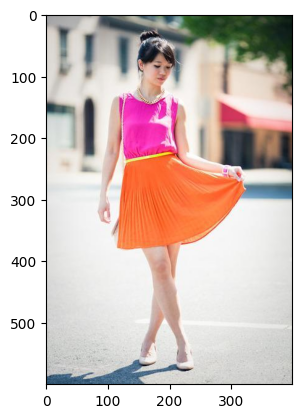

In [2]:

annotations_path = "Annotations"
list_of_xml_files = glob.glob(os.path.join(annotations_path, "*.xml"))


annotations_txt_path = "Annotations_txt"
list_of_txt_files = glob.glob(os.path.join(annotations_txt_path, "*.txt"))


image_sets_path = "ImageSets/Main"
jpeg_images_path = "JPEGImages"
list_of_jpeg_images_path = glob.glob(os.path.join(jpeg_images_path, "*.jpg"))
print(list_of_jpeg_images_path)

# path to trainval and test files
trainval_files = os.path.join(image_sets_path, "trainval.txt")
test_files= os.path.join(image_sets_path, "test.txt")


# read the trainval file
with open(trainval_files, 'r') as f:
    trainval_images = f.readlines()
trainval_images = [line.strip() for line in trainval_images]

# read the test file
with open(test_files, 'r') as f:
    test_images = f.readlines()
test_images = [line.strip() for line in test_images]

print(f"trainval images list :{trainval_images}")
print(f"test images list:{test_images}")

#visualize images

trainval_images_path = [os.path.join(jpeg_images_path, f"{img_id}.jpg") for img_id in trainval_images]
test_images_path = [os.path.join(jpeg_images_path, f'{img_id}.jpg') for img_id in test_images]
image = Image.open(trainval_images_path[0]).convert('RGB')
plt.imshow(image)
plt.show()





#### visualize more images

['JPEGImages/76241.jpg', 'JPEGImages/183178.jpg', 'JPEGImages/183410.jpg', 'JPEGImages/116453.jpg', 'JPEGImages/183103.jpg', 'JPEGImages/120690.jpg']


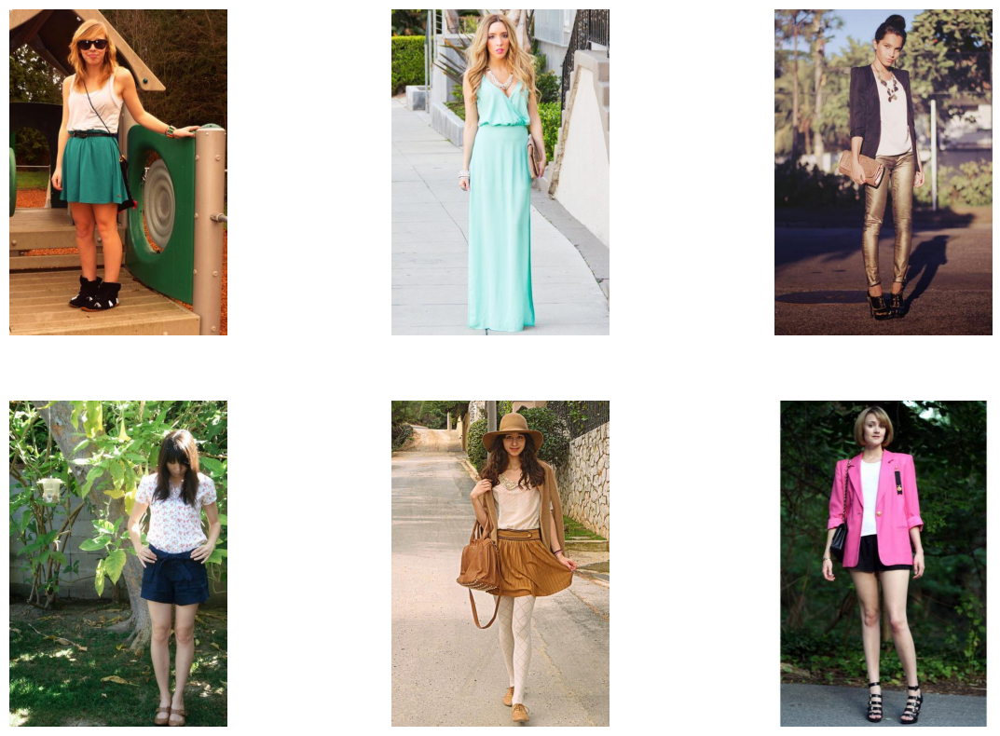

In [3]:
import PIL
import os

annotations_path = "Annotations"
list_of_xml_files = glob.glob(os.path.join(annotations_path, "*.xml"))


annotations_txt_path = "Annotations_txt"
list_of_txt_files = glob.glob(os.path.join(annotations_txt_path, "*.txt"))


image_sets_path = "ImageSets/Main"
jpeg_images_path = "JPEGImages"
list_of_jpeg_images_path = glob.glob(os.path.join(jpeg_images_path, "*.jpg"))


def visualize_images(list_of_jpeg_images_path):
    random_sample_images_path = random.sample(list_of_jpeg_images_path, 6)
    print(random_sample_images_path)
    fig, axes = plt.subplots(2, 3, figsize = (15, 10))
    axes = axes.ravel()
    for i in range(len(random_sample_images_path)):   
        image = Image.open(random_sample_images_path[i]).convert('RGB')
        axes[i].imshow(image)
        axes[i].axis('off')
    plt.show()
visualize_images(list_of_jpeg_images_path)
    
    

- the txt format of annotations are in yolo format. which are in this format:

- class_id  x_center  y_center  width  height

- class_id the class of object

- x_center, y_center :the center of the bounding boxes normalized to the width and height of the image 

- width, height: the width and height of the image normalized to the width and height


- for this image we want to get bounding boxes for each clothing item and then crop image based on the bboxes in ground truth

- we define a function to parse txt file to extract bounding box coordinates from wach ground truth along with the class id.

-The typical YOLO .txt format has the following structure:


- Class_id center_x center_y width height
- Each line in the .txt file represents one bounding box.

- The values center_x, center_y, width, and height are normalized (between 0 and 1) relative to the image dimensions.
- we aim converting these format to pixel coordinates format like : x_min, y_min, x_max, y_max only for visualization  (overlay) of bounding box on the object. but when using YOLO for both fine tuning and inference we need the original txt format.


-we will need to load the image using a library like PIL or OpenCV.
- Reading the Bounding Boxes:

- we Parse the .txt file to extract the bounding box coordinates.
- Converting Coordinates:

then Convert the normalized coordinates into pixel coordinates.


Cropping the Image:

We Use the bounding box coordinates to crop the regions from the image.



['3 0.426250 0.308333 0.257500 0.186667\n', '9 0.501250 0.930000 0.222500 0.060000\n', '6 0.547500 0.508333 0.520000 0.253333']
['3', '0.426250', '0.308333', '0.257500', '0.186667']
['9', '0.501250', '0.930000', '0.222500', '0.060000']
['6', '0.547500', '0.508333', '0.520000', '0.253333']
[(3, 119, 128, 222, 240), (9, 155, 540, 244, 576), (6, 114, 228, 323, 380)]


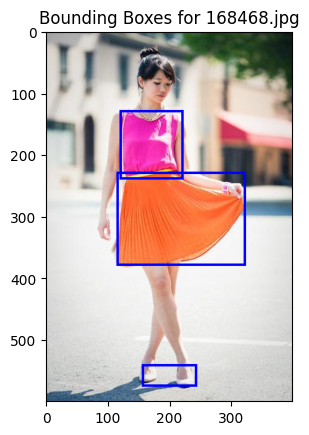

In [2]:
import os
from PIL import Image, ImageDraw
import glob
import matplotlib.pyplot as plt

# Define paths
annotations_txt_path = "Annotations_txt"
jpeg_images_path = "JPEGImages"

# Get lists of annotation files and images
list_of_txt_files = glob.glob(os.path.join(annotations_txt_path, "*.txt"))
list_of_jpeg_images_path = glob.glob(os.path.join(jpeg_images_path, "*.jpg"))

# Read the trainval file
image_sets_path = "ImageSets/Main"
trainval_files = os.path.join(image_sets_path, "trainval.txt")

with open(trainval_files, 'r') as f:
    trainval_images = f.readlines()
trainval_images = [line.strip() for line in trainval_images]

# Construct full paths to the images
trainval_images_path = [os.path.join(jpeg_images_path, f"{img_id}.jpg") for img_id in trainval_images]

# Function to read bounding boxes from a YOLO format text file
def read_bounding_box(txt_file):
    
    with open(txt_file, 'r') as f:
        lines = f.readlines()         # returns a list---> ['Line 1\n', 'Line 2\n', 'Line 3\n']
        print(lines)
    boxes = []
    for line in lines:
        parts = line.strip().split()  # ---> ['Line1', 'Line2', 'Line3']
        print(parts)
        class_id = int(parts[0])
        center_x = float(parts[1])
        center_y = float(parts[2])
        width = float(parts[3])
        height = float(parts[4])
        boxes.append([class_id, center_x, center_y, width, height])
        
    return boxes

# Function to convert YOLO bounding box coordinates to pixel coordinates
def convert_yolo_to_pixel(box, img_width, img_height):
    class_id, center_x, center_y, width, height = box
    x_min = int((center_x - width / 2) * img_width)
    y_min = int((center_y - height / 2) * img_height)
    x_max = int((center_x + width / 2) * img_width)
    y_max = int((center_y + height / 2) * img_height)
    return (class_id, x_min, y_min, x_max, y_max)

# Function to draw bounding boxes on an image
def draw_bounding_boxes(image_path, annotation_path):
    # Open the image and get its dimensions
    image = Image.open(image_path).convert('RGB')
    img_width, img_height = image.size

    # Read bounding boxes from the annotation file
    boxes = read_bounding_box(annotation_path)
    pixel_boxes = [convert_yolo_to_pixel(box, img_width, img_height) for box in boxes]
    print(pixel_boxes)
    
    # Draw bounding boxes on the image
    draw = ImageDraw.Draw(image)
    for pixel_box in pixel_boxes:
        class_id, x_min, y_min, x_max, y_max = pixel_box
        draw.rectangle([x_min, y_min, x_max, y_max], outline="blue", width=4)
    
    # Display the image with the bounding boxes
    plt.imshow(image)
    plt.title(f"Bounding Boxes for {os.path.basename(image_path)}")
    plt.show()

# Example usage:
if trainval_images_path and list_of_txt_files:  # Ensure lists are not empty
    # Assuming the first image and first annotation file correspond
    image_file = trainval_images_path[0]
    annotation_file = os.path.join(annotations_txt_path, f"{trainval_images[0]}.txt")

    # Draw bounding boxes on the selected image
    draw_bounding_boxes(image_file, annotation_file)
else:
    print("No trainval images or annotation files found. Please check the directory paths.")


### Preparing dataset for custom training and inference  with YOLOV8

- when using yolo we need to have a particular format which is different with the current format of dataset: the dataset should have a format like this:


colorful_fashion_dataset

    JPEGImages

        train
            img1.jpg
            img1.txt
            img2.jpg
            img2.txt
            ...
        
        val
            img3.jpg
            img3.txt
            ...


        test
            img4.jpg
            img4.txt
            ...

we can define a functionto organize images and their corresponding YOLO annotations into train, val, and test directories under JPEGImages.

In [2]:
import os
import shutil
import glob
import random
from PIL import Image
import matplotlib.pyplot as plt

# Define paths based on our directory structure
annotations_path = "Annotations"
annotations_txt_path = "Annotations_txt"
image_sets_path = "ImageSets/Main"
jpeg_images_path = "JPEGImages"

# List XML, TXT, and JPEG files
list_of_xml_files = glob.glob(os.path.join(annotations_path, "*.xml"))
list_of_txt_files = glob.glob(os.path.join(annotations_txt_path, "*.txt"))
list_of_jpeg_images_path = glob.glob(os.path.join(jpeg_images_path, "*.jpg"))

# Paths to trainval.txt and test.txt
trainval_files = os.path.join(image_sets_path, "trainval.txt")
test_files = os.path.join(image_sets_path, "test.txt")

# Read the trainval and test files
with open(trainval_files, 'r') as f:
    trainval_images = f.readlines()
trainval_images = [line.strip() for line in trainval_images]
# print(len(trainval_images))

with open(test_files, 'r') as f:
    test_images = f.readlines()
test_images = [line.strip() for line in test_images]
print(len(test_images))

# Convert image IDs to full paths
trainval_images_path = [os.path.join(jpeg_images_path, f"{img_id}.jpg") for img_id in trainval_images]
test_images_path = [os.path.join(jpeg_images_path, f'{img_id}.jpg') for img_id in test_images]

# Now we want to split trainval images into two separate folders: train and val with 80/20 split.
random.shuffle(trainval_images)
split_idx = int(0.8 * len(trainval_images))

train_images = trainval_images[0:split_idx]
print(len(train_images))

val_images = trainval_images[split_idx:]
print(len(val_images))

def organize_file_to_yolo_format(image_list, subset):
    # Create subdirectory for images and annotations within the subset directory
    sub_dir = os.path.join(jpeg_images_path, subset)
    os.makedirs(sub_dir, exist_ok=True)
    
    for image_id in image_list:
        image_file = f"{image_id}.jpg"
        annot_file = f"{image_id}.txt"
        
        src_image = os.path.join(jpeg_images_path, image_file)
        dst_image = os.path.join(sub_dir, image_file)
        
        src_annotation = os.path.join(annotations_txt_path, annot_file)
        dst_annotation = os.path.join(sub_dir, annot_file)  # Place annotation file in the same directory
        
        if os.path.exists(src_image) and os.path.exists(src_annotation):
            shutil.copy(src_image, dst_image)
            shutil.copy(src_annotation, dst_annotation)

# Organize files for train, val, and test sets
organize_file_to_yolo_format(train_images, 'train')
organize_file_to_yolo_format(val_images, 'val')
organize_file_to_yolo_format(test_images, 'test')

print("Dataset organized successfully!")

537
1716
429
Dataset organized successfully!


- when using YOLOV8, a YAML file typically contains configuration information for the dataset, model parameters, and training settings. Here's a common structure for a YOLO dataset configuration YAML file

In [2]:
import torch
import ultralytics
import os

print(f"Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

print(os.path.exists('obj_detect.yaml'))

Using torch 2.4.0+cu121 (NVIDIA GeForce GTX 1080 Ti)
cuda
True


In [4]:
import os
import torch
#Define paths based on our directory structure

annotations_path = "Annotations"
annotations_txt_path = "Annotations_txt"
image_sets_path = "ImageSets/Main"
jpeg_images_path = "JPEGImages"
train_image_path = os.path.join(jpeg_images_path, "train")
val_image_path = os.path.join(jpeg_images_path, "val")
test_image_path = os.path.join(jpeg_images_path, "test")

yaml_path = 'obj_detect.yaml'
if os.path.exists(yaml_path):
    print("YAML file exists!")
else:
    print("YAML file does not exist!")
print(yaml_path)


YAML file exists!
obj_detect.yaml


when using frameworks like YOLO we need some directories and subdirectories for organizing the results

1- runs/detect:

This directory structure is used to organize and store the results of different training runs. Each time we train a model, we might want to save the model's weights, logs, evaluation metrics, and sample predictions for later analysis or comparison with other runs

2- train:

This subdirectory specifically stores the results related to a training run. Each training session might generate new data, and keeping this organized helps in managing different experiments

3- weights:

Within the train directory, the weights subdirectory stores the model's weights after training. These weights are essential if you want to later load the model for inference or further training

In [2]:
import os
import torch

from ultralytics import YOLO
device = 'cuda' if torch.cuda.is_available() else 'cpu'


base_path = './'
#define  path for runs and detect
runs_path = os.path.join(base_path, 'runs', 'detect')
weights_save_path = os.path.join(runs_path, 'train', 'weights')
# Ensure the runs/detect directory exists
os.makedirs(runs_path, exist_ok = True)
# Ensure the weights save directory exists




# Define the path to your dataset and model
model_path = 'yolov8l.pt'



yaml_path =  os.path.join(base_path, "obj_detect.yaml")

model = YOLO("yolov8l.pt")
model.train(data= yaml_path, epochs=30, imgsz=640, device = device, project = runs_path, save_period = -1, save = True)


Ultralytics YOLOv8.2.78 🚀 Python-3.10.12 torch-2.4.0+cu121 CUDA:0 (NVIDIA GeForce GTX 1080 Ti, 11162MiB)
engine/trainer: task=detect, mode=train, model=yolov8l.pt, data=./obj_detect.yaml, epochs=30, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=./runs/detect, name=train5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, sh

/home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/myenv/lib/python3.10/site-packages/ultralytics/engine/trainer.py:271: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(enabled=self.amp)
train: Scanning /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/train.cache... 1716 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1716/1716 [00:00<?, ?it/s]
val: Scanning /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/val.cache... 429 images, 0 backgrounds, 0 corrupt: 100%|██████████| 429/429 [00:00<?, ?it/s]


Plotting labels to runs/detect/train5/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 97 weight(decay=0.0), 104 weight(decay=0.0005), 103 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train5
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30      10.4G      1.315      1.827      1.488         33        640: 100%|██████████| 108/108 [05:30<00:00,  3.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:21<00:00,  1.52s/it]

                   all        429       1665      0.574      0.537      0.547      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30      10.7G      1.309      1.368      1.485         37        640: 100%|██████████| 108/108 [06:39<00:00,  3.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:23<00:00,  1.67s/it]

                   all        429       1665      0.562      0.578      0.582       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30      10.8G      1.332      1.324      1.519         37        640: 100%|██████████| 108/108 [07:03<00:00,  3.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:22<00:00,  1.64s/it]

                   all        429       1665      0.635       0.56      0.588      0.339



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30      10.9G      1.334      1.263      1.531         33        640: 100%|██████████| 108/108 [07:10<00:00,  3.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:23<00:00,  1.66s/it]

                   all        429       1665       0.57       0.65      0.641      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30      10.9G      1.286        1.2      1.493         23        640: 100%|██████████| 108/108 [07:15<00:00,  4.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:24<00:00,  1.73s/it]

                   all        429       1665      0.624      0.655      0.657      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30      10.9G      1.273      1.165      1.485         33        640: 100%|██████████| 108/108 [07:12<00:00,  4.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:23<00:00,  1.66s/it]

                   all        429       1665      0.636      0.686      0.687      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30      10.9G      1.218      1.101      1.446         32        640: 100%|██████████| 108/108 [07:05<00:00,  3.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:23<00:00,  1.67s/it]

                   all        429       1665      0.743      0.672      0.711      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30      10.6G      1.211      1.051      1.436         54        640: 100%|██████████| 108/108 [06:55<00:00,  3.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:21<00:00,  1.57s/it]

                   all        429       1665      0.742      0.688      0.721      0.463



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30      10.6G      1.189      1.028      1.431         27        640: 100%|██████████| 108/108 [06:52<00:00,  3.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:21<00:00,  1.57s/it]

                   all        429       1665      0.652      0.728      0.728      0.463



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30      10.9G       1.17     0.9824      1.417         39        640: 100%|██████████| 108/108 [06:57<00:00,  3.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:23<00:00,  1.66s/it]

                   all        429       1665      0.724       0.72      0.752      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30      10.7G      1.154     0.9501      1.399         29        640: 100%|██████████| 108/108 [07:01<00:00,  3.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:24<00:00,  1.73s/it]

                   all        429       1665       0.72      0.743       0.75       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30      10.3G      1.116     0.9032      1.374         29        640: 100%|██████████| 108/108 [07:12<00:00,  4.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:24<00:00,  1.73s/it]

                   all        429       1665      0.682      0.748      0.748      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30      10.9G      1.106     0.8762       1.37         39        640: 100%|██████████| 108/108 [07:17<00:00,  4.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:24<00:00,  1.78s/it]

                   all        429       1665      0.701       0.77      0.767      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30      10.3G      1.084     0.8605       1.36         35        640: 100%|██████████| 108/108 [07:25<00:00,  4.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:24<00:00,  1.75s/it]

                   all        429       1665      0.737      0.721      0.762      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30      10.9G      1.067     0.8227      1.342         18        640: 100%|██████████| 108/108 [07:27<00:00,  4.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:25<00:00,  1.79s/it]

                   all        429       1665      0.696      0.763       0.77      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30      10.2G      1.055      0.808      1.338         18        640: 100%|██████████| 108/108 [07:28<00:00,  4.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:24<00:00,  1.76s/it]

                   all        429       1665      0.734      0.729      0.762      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30      10.3G      1.043     0.7888       1.32         26        640: 100%|██████████| 108/108 [07:28<00:00,  4.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:23<00:00,  1.70s/it]

                   all        429       1665      0.711      0.775      0.774       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30      10.3G      1.022     0.7442      1.299         23        640: 100%|██████████| 108/108 [07:29<00:00,  4.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:24<00:00,  1.75s/it]

                   all        429       1665      0.767      0.711       0.77      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30      10.6G      1.005     0.7335      1.298         26        640: 100%|██████████| 108/108 [07:32<00:00,  4.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:24<00:00,  1.78s/it]

                   all        429       1665      0.707      0.767      0.772      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30      10.6G     0.9841     0.7209       1.29         21        640: 100%|██████████| 108/108 [07:35<00:00,  4.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:24<00:00,  1.77s/it]

                   all        429       1665      0.754      0.761      0.785      0.532


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30      10.7G     0.9542     0.6504      1.307         13        640: 100%|██████████| 108/108 [07:36<00:00,  4.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:26<00:00,  1.89s/it]

                   all        429       1665      0.752      0.762      0.783      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30      10.9G      0.922     0.6185      1.286         15        640: 100%|██████████| 108/108 [07:37<00:00,  4.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:24<00:00,  1.73s/it]

                   all        429       1665      0.724       0.75       0.77       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30      10.3G     0.9011     0.5914      1.273         14        640: 100%|██████████| 108/108 [07:41<00:00,  4.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:24<00:00,  1.77s/it]

                   all        429       1665      0.752      0.754      0.787      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30      10.3G     0.8836     0.5748      1.265         15        640: 100%|██████████| 108/108 [07:39<00:00,  4.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:25<00:00,  1.79s/it]

                   all        429       1665      0.745       0.76      0.783      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30      10.7G     0.8701     0.5521      1.241         14        640: 100%|██████████| 108/108 [07:38<00:00,  4.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:24<00:00,  1.77s/it]

                   all        429       1665      0.755      0.769      0.785      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30      10.7G     0.8539     0.5255      1.235         17        640: 100%|██████████| 108/108 [07:31<00:00,  4.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:24<00:00,  1.73s/it]

                   all        429       1665      0.739      0.773      0.787      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30      10.4G     0.8251     0.5025       1.22         16        640: 100%|██████████| 108/108 [07:45<00:00,  4.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:26<00:00,  1.86s/it]

                   all        429       1665       0.81      0.726      0.784      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30      10.3G     0.8041      0.477      1.191         14        640: 100%|██████████| 108/108 [07:42<00:00,  4.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:25<00:00,  1.83s/it]

                   all        429       1665      0.729      0.764      0.783      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30      10.3G     0.7949     0.4648      1.194         15        640: 100%|██████████| 108/108 [07:25<00:00,  4.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:24<00:00,  1.75s/it]

                   all        429       1665      0.758      0.754      0.784      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30      10.9G     0.7705     0.4433      1.169         14        640: 100%|██████████| 108/108 [07:42<00:00,  4.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:25<00:00,  1.81s/it]

                   all        429       1665      0.768      0.755      0.784      0.547



30 epochs completed in 3.872 hours.
Optimizer stripped from runs/detect/train5/weights/last.pt, 87.6MB
Optimizer stripped from runs/detect/train5/weights/best.pt, 87.6MB

Validating runs/detect/train5/weights/best.pt...
Ultralytics YOLOv8.2.78 🚀 Python-3.10.12 torch-2.4.0+cu121 CUDA:0 (NVIDIA GeForce GTX 1080 Ti, 11162MiB)
Model summary (fused): 268 layers, 43,614,318 parameters, 0 gradients, 164.9 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:25<00:00,  1.79s/it]


                   all        429       1665      0.758      0.754      0.784      0.548
              sunglass         69         69      0.449      0.217      0.354      0.128
                   hat         52         52      0.675      0.692      0.736      0.412
                jacket        158        162       0.76      0.883      0.843      0.674
                 shirt        290        299      0.814      0.807      0.859      0.599
                 pants        102        102       0.92      0.912      0.925      0.753
                shorts         74         74      0.825      0.765      0.781      0.524
                 skirt        148        148      0.811      0.899      0.894      0.691
                 dress        107        107      0.775      0.879      0.872      0.741
                   bag        235        235      0.755      0.706      0.773      0.474
                  shoe        417        417      0.797      0.779      0.803      0.478
Speed: 0.2ms preproce

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x784ffe6b9ed0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.0

### evaluate the model

In [3]:
import os

from ultralytics import YOLO
device = 'cuda' if torch.cuda.is_available() else 'cpu'


# Define paths
base_path = './'
#define  path for runs and detect
runs_path = os.path.join(base_path, 'runs', 'detect')
weights_save_path = os.path.join(runs_path, 'train5', 'weights')
yaml_path =  os.path.join(base_path, "obj_detect.yaml")

# Load the best model from training
best_weights_path = os.path.join(weights_save_path, 'best.pt')
# Define the path to your dataset and model
model_path = 'yolov8l.pt'

model = YOLO(best_weights_path)

# Evaluate the model on the test set
results = model.val(data=yaml_path, split="test", imgsz=640, device="cuda")

# Print mAP@0.5 and other metrics
print(results.results_dict)

print(f"mAP@0.5: {results.results_dict['metrics/mAP50(B)']:.4f}")
print(f"mAP@0.5-0.95: {results.results_dict['metrics/mAP50-95(B)']:.4f}")

print(f"Precision: {results.results_dict['metrics/precision(B)']:.4f}")
print(f"Recall: {results.results_dict['metrics/recall(B)']:.4f}")



Ultralytics YOLOv8.2.78 🚀 Python-3.10.12 torch-2.4.0+cu121 CUDA:0 (NVIDIA GeForce GTX 1080 Ti, 11162MiB)
Model summary (fused): 268 layers, 43,614,318 parameters, 0 gradients, 164.9 GFLOPs


val: Scanning /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/test... 537 images, 0 backgrounds, 0 corrupt: 100%|██████████| 537/537 [00:00<00:00, 1749.74it/s]

val: New cache created: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/test.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 34/34 [00:19<00:00,  1.79it/s]


                   all        537       2035      0.759      0.745      0.773      0.539
              sunglass         82         82      0.513       0.22      0.308      0.114
                   hat         77         77      0.769      0.753      0.819      0.498
                jacket        179        181      0.767      0.807      0.849      0.671
                 shirt        361        366      0.799      0.809      0.835      0.614
                 pants        114        114      0.932      0.912      0.963      0.789
                shorts        107        107      0.813      0.813      0.804      0.551
                 skirt        186        186      0.756       0.79      0.791      0.634
                 dress        128        128      0.702      0.852      0.781      0.641
                   bag        274        274      0.733        0.7      0.758      0.416
                  shoe        520        520      0.807      0.795      0.825       0.46
Speed: 0.2ms preproce

### Use Inference on the dataset to Visualize the detected clothing items for one sample from images


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/test/10226.jpg: 640x448 1 sunglass, 3 jackets, 1 shirt, 1 pants, 3 bags, 1 shoe, 18.5ms
Speed: 1.4ms preprocess, 18.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 448)
ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'sunglass', 1: 'hat', 2: 'jacket', 3: 'shirt', 4: 'pants', 5: 'shorts', 6: 'skirt', 7: 'dress', 8: 'bag', 9: 'shoe'}
obb: None
orig_img: array([[[ 30,  94,  72],
        [ 31,  95,  73],
        [ 35, 100,  78],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[ 35,  99,  77],
        [ 34,  98,  76],
        [ 38, 103,  81],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[ 34,  99,  77],
        [ 34,  99,  77],
        [ 38, 103,  81],
        ...,
  

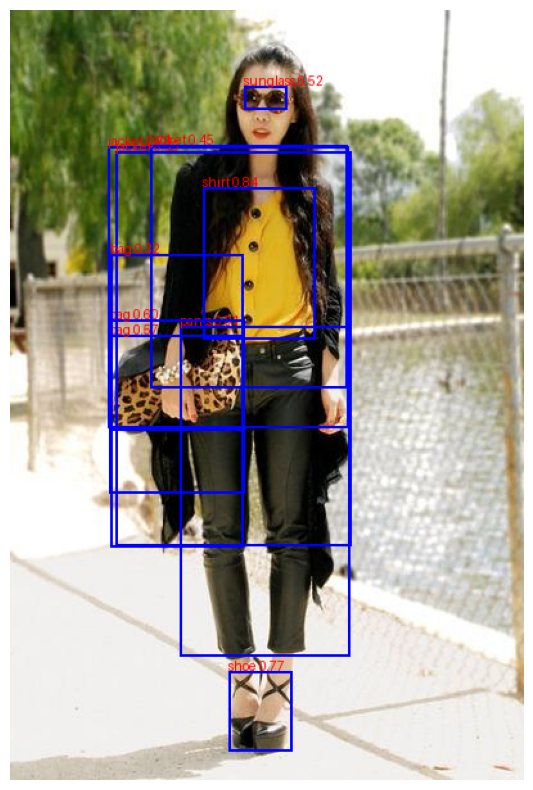

In [6]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
from PIL import Image, ImageDraw, ImageFont

from ultralytics import YOLO



# test the model on test set
base_path = "./"
annotations_path = "Annotations"
annotations_txt_path = "Annotations_txt"
image_sets_path = "ImageSets/Main"
jpeg_images_path = "JPEGImages"

train_image_path = os.path.join(jpeg_images_path, "train")
val_image_path = os.path.join(jpeg_images_path, "val")
test_image_path = os.path.join(jpeg_images_path, "test")



train_file = os.path.join(image_sets_path, "trainval.txt")
test_file = os.path.join(image_sets_path, "test.txt")



#Load sample image
sample_image_path = os.path.join(test_image_path, "10226.jpg")
image = Image.open(sample_image_path).convert('RGB')
draw = ImageDraw.Draw(image)
font = ImageFont.load_default()


# Load the trained model
runs_path = os.path.join(base_path, 'runs', 'detect')
weights_save_path = os.path.join(runs_path, 'train','weights')
best_weights_path = os.path.join(weights_save_path, "best.pt")



# Load model and perform inference
model = YOLO(best_weights_path)
results = model(sample_image_path)
print(results[0])

for result in results:
  boxes = result.boxes

  for box in boxes:

    x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get bounding box coordinates
    confidence = box.conf[0].item()         # Get confidence score
    class_id = int(box.cls[0])              # Get class id
    label = model.names[class_id]           # Get label for class id

    # Draw bounding box on the image
    draw.rectangle([x1, y1, x2, y2], outline="blue", width=2)
    # Put label and confidence score on the image
    draw.text((x1, y1 - 10), f"{label} {confidence:.2f}", fill="red", font=font)

#Display the image with bounding boxes
plt.figure(figsize=(10, 10))
plt.imshow(image)
plt.axis('off')
plt.show()



As we can see the number of bounding boxes for the same item but different probabilities are too much.for this we need to use a logic to return only the highest probabilities between bounding box coordinates for the same item.


###  handle the cases where the model detects mutiple bounding boxes for the same item. the idea is to keep the bounding box with higher confidence score for each detectec item.


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/test/10226.jpg: 640x448 1 sunglass, 3 jackets, 1 shirt, 1 pants, 3 bags, 1 shoe, 19.9ms
Speed: 1.5ms preprocess, 19.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 448)


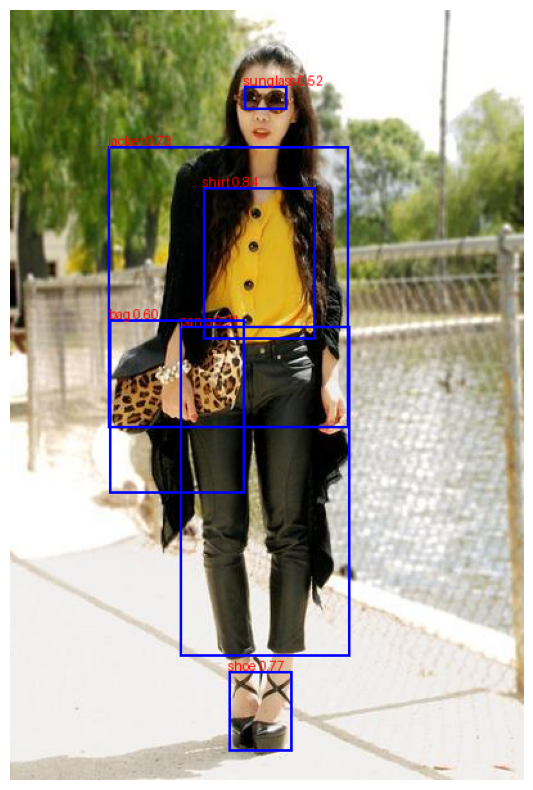

In [7]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
from PIL import Image, ImageDraw, ImageFont

from ultralytics import YOLO



# test the model on test set
base_path = "./"
annotations_path = "Annotations"
annotations_txt_path = "Annotations_txt"
image_sets_path = "ImageSets/Main"
jpeg_images_path = "JPEGImages"

train_image_path = os.path.join(jpeg_images_path, "train")
val_image_path = os.path.join(jpeg_images_path, "val")
test_image_path = os.path.join(jpeg_images_path, "test")



train_file = os.path.join(image_sets_path, "trainval.txt")
test_file = os.path.join(image_sets_path, "test.txt")



#Load sample image
sample_image_path = os.path.join(test_image_path, "10226.jpg")
image = Image.open(sample_image_path).convert('RGB')
draw = ImageDraw.Draw(image)
font = ImageFont.load_default()


# Load the trained model
runs_path = os.path.join(base_path, 'runs', 'detect')
weights_save_path = os.path.join(runs_path, 'train','weights')
best_weights_path = os.path.join(weights_save_path, "best.pt")

# Load model and perform inference
model = YOLO(best_weights_path)
results = model(sample_image_path)
best_boxes = {}

for result in results:
    boxes = result.boxes # extract the boxes object from the result
    for box in boxes:   # loops through each detected box in boxes
        x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get bounding box coordinates
        confidence = box.conf[0].item()  # Get confidence score
        class_id = int(box.cls[0])  # Get class id
        label = model.names[class_id]  # Get label for class id

        # Check if this label is already in best_boxes
        if label in best_boxes:
            # If the new confidence is higher, replace the old one
            if confidence > best_boxes[label]['confidence']:
                best_boxes[label] = {
                    'coordinates': (x1, y1, x2, y2),
                    'confidence': confidence
                }
        else:
            # If this is the first time we're seeing this label, add it to best_boxes
            best_boxes[label] = {
                'coordinates': (x1, y1, x2, y2),
                'confidence': confidence
            }

# Draw the best bounding boxes on the image
for label, box_data in best_boxes.items():
    x1, y1, x2, y2 = box_data['coordinates']
    confidence = box_data['confidence']
    draw.rectangle([x1, y1, x2, y2], outline="blue", width=2)
    draw.text((x1, y1 - 10), f"{label} {confidence:.2f}", fill="red", font=font)

# Display the image with bounding boxes
plt.figure(figsize=(10, 10))
plt.imshow(image)
plt.axis('off')
plt.show()


download the model SAM and store the checkpoint from it in model directory with terminal or we can use the codes below in jupyter notebook.

!wget -q 'https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth' -P /content/drive/MyDrive/object_detection/object_detection_yolov8/
!pip install -q git+https://github.com/facebookresearch/segment-anything.git  # install segment anything library from github
from segment_anything import sam_model_registry, SamPredictor   # import sam_model_registry and SamPredictor from segment_anything library
!pip install segmentation_models_pytorch

In [13]:
torch.cuda.empty_cache()



image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/train/98409.jpg: 640x448 1 shirt, 1 skirt, 1 bag, 1 shoe, 33.8ms
Speed: 1.6ms preprocess, 33.8ms inference, 114.3ms postprocess per image at shape (1, 3, 640, 448)
Saved cropped image: ./cropped_images/shirt-0.90-0.jpg
Saved cropped image: ./cropped_images/bag-0.87-1.jpg
Saved cropped image: ./cropped_images/skirt-0.83-2.jpg
Saved cropped image: ./cropped_images/shoe-0.74-3.jpg
Cropping complete.


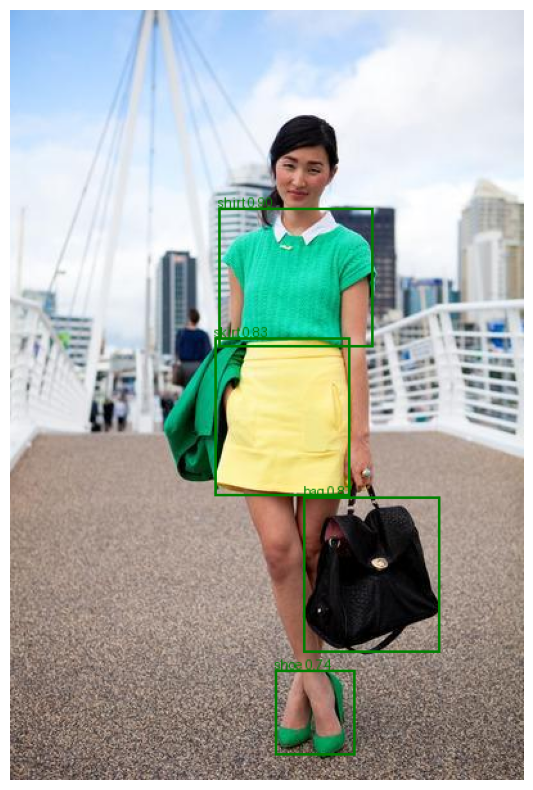

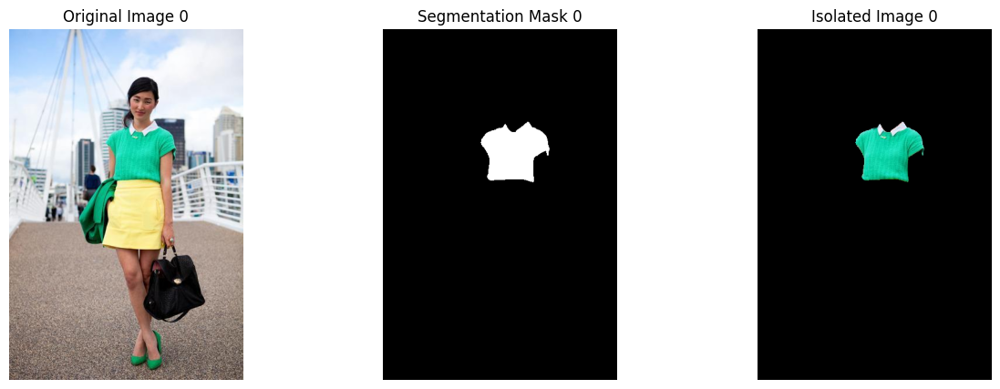

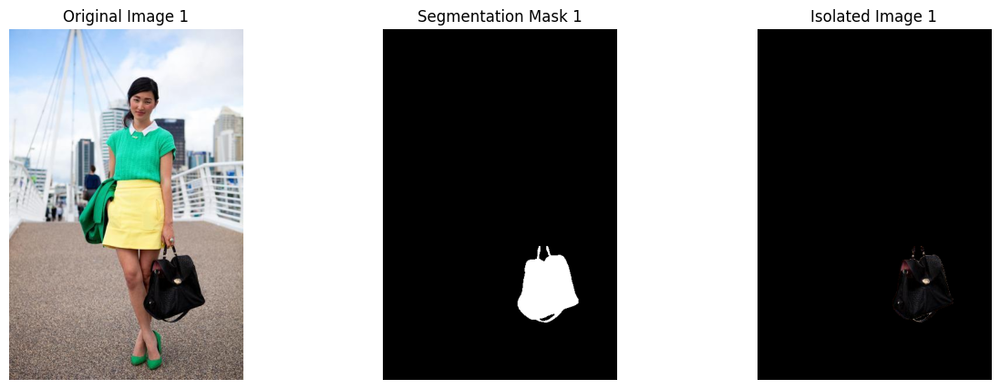

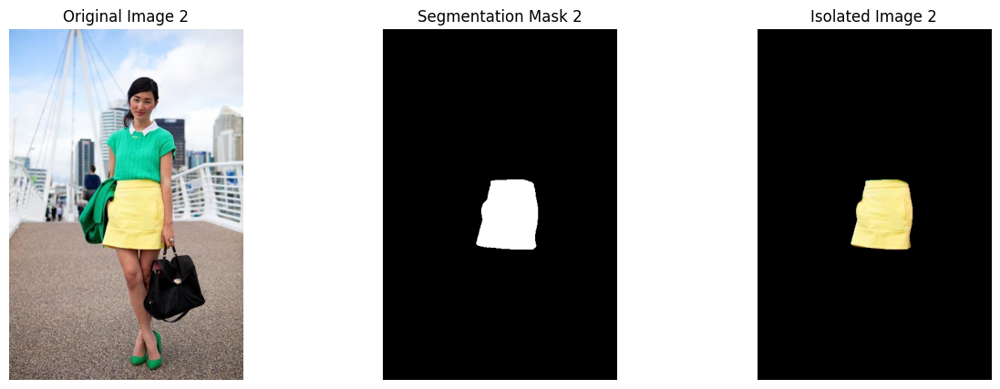

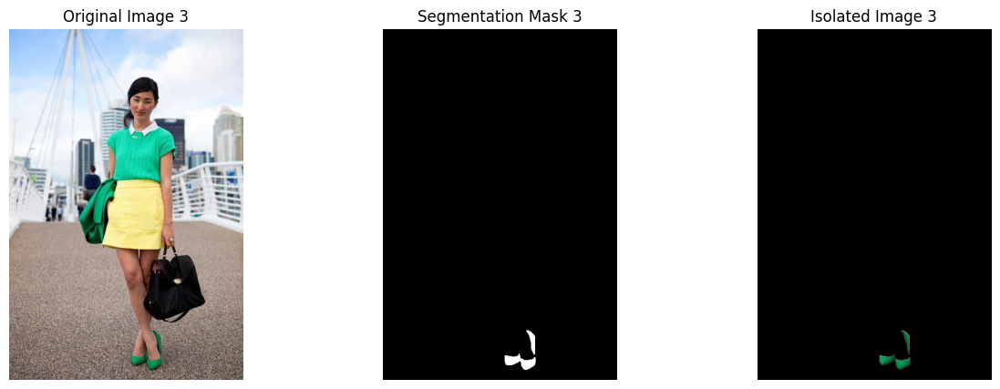

Segmentation complete.


In [1]:
from segment_anything import sam_model_registry, SamPredictor
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamPredictor
import torch
torch.cuda.empty_cache()


# we will define a function to remove duplicates bounding boxes and use SAM model for getting mask segmentation of clothing items




# Path to the SAM model checkpoint

base_path = "./"
annotations_path = "Annotations"
annotations_txt_path = "Annotations_txt"
image_sets_path = "ImageSets/Main"
jpeg_images_path = "JPEGImages"

train_image_path = os.path.join(jpeg_images_path, "train")
val_image_path = os.path.join(jpeg_images_path, "val")
test_image_path = os.path.join(jpeg_images_path, "test")




# Function to remove duplicates (keep the highest confidence for each label)
def remove_duplicates(items):
    unique_items = {}
    for item in items:
        label = item['label']
        if label in unique_items:
            if item['confidence'] > unique_items[label]['confidence']:
                unique_items[label] = item
        else:
            unique_items[label] = item
    return list(unique_items.values())




def detect_and_segment_objects(base_path, sample_image_path, yolo_weights_path, sam_model_path):

    # Define paths
    cropped_images_dir = os.path.join(base_path, "cropped_images")
    segmented_images_dir = os.path.join(base_path, "segmented_images")
    # Ensure directories exist
    os.makedirs(cropped_images_dir, exist_ok=True)
    os.makedirs(segmented_images_dir, exist_ok=True)


    
    

    # Load the SAM model
    sam = sam_model_registry["vit_h"](checkpoint=sam_model_path).to(device=torch.device('cuda:0'))
    mask_predictor = SamPredictor(sam)

    # Load the YOLO model
    model = YOLO(yolo_weights_path)

    # Load sample image
    image = Image.open(sample_image_path).convert('RGB')
    image_rgb = np.array(image)
    image_bgr = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2BGR)

    # Perform object detection with YOLO
    results = model(sample_image_path)

    detected_items = []
    crop_counter = 0
    for result in results:
        boxes = result.boxes
        for box in boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get bounding box coordinates
            confidence = box.conf[0].item()  # Get confidence score
            class_id = int(box.cls[0])  # Get class id
            label = model.names[class_id]  # Get label for class id

            detected_items.append({
                'label': label,
                'coordinates': (x1, y1, x2, y2),
                'confidence': confidence
            })

    # Remove duplicates (keep the highest confidence for each label)
    resolved_items = remove_duplicates(detected_items)

    # Draw bounding boxes and crop images
    predicted_boxes = []
    for item in resolved_items:
        x1, y1, x2, y2 = item['coordinates']
        confidence = item['confidence']
        label = item['label']

        # Draw bounding box on the image
        draw = ImageDraw.Draw(image)
        draw.rectangle([x1, y1, x2, y2], outline="green", width=2)
        draw.text((x1, y1 - 10), f"{label} {confidence:.2f}", fill="green", font=ImageFont.load_default())

        # Crop and save the image using bounding box coordinates
        cropped_filename = os.path.join(cropped_images_dir, f"{label}-{confidence:.2f}-{crop_counter}.jpg")
        cropped_image = image.crop((x1, y1, x2, y2))
        cropped_image.save(cropped_filename)
        predicted_boxes.append([x1, y1, x2, y2])
        crop_counter += 1

        print(f"Saved cropped image: {cropped_filename}")

    print("Cropping complete.")

    # Display the image with bounding boxes
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.axis('off')
    plt.show()

    # Transform the YOLOv8 predicted boxes to match input format expected by SAM model
    predicted_boxes_tensor = torch.tensor(predicted_boxes, dtype=torch.float32).to('cuda')
    transformed_boxes = mask_predictor.transform.apply_boxes_torch(predicted_boxes_tensor, image_bgr.shape[:2])

    # Set the image for SAM prediction
    mask_predictor.set_image(image_bgr)

    # Run SAM model on all the boxes
    masks, scores, logits = mask_predictor.predict_torch(
        boxes=transformed_boxes.to('cuda'),
        multimask_output=False,
        point_coords=None,
        point_labels=None
    )

    # Save and visualize each mask separately
    for i, mask in enumerate(masks):
        mask = mask[0].cpu().numpy().astype(np.uint8)  # Ensure mask is uint8 type

        # Save the mask
        mask_image = Image.fromarray(mask * 255)  # Convert mask to binary image
        mask_filename = os.path.join(segmented_images_dir, f"mask_{i}.png")
        mask_image.save(mask_filename)

        # Multiply the mask by the original image to isolate the object
        isolated_image = image_rgb * mask[:, :, np.newaxis]

        # Save the isolated image
        isolated_image_pil = Image.fromarray(isolated_image)
        isolated_filename = os.path.join(segmented_images_dir, f"isolated_{i}.png")
        isolated_image_pil.save(isolated_filename)

        # Visualize the mask and the isolated image
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(image_rgb)
        plt.title(f"Original Image {i}")
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(mask, cmap='gray')
        plt.title(f"Segmentation Mask {i}")
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(isolated_image)
        plt.title(f"Isolated Image {i}")
        plt.axis('off')

        plt.show()

    print("Segmentation complete.")





#Load sample image


# Load the trained model
runs_path = os.path.join(base_path, 'runs', 'detect')
weights_save_path = os.path.join(runs_path, 'train','weights')
yolo_best_weights_path = os.path.join(weights_save_path, "best.pt")
sam_model_path = os.path.join(base_path, "models","sam_vit_h_4b8939.pth")




sample_image_path = os.path.join(train_image_path, "98409.jpg")
detect_and_segment_objects(base_path, sample_image_path, yolo_best_weights_path, sam_model_path)


        





image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/train/16249.jpg: 640x448 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 15.9ms
Speed: 1.5ms preprocess, 15.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 448)
Saved cropped image: ./cropped_images/pants-0.89-0.jpg
Saved cropped image: ./cropped_images/bag-0.88-1.jpg
Saved cropped image: ./cropped_images/jacket-0.88-2.jpg
Saved cropped image: ./cropped_images/shoe-0.84-3.jpg
Saved cropped image: ./cropped_images/shirt-0.75-4.jpg
Cropping complete.


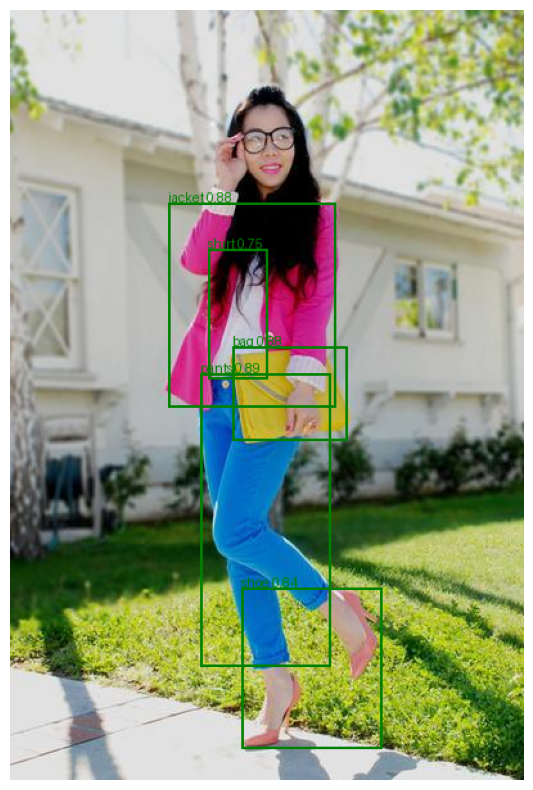

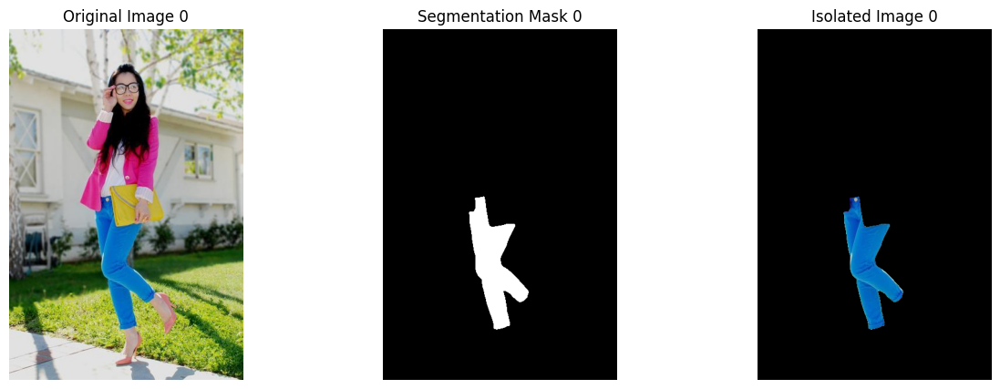

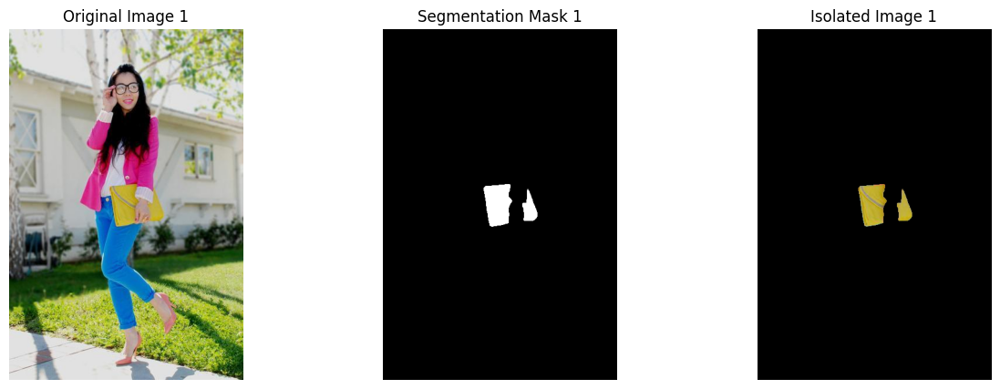

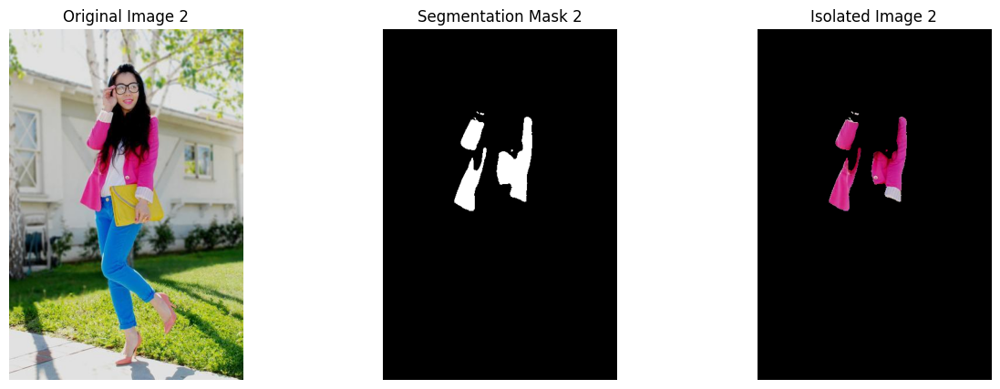

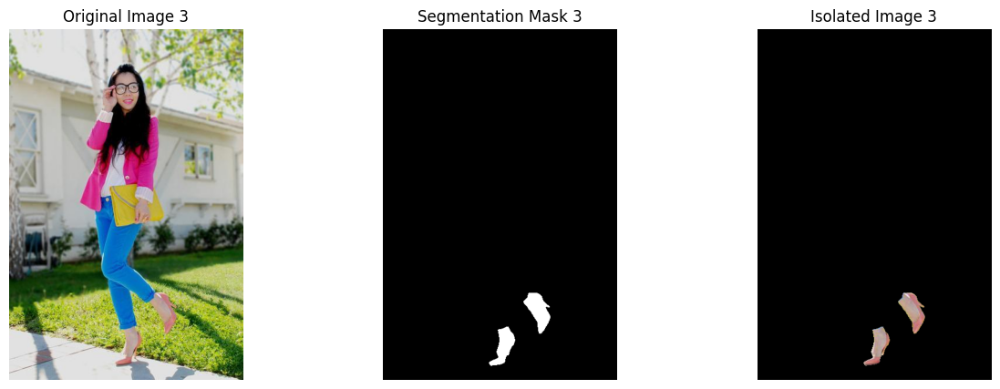

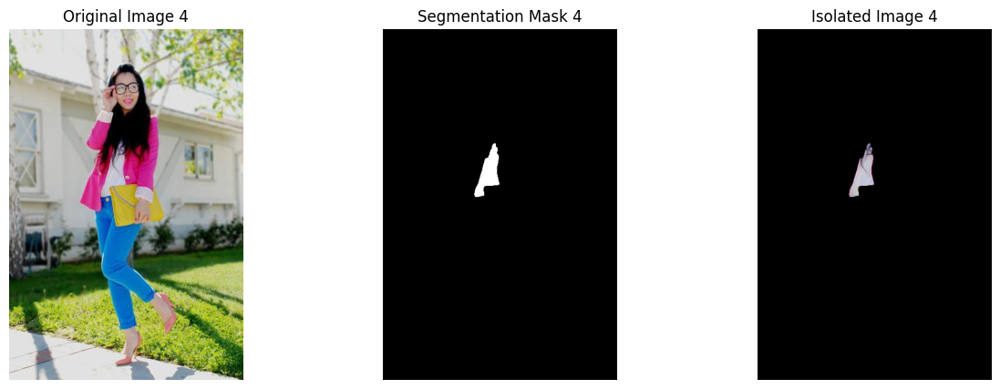

Segmentation complete.


In [3]:
from segment_anything import sam_model_registry, SamPredictor
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
import torch
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamPredictor


# we will define a function to remove duplicates bounding boxes and use SAM model for getting mask segmentation of clothing items




# Path to the SAM model checkpoint

base_path = "./"
annotations_path = "Annotations"
annotations_txt_path = "Annotations_txt"
image_sets_path = "ImageSets/Main"
jpeg_images_path = "JPEGImages"

train_image_path = os.path.join(jpeg_images_path, "train")
val_image_path = os.path.join(jpeg_images_path, "val")
test_image_path = os.path.join(jpeg_images_path, "test")




# Function to remove duplicates (keep the highest confidence for each label)
def remove_duplicates(items):
    unique_items = {}
    for item in items:
        label = item['label']
        if label in unique_items:
            if item['confidence'] > unique_items[label]['confidence']:
                unique_items[label] = item
        else:
            unique_items[label] = item
    return list(unique_items.values())




def detect_and_segment_objects(base_path, sample_image_path, yolo_weights_path, sam_model_path):

    # Define paths
    cropped_images_dir = os.path.join(base_path, "cropped_images")
    segmented_images_dir = os.path.join(base_path, "segmented_images")
    # Ensure directories exist
    os.makedirs(cropped_images_dir, exist_ok=True)
    os.makedirs(segmented_images_dir, exist_ok=True)


    
    

    # Load the SAM model
    sam = sam_model_registry["vit_h"](checkpoint=sam_model_path).to(device=torch.device('cuda:0'))
    mask_predictor = SamPredictor(sam)

    # Load the YOLO model
    model = YOLO(yolo_weights_path)

    # Load sample image
    image = Image.open(sample_image_path).convert('RGB')
    image_rgb = np.array(image)
    image_bgr = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2BGR)

    # Perform object detection with YOLO
    results = model(sample_image_path)

    detected_items = []
    crop_counter = 0
    for result in results:
        boxes = result.boxes
        for box in boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get bounding box coordinates
            confidence = box.conf[0].item()  # Get confidence score
            class_id = int(box.cls[0])  # Get class id
            label = model.names[class_id]  # Get label for class id

            detected_items.append({
                'label': label,
                'coordinates': (x1, y1, x2, y2),
                'confidence': confidence
            })

    # Remove duplicates (keep the highest confidence for each label)
    resolved_items = remove_duplicates(detected_items)

    # Draw bounding boxes and crop images
    predicted_boxes = []
    for item in resolved_items:
        x1, y1, x2, y2 = item['coordinates']
        confidence = item['confidence']
        label = item['label']

        # Draw bounding box on the image
        draw = ImageDraw.Draw(image)
        draw.rectangle([x1, y1, x2, y2], outline="green", width=2)
        draw.text((x1, y1 - 10), f"{label} {confidence:.2f}", fill="green", font=ImageFont.load_default())

        # Crop and save the image using bounding box coordinates
        cropped_filename = os.path.join(cropped_images_dir, f"{label}-{confidence:.2f}-{crop_counter}.jpg")
        cropped_image = image.crop((x1, y1, x2, y2))
        cropped_image.save(cropped_filename)
        predicted_boxes.append([x1, y1, x2, y2])
        crop_counter += 1

        print(f"Saved cropped image: {cropped_filename}")

    print("Cropping complete.")

    # Display the image with bounding boxes
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.axis('off')
    plt.show()

    # Transform the YOLOv8 predicted boxes to match input format expected by SAM model
    predicted_boxes_tensor = torch.tensor(predicted_boxes, dtype=torch.float32).to('cuda')
    transformed_boxes = mask_predictor.transform.apply_boxes_torch(predicted_boxes_tensor, image_bgr.shape[:2])

    # Set the image for SAM prediction
    mask_predictor.set_image(image_bgr)

    # Run SAM model on all the boxes
    masks, scores, logits = mask_predictor.predict_torch(
        boxes=transformed_boxes.to('cuda'),
        multimask_output=False,
        point_coords=None,
        point_labels=None
    )

    # Save and visualize each mask separately
    for i, mask in enumerate(masks):
        mask = mask[0].cpu().numpy().astype(np.uint8)  # Ensure mask is uint8 type

        # Save the mask
        mask_image = Image.fromarray(mask * 255)  # Convert mask to binary image
        mask_filename = os.path.join(segmented_images_dir, f"mask_{i}.png")
        mask_image.save(mask_filename)

        # Multiply the mask by the original image to isolate the object
        isolated_image = image_rgb * mask[:, :, np.newaxis]

        # Save the isolated image
        isolated_image_pil = Image.fromarray(isolated_image)
        isolated_filename = os.path.join(segmented_images_dir, f"isolated_{i}.png")
        isolated_image_pil.save(isolated_filename)

        # Visualize the mask and the isolated image
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(image_rgb)
        plt.title(f"Original Image {i}")
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(mask, cmap='gray')
        plt.title(f"Segmentation Mask {i}")
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(isolated_image)
        plt.title(f"Isolated Image {i}")
        plt.axis('off')

        plt.show()

    print("Segmentation complete.")






# Load the trained model
runs_path = os.path.join(base_path, 'runs', 'detect')
weights_save_path = os.path.join(runs_path, 'train','weights')
yolo_best_weights_path = os.path.join(weights_save_path, "best.pt")
sam_model_path = os.path.join(base_path, "models","sam_vit_h_4b8939.pth")


sample_image_path = os.path.join(train_image_path, "16249.jpg")



detect_and_segment_objects(base_path, sample_image_path, yolo_best_weights_path, sam_model_path)


        




-When performing image segmentation and preparing the image for KMeans clustering, it is crucial to isolate the region of interest (the object) from the background.

- After applying the segmentation mask to isolate the object from the background, the mask will have non-zero values where the object is present and zero values where the background is.

- By identifying the bounding box of these non-zero values, we can crop the image to focus only on the region containing the object, discarding the background.

- convert to RGBA and remove the background:

- ensure that the image is in RGBA format where the alpha channel represents transparency. Pixels with alpha value 0 are considered background.
- Filter out background pixels before applying KMeans clustering to avoid the background being considered as a separate cluster.



### Add Alpha channel for making background transparent and the object Opaque


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/train/127254.jpg: 640x448 1 jacket, 1 dress, 1 bag, 1 shoe, 35.8ms
Speed: 3.2ms preprocess, 35.8ms inference, 113.0ms postprocess per image at shape (1, 3, 640, 448)
Saved cropped image: ./cropped_images/jacket-0.90.jpg
Saved cropped image: ./cropped_images/shoe-0.88.jpg
Saved cropped image: ./cropped_images/bag-0.87.jpg
Saved cropped image: ./cropped_images/dress-0.79.jpg
Cropping complete.


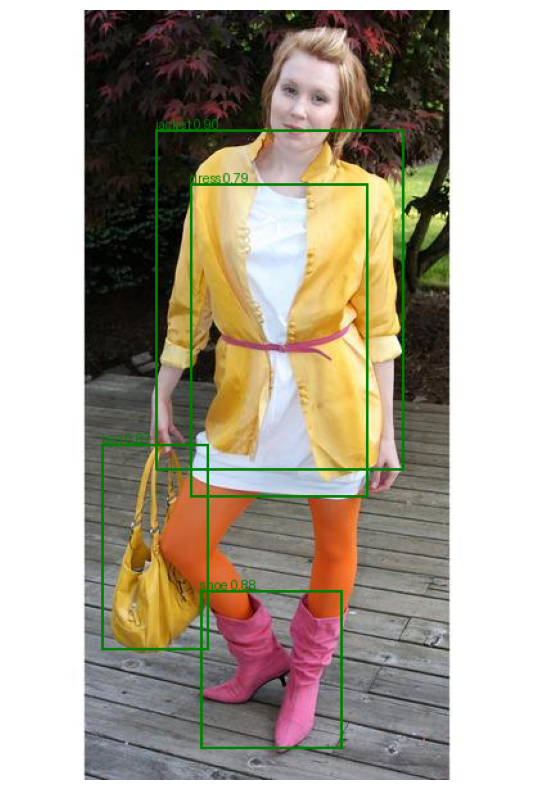

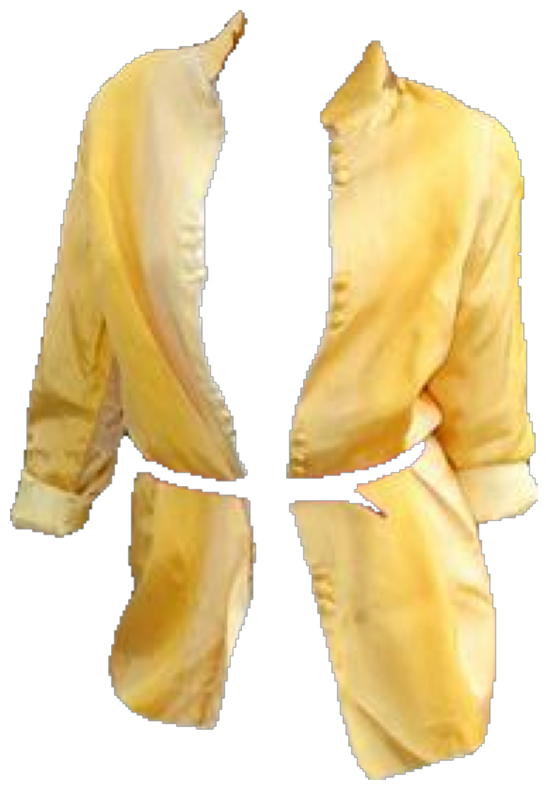

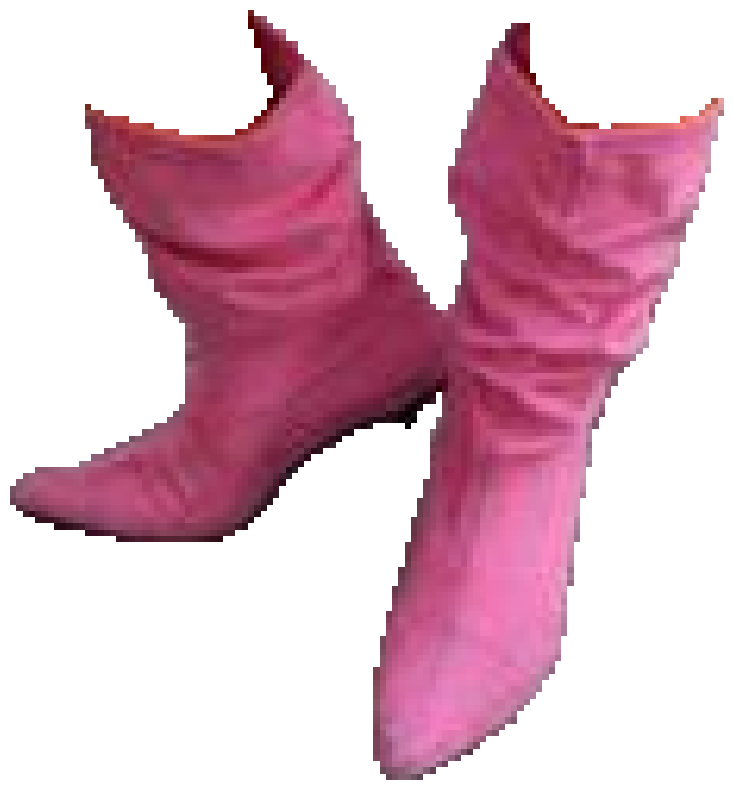

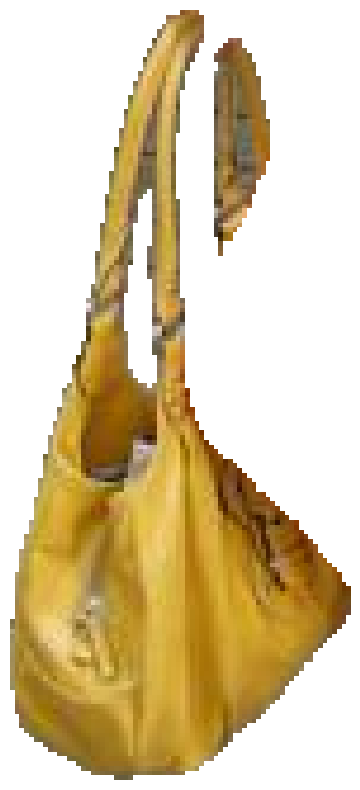

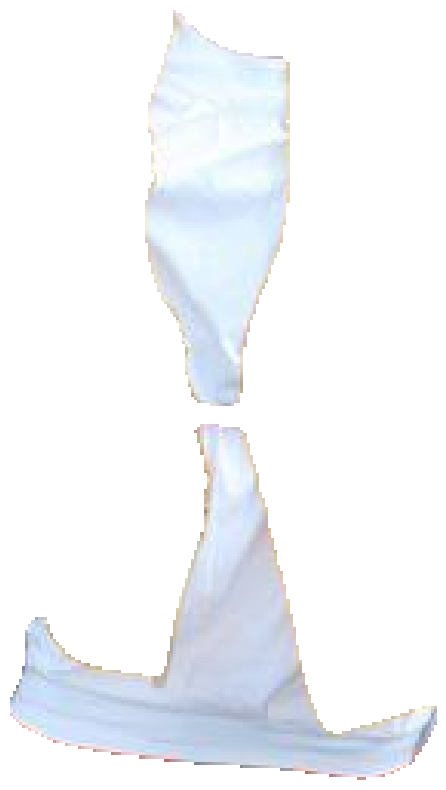

Segmentation complete.


In [8]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
import torch
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamPredictor


def remove_duplicates(detected_items):
    unique_items = {}
    for item in detected_items:
        label = item['label']
        if label in unique_items:
            if item['confidence'] > unique_items[label]['confidence']:
                unique_items[label] = item
        else:
            unique_items[label] = item
    return list(unique_items.values())

def detect_and_segment_objects(base_path, sample_image_path, yolo_weights_path, sam_model_path):
    # Define paths
    cropped_images_dir = os.path.join(base_path, "cropped_images")
    segmented_images_dir = os.path.join(base_path, "segmented_images")
    isolated_cropped_images_dir = os.path.join(base_path, "isolated_cropped_images")
    segmented_cropped_images_dir = os.path.join(base_path, "segmented_cropped")

    # Ensure directories exist
    os.makedirs(cropped_images_dir, exist_ok=True)
    os.makedirs(segmented_images_dir, exist_ok=True)
    os.makedirs(isolated_cropped_images_dir, exist_ok=True)
    os.makedirs(segmented_cropped_images_dir, exist_ok=True)

    # Load the SAM model
    sam = sam_model_registry["vit_h"](checkpoint=sam_model_path).to(device=torch.device('cuda:0'))
    mask_predictor = SamPredictor(sam)

    # Load the YOLO model
    model = YOLO(yolo_weights_path)

    # Load sample image
    image = Image.open(sample_image_path).convert('RGB')
    image_rgb = np.array(image)
    image_bgr = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2BGR)

    # Perform object detection with YOLO
    results = model(sample_image_path)

    # Collect detected items
    detected_items = []
    for result in results:
        boxes = result.boxes
        for box in boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get bounding box coordinates
            confidence = box.conf[0].item()  # Get confidence score
            class_id = int(box.cls[0])  # Get class id
            label = model.names[class_id]  # Get label for class id

            detected_items.append({
                'label': label,
                'coordinates': (x1, y1, x2, y2),
                'confidence': confidence
            })

    # Remove duplicates (keep the highest confidence for each label)
    resolved_items = remove_duplicates(detected_items)

    # Draw bounding boxes and crop images
    predicted_boxes = []
    for item in resolved_items:
        x1, y1, x2, y2 = item['coordinates']
        confidence = item['confidence']
        label = item['label']

        # Draw bounding box on the image
        draw = ImageDraw.Draw(image)
        draw.rectangle([x1, y1, x2, y2], outline="green", width=2)
        draw.text((x1, y1 - 10), f"{label} {confidence:.2f}", fill="green", font=ImageFont.load_default())

        # Crop and save the image using bounding box coordinates
        cropped_filename = os.path.join(cropped_images_dir, f"{label}-{confidence:.2f}.jpg")
        cropped_image = image.crop((x1, y1, x2, y2))
        cropped_image.save(cropped_filename)
        predicted_boxes.append([x1, y1, x2, y2])

        print(f"Saved cropped image: {cropped_filename}")

    print("Cropping complete.")

    # Display the image with bounding boxes
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.axis('off')
    plt.show()

    # Transform the YOLOv8 predicted boxes to match input format expected by SAM model
    predicted_boxes_tensor = torch.tensor(predicted_boxes, dtype=torch.float32).to('cuda')
    transformed_boxes = mask_predictor.transform.apply_boxes_torch(predicted_boxes_tensor, image_bgr.shape[:2])

    # Set the image for SAM to generate segmentation mask
    mask_predictor.set_image(image_bgr)

    # SAM generates masks for the objects within the bounding boxes
    masks, scores, logits = mask_predictor.predict_torch(
        boxes=transformed_boxes.to('cuda'),
        multimask_output=False,
        point_coords=None,
        point_labels=None
    )

    # Save and visualize each mask separately
    for i, mask in enumerate(masks):
        mask = mask[0].cpu().numpy().astype(np.uint8)  # Ensure mask is uint8 type

        # Save the mask
        mask_image = Image.fromarray(mask * 255)  # Convert mask to a binary image
        mask_filename = os.path.join(segmented_images_dir, f"mask_{i}.png")
        mask_image.save(mask_filename)

        # Multiply the mask by the original image to isolate the object
        isolated_image = image_rgb * mask[:, :, np.newaxis]

        # Find the bounding box of the non-background pixels in the isolated image
        coords = np.column_stack(np.where(mask > 0))
        if coords.size == 0:
            print(f"No object found for mask {i}")
            continue
        y1, x1 = coords.min(axis=0)
        y2, x2 = coords.max(axis=0)

        # Crop the isolated image using the bounding box
        isolated_cropped_image = isolated_image[y1:y2+1, x1:x2+1]

        # Create an image with an alpha channel (RGBA)
        isolated_cropped_image_rgba = np.zeros((y2 - y1 + 1, x2 - x1 + 1, 4), dtype=np.uint8)
        isolated_cropped_image_rgba[..., :3] = isolated_cropped_image
        isolated_cropped_image_rgba[..., 3] = mask[y1:y2+1, x1:x2+1] * 255  # Set the alpha channel based on the mask

        isolated_cropped_filename = os.path.join(segmented_cropped_images_dir, f"isolated_cropped_image_{i}.png")
        isolated_cropped_image_rgba_pil = Image.fromarray(isolated_cropped_image_rgba, 'RGBA')
        isolated_cropped_image_rgba_pil.save(isolated_cropped_filename)

        # Display the isolated cropped image
        plt.figure(figsize=(10, 10))
        plt.imshow(isolated_cropped_image_rgba_pil)
        plt.axis('off')
        plt.show()

    print("Segmentation complete.")

# Example usage:
base_path = "./"
annotations_path = "Annotations"
annotations_txt_path = "Annotations_txt"
image_sets_path = "ImageSets/Main"
jpeg_images_path = "JPEGImages"

train_image_path = os.path.join(jpeg_images_path, "train")
val_image_path = os.path.join(jpeg_images_path, "val")
test_image_path = os.path.join(jpeg_images_path, "test")

# Load the trained model
runs_path = os.path.join(base_path, 'runs', 'detect')
weights_save_path = os.path.join(runs_path, 'train','weights')
yolo_best_weights_path = os.path.join(weights_save_path, "best.pt")
sam_model_path = os.path.join(base_path, "models","sam_vit_h_4b8939.pth")

sample_image_path = os.path.join(train_image_path, "127254.jpg")



detect_and_segment_objects(base_path, sample_image_path, yolo_best_weights_path, sam_model_path)

the items we get after removing background and transparent it, is the input for Kmeans clustering

### An Example of detecting RGB color of all clothing items patches for one sample image from the dataset

Processing isolated_cropped_image_1.png...
Item: isolated_cropped_image_1.png
Dominant Color: indianred
Percentages: [     42.012      34.156      23.832]
Cluster Centers: [[175  73 110]
 [134  47  75]
 [220 119 168]]
Counts: [2535 2061 1438]



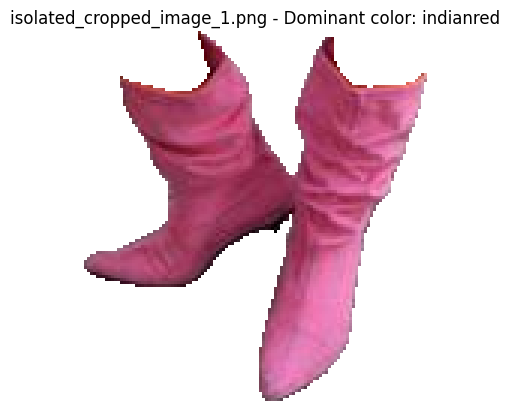

Processing isolated_cropped_image_4.png...
Item: isolated_cropped_image_4.png
Dominant Color: silver
Percentages: [     18.658      73.008      8.3333]
Cluster Centers: [[168 145 166]
 [196 190 205]
 [100  86 106]]
Counts: [ 356 1393  159]



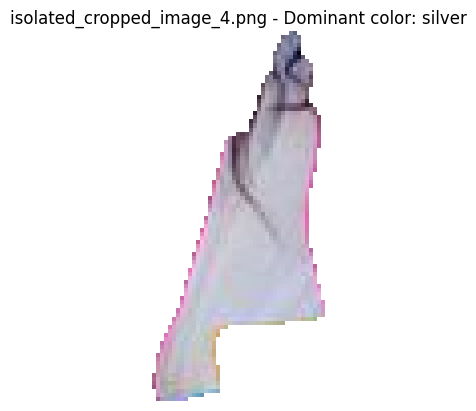

Processing isolated_cropped_image_2.png...
Item: isolated_cropped_image_2.png
Dominant Color: darkgoldenrod
Percentages: [     33.381      37.135      29.485]
Cluster Centers: [[211 174  81]
 [178 137  43]
 [129  93  36]]
Counts: [1885 2097 1665]



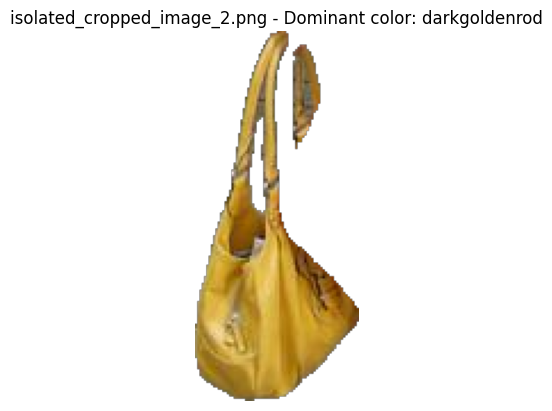

Processing isolated_cropped_image_0.png...
Item: isolated_cropped_image_0.png
Dominant Color: burlywood
Percentages: [     27.227      29.354      43.419]
Cluster Centers: [[193 149  61]
 [243 222 157]
 [229 192 106]]
Counts: [ 7730  8334 12327]



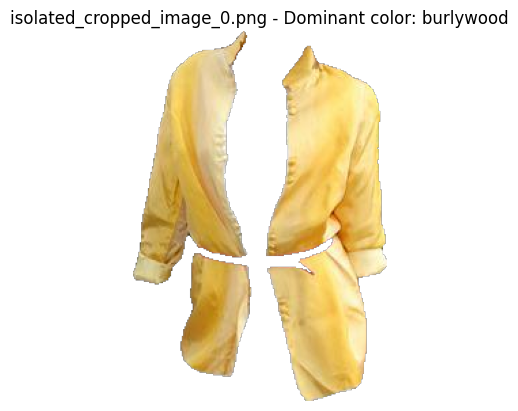

Processing isolated_cropped_image_3.png...
Item: isolated_cropped_image_3.png
Dominant Color: gainsboro
Percentages: [     14.232      40.012      45.756]
Cluster Centers: [[189 190 198]
 [229 241 250]
 [203 213 231]]
Counts: [1432 4026 4604]



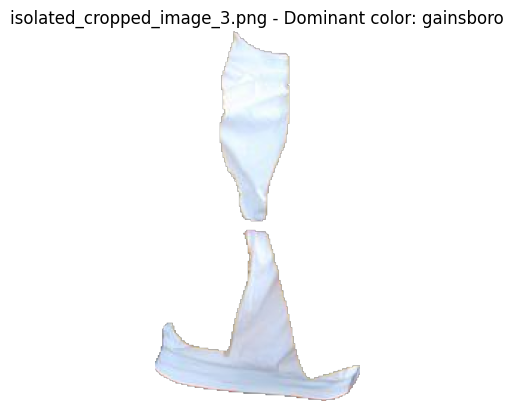

In [13]:
import os
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from PIL import Image

# Define the CSS3 colors and their RGB values
css3_colors = {
    'aliceblue': (240, 248, 255), 'antiquewhite': (250, 235, 215), 'aqua': (0, 255, 255),
    'aquamarine': (127, 255, 212), 'azure': (240, 255, 255), 'beige': (245, 245, 220),
    'bisque': (255, 228, 196), 'black': (0, 0, 0), 'blanchedalmond': (255, 235, 205),
    'blue': (0, 0, 255), 'blueviolet': (138, 43, 226), 'brown': (165, 42, 42),
    'burlywood': (222, 184, 135), 'cadetblue': (95, 158, 160), 'chartreuse': (127, 255, 0),
    'chocolate': (210, 105, 30), 'coral': (255, 127, 80), 'cornflowerblue': (100, 149, 237),
    'cornsilk': (255, 248, 220), 'crimson': (220, 20, 60), 'cyan': (0, 255, 255),
    'darkblue': (0, 0, 139), 'darkcyan': (0, 139, 139), 'darkgoldenrod': (184, 134, 11),
    'darkgray': (169, 169, 169), 'darkgreen': (0, 100, 0), 'darkkhaki': (189, 183, 107),
    'darkmagenta': (139, 0, 139), 'darkolivegreen': (85, 107, 47), 'darkorange': (255, 140, 0),
    'darkorchid': (153, 50, 204), 'darkred': (139, 0, 0), 'darksalmon': (233, 150, 122),
    'darkseagreen': (143, 188, 143), 'darkslateblue': (72, 61, 139), 'darkslategray': (47, 79, 79),
    'darkturquoise': (0, 206, 209), 'darkviolet': (148, 0, 211), 'deeppink': (255, 20, 147),
    'deepskyblue': (0, 191, 255), 'dimgray': (105, 105, 105), 'dodgerblue': (30, 144, 255),
    'firebrick': (178, 34, 34), 'floralwhite': (255, 250, 240), 'forestgreen': (34, 139, 34),
    'fuchsia': (255, 0, 255), 'gainsboro': (220, 220, 220), 'ghostwhite': (248, 248, 255),
    'gold': (255, 215, 0), 'goldenrod': (218, 165, 32), 'gray': (128, 128, 128),
    'green': (0, 128, 0), 'greenyellow': (173, 255, 47), 'honeydew': (240, 255, 240),
    'hotpink': (255, 105, 180), 'indianred': (205, 92, 92), 'indigo': (75, 0, 130),
    'ivory': (255, 255, 240), 'khaki': (240, 230, 140), 'lavender': (230, 230, 250),
    'lavenderblush': (255, 240, 245), 'lawngreen': (124, 252, 0), 'lemonchiffon': (255, 250, 205),
    'lightblue': (173, 216, 230), 'lightcoral': (240, 128, 128), 'lightcyan': (224, 255, 255),
    'lightgoldenrodyellow': (250, 250, 210), 'lightgreen': (144, 238, 144), 'lightgrey': (211, 211, 211),
    'lightpink': (255, 182, 193), 'lightsalmon': (255, 160, 122), 'lightseagreen': (32, 178, 170),
    'lightskyblue': (135, 206, 250), 'lightslategray': (119, 136, 153), 'lightsteelblue': (176, 196, 222),
    'lightyellow': (255, 255, 224), 'lime': (0, 255, 0), 'limegreen': (50, 205, 50),
    'linen': (250, 240, 230), 'magenta': (255, 0, 255), 'maroon': (128, 0, 0),
    'mediumaquamarine': (102, 205, 170), 'mediumblue': (0, 0, 205), 'mediumorchid': (186, 85, 211),
    'mediumpurple': (147, 112, 219), 'mediumseagreen': (60, 179, 113), 'mediumslateblue': (123, 104, 238),
    'mediumspringgreen': (0, 250, 154), 'mediumturquoise': (72, 209, 204), 'mediumvioletred': (199, 21, 133),
    'midnightblue': (25, 25, 112), 'mintcream': (245, 255, 250), 'mistyrose': (255, 228, 225),
    'moccasin': (255, 228, 181), 'navajowhite': (255, 222, 173), 'navy': (0, 0, 128),
    'oldlace': (253, 245, 230), 'olive': (128, 128, 0), 'olivedrab': (107, 142, 35),
    'orange': (255, 165, 0), 'orangered': (255, 69, 0), 'orchid': (218, 112, 214),
    'palegoldenrod': (238, 232, 170), 'palegreen': (152, 251, 152), 'paleturquoise': (175, 238, 238),
    'palevioletred': (219, 112, 147), 'papayawhip': (255, 239, 213), 'peachpuff': (255, 218, 185),
    'peru': (205, 133, 63), 'pink': (255, 192, 203), 'plum': (221, 160, 221),
    'powderblue': (176, 224, 230), 'purple': (128, 0, 128), 'rebeccapurple': (102, 51, 153),
    'red': (255, 0, 0), 'rosybrown': (188, 143, 143), 'royalblue': (65, 105, 225),
    'saddlebrown': (139, 69, 19), 'salmon': (250, 128, 114), 'sandybrown': (244, 164, 96),
    'seagreen': (46, 139, 87), 'seashell': (255, 245, 238), 'sienna': (160, 82, 45),
    'silver': (192, 192, 192), 'skyblue': (135, 206, 235), 'slateblue': (106, 90, 205),
    'slategray': (112, 128, 144), 'snow': (255, 250, 250), 'springgreen': (0, 255, 127),
    'steelblue': (70, 130, 180), 'tan': (210, 180, 140), 'teal': (0, 128, 128),
    'thistle': (216, 191, 216), 'tomato': (255, 99, 71), 'turquoise': (64, 224, 208),
    'violet': (238, 130, 238), 'wheat': (245, 222, 179), 'white': (255, 255, 255),
    'whitesmoke': (245, 245, 245), 'yellow': (255, 255, 0), 'yellowgreen': (154, 205, 50)
}

def closest_color(requested_color):
    min_diff = float('inf')
    closest_color_name = None

    for color_name, rgb in css3_colors.items():
        diff = np.sqrt(np.sum((np.array(rgb) - np.array(requested_color)) ** 2))
        if diff < min_diff:
            min_diff = diff
            closest_color_name = color_name

    return closest_color_name

def kmeans_clustering(image, n_clusters=3):
    pixels = image.reshape(-1, 4)  # Flatten the image
    pixels = pixels[pixels[:, 3] > 0]  # Filter out background pixels
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(pixels[:, :3])  # Apply KMeans on RGB values
    cluster_centers = kmeans.cluster_centers_.astype(int)
    labels = kmeans.labels_
    return cluster_centers, labels

def process_segmented_patch(image):
    cluster_centers, labels = kmeans_clustering(image)
    labels = labels.flatten()
    counts = np.bincount(labels.astype(int))

    # Calculate the percentage of pixels in each cluster
    total_pixels = len(labels)
    percentages = (counts / total_pixels) * 100

    # Find the dominant cluster
    max_count_idx = np.argmax(percentages)
    dominant_color = cluster_centers[max_count_idx]
    dominant_color_name = closest_color(dominant_color[:3])

    return dominant_color_name, percentages, cluster_centers, counts

def process_directory_images(base_path):
    segmented_cropped_path = os.path.join(base_path, "segmented_cropped")
    for image_name in os.listdir(segmented_cropped_path):
        image_path = os.path.join(segmented_cropped_path, image_name)
        print(f"Processing {image_name}...")
        
        # Load and process the image
        image = np.array(Image.open(image_path).convert("RGBA"))
        dominant_color_name, percentages, cluster_centers, counts = process_segmented_patch(image)
        
        # Print and visualize the results
        print(f"Item: {image_name}")
        print(f"Dominant Color: {dominant_color_name}")
        print(f"Percentages: {percentages}")
        print(f"Cluster Centers: {cluster_centers}")
        print(f"Counts: {counts}")
        print()

        # Visualize
        plt.imshow(image)
        plt.axis("off")
        plt.title(f"{image_name} - Dominant color: {dominant_color_name}")
        plt.show()

# Example usage:
base_path = "./"  # Set this to your actual path
process_directory_images(base_path)

### Using Elbow Method


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/train/107.jpg: 640x448 1 pants, 1 dress, 1 shoe, 35.3ms
Speed: 2.0ms preprocess, 35.3ms inference, 89.0ms postprocess per image at shape (1, 3, 640, 448)

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/val/145203.jpg: 640x448 1 shirt, 1 skirt, 1 shoe, 18.2ms
Speed: 1.6ms preprocess, 18.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 448)

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/test/42671.jpg: 640x448 1 shirt, 1 shorts, 1 shoe, 25.1ms
Speed: 1.6ms preprocess, 25.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 448)

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/val/194270.jpg: 640x448 1 shirt, 1 skirt, 1 bag, 1 shoe, 86.9ms
Speed: 1.6ms preprocess, 

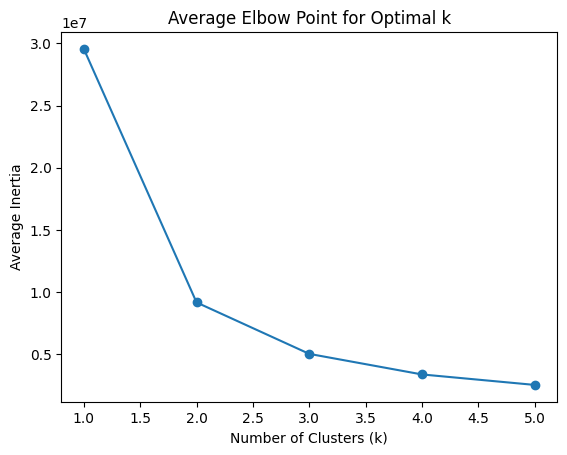

Segmentation and average elbow point calculation complete.


In [1]:
import numpy as np
import cv2
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
import torch
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
import os
import random
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamPredictor



def kmeans_clustering(image, n_clusters):
    pixels = image.reshape(-1, 4)
    pixels = pixels[pixels[:, 3] > 0]  # Only consider non-transparent pixels
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(pixels[:, :3])
    inertia = kmeans.inertia_
    return inertia

def calculate_average_elbow_point(all_segmented_images):
    max_k = 5
    all_inertias = []

    for image in all_segmented_images:
        inertias = []
        for k in range(1, max_k + 1):
            inertia = kmeans_clustering(image, n_clusters=k)
            inertias.append(inertia)
        all_inertias.append(inertias)

    # Convert to numpy array to easily compute the mean across all images
    all_inertias = np.array(all_inertias)
    print(f" all inertias:{all_inertias}")
    mean_inertias = np.mean(all_inertias, axis=0)

    # Plotting the average elbow point
    plt.figure()
    plt.plot(range(1, max_k + 1), mean_inertias, marker='o')
    plt.title('Average Elbow Point for Optimal k')
    plt.xlabel('Number of Clusters (k)')
    plt.ylabel('Average Inertia')
    plt.show()

class FashionDataset(Dataset):
    def __init__(self, image_paths, transform=None):
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        image = Image.open(image_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image_path, image

def remove_duplicates(detected_items):
    unique_items = {}
    for item in detected_items:
        label = item['label']
        if label in unique_items:
            if item['confidence'] > unique_items[label]['confidence']:
                unique_items[label] = item
        else:
            unique_items[label] = item
    return list(unique_items.values())

def detect_and_segment_batch(base_path, image_paths, yolo_weights_path, sam_model_path, batch_size=4):
    sam = sam_model_registry["vit_h"](checkpoint=sam_model_path).to(device=torch.device('cuda:0'))
    mask_predictor = SamPredictor(sam)
    model = YOLO(yolo_weights_path)
    transform = transforms.Compose([transforms.ToTensor()])

    # Randomly sample 100 images
    if len(image_paths) > 200:
        sampled_image_paths = random.sample(image_paths, 200)
    else:
        sampled_image_paths = image_paths

    dataset = FashionDataset(sampled_image_paths, transform=transform)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

    all_segmented_images = []

    for batch in dataloader:
        image_paths_batch, images_batch = batch
        images_batch = images_batch.to('cuda')

        for i, image in enumerate(images_batch):
            sample_image_path = image_paths_batch[i]
            image_pil = transforms.ToPILImage()(image.cpu())
            image_rgb = np.array(image_pil)
            image_bgr = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2BGR)

            # Perform object detection with YOLO
            results = model(sample_image_path)

            # Collect detected items
            detected_items = []
            for result in results:
                boxes = result.boxes
                for box in boxes:
                    x1, y1, x2, y2 = map(int, box.xyxy[0])
                    confidence = box.conf[0].item()
                    class_id = int(box.cls[0])
                    label = model.names[class_id]

                    detected_items.append({
                        'label': label,
                        'coordinates': (x1, y1, x2, y2),
                        'confidence': confidence
                    })

            # Remove duplicates (keep the highest confidence for each label)
            resolved_items = remove_duplicates(detected_items)

            predicted_boxes = []
            for item in resolved_items:
                x1, y1, x2, y2 = item['coordinates']
                predicted_boxes.append([x1, y1, x2, y2])

            predicted_boxes_tensor = torch.tensor(predicted_boxes, dtype=torch.float32).to('cuda')
            transformed_boxes = mask_predictor.transform.apply_boxes_torch(predicted_boxes_tensor, image_bgr.shape[:2])

            mask_predictor.set_image(image_bgr)
            masks, _, _ = mask_predictor.predict_torch(
                boxes=transformed_boxes.to('cuda'),
                multimask_output=False,
                point_coords=None,
                point_labels=None
            )

            for j, mask in enumerate(masks):
                mask = mask[0].cpu().numpy().astype(np.uint8)

                isolated_image = image_rgb * mask[:, :, np.newaxis]

                coords = np.column_stack(np.where(mask > 0))
                if coords.size == 0:
                    print(f"No object found for mask {j}")
                    continue
                y1, x1 = coords.min(axis=0)
                y2, x2 = coords.max(axis=0)

                isolated_cropped_image = isolated_image[y1:y2+1, x1:x2+1]
                isolated_cropped_image_rgba = np.zeros((y2 - y1 + 1, x2 - x1 + 1, 4), dtype=np.uint8)
                isolated_cropped_image_rgba[..., :3] = isolated_cropped_image
                isolated_cropped_image_rgba[..., 3] = mask[y1:y2+1, x1:x2+1] * 255

                # Store the segmented cropped image for elbow calculation
                all_segmented_images.append(isolated_cropped_image_rgba)

        torch.cuda.empty_cache()

    # Calculate the average elbow point for all segmented images
    calculate_average_elbow_point(all_segmented_images)

    print("Segmentation and average elbow point calculation complete.")

# Example usage:
base_path = "./"
annotations_path = "Annotations"
annotations_txt_path = "Annotations_txt"
image_sets_path = "ImageSets/Main"
jpeg_images_path = "JPEGImages"

train_image_path = os.path.join(jpeg_images_path, "train")
val_image_path = os.path.join(jpeg_images_path, "val")
test_image_path = os.path.join(jpeg_images_path, "test")

# Load the trained model
runs_path = os.path.join(base_path, 'runs', 'detect')
weights_save_path = os.path.join(runs_path, 'train','weights')
yolo_best_weights_path = os.path.join(weights_save_path, "best.pt")
sam_model_path = os.path.join(base_path, "models","sam_vit_h_4b8939.pth")



train_images = [os.path.join(train_image_path, img) for img in os.listdir(train_image_path) if img.endswith(('.jpg', '.jpeg', '.png'))]
val_images = [os.path.join(val_image_path, img) for img in os.listdir(val_image_path) if img.endswith(('.jpg', '.jpeg', '.png'))]
test_images = [os.path.join(test_image_path, img) for img in os.listdir(test_image_path) if img.endswith(('.jpg', '.jpeg', '.png'))]

all_image_paths = train_images + val_images + test_images


detect_and_segment_batch(base_path, all_image_paths, yolo_best_weights_path, sam_model_path, batch_size=10)

 based on the elboe method we can see that from k= 3 the wcss decrease slightly which means with more clusters we can not necessarily get better clustering

 The Silhouette Score is a metric used to evaluate the quality of clustering. It measures how similar an object is to its own cluster (cohesion) compared to other clusters (separation). The score ranges from -1 to 1, where:

- +1 indicates that the sample is far away from the neighboring clusters, suggesting that the sample is correctly clustered.

- 0 indicates that the sample is on or very close to the decision boundary between two neighboring clusters, suggesting that the sample could be assigned to either cluster.

- -1 indicates that the sample is closer to a neighboring cluster than to its own cluster, suggesting that the sample has been incorrectly clustered.

Calculating the Silhouette Score:
The silhouette score for a single sample is calculated as:

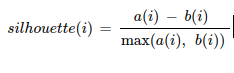

we evaluate the quality of clustering also with another method called Silhouette Score and for each item of clothes in each image andfor 100 samples from data we calculate silhouette scores for k = 2, 3, 4 to see in which number of cluster the silhouette score has is the best score.which shows the quality of clustering .then we can validate elbow method and we can decide for which number of cluster get the best clusters colors and then get the dominant color from them.

Where:

a(i) is the average distance between the sample i and all other points in the same cluster (cohesion).

b(i) is the average distance between the sample i and all points in the nearest cluster that the sample is not a part of (separation).

The overall Silhouette Score for a clustering solution is the average of the silhouette scores of all samples.

### Evaluate the quality of clustering with Silhouette Score

In [2]:
import torch
torch.cuda.empty_cache()



image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/val/12175.jpg: 640x448 1 dress, 1 shoe, 40.9ms
Speed: 3.8ms preprocess, 40.9ms inference, 103.3ms postprocess per image at shape (1, 3, 640, 448)
Image: JPEGImages/val/12175.jpg processed.
Image: JPEGImages/val/12175.jpg processed.

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/train/46319.jpg: 640x448 1 shirt, 1 skirt, 1 shoe, 18.4ms
Speed: 1.6ms preprocess, 18.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 448)
Image: JPEGImages/train/46319.jpg processed.
Image: JPEGImages/train/46319.jpg processed.
Image: JPEGImages/train/46319.jpg processed.

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/train/70193.jpg: 640x448 1 sunglass, 1 shirt, 1 skirt, 1 bag, 1 shoe, 19.4ms
Speed: 3.1ms preprocess, 19.4ms inference, 2.2ms postprocess per 

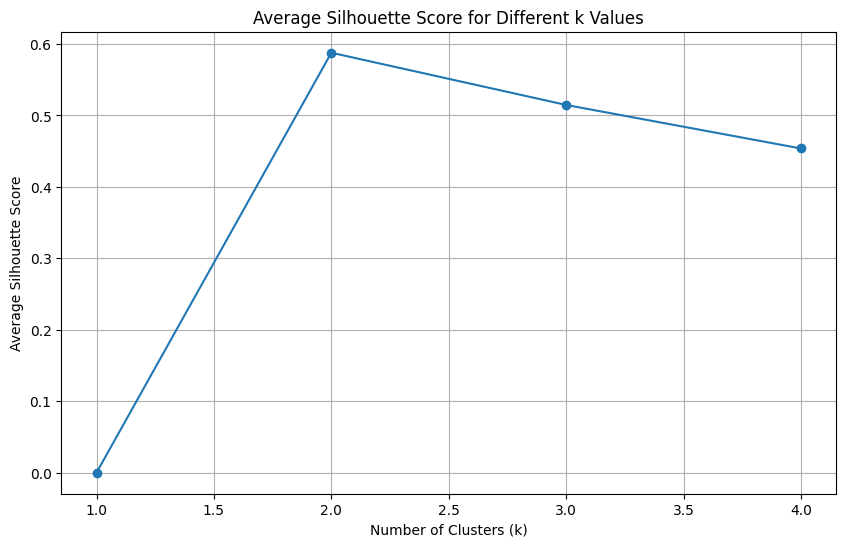

In [2]:
import numpy as np
import cv2
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import os
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
import torch
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
import random

from ultralytics import YOLO
from segment_anything import sam_model_registry, SamPredictor

# Define the FashionDataset class
class FashionDataset(Dataset):
    def __init__(self, image_paths, transform=None):
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        image = Image.open(image_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        return image_path, image

# Function to calculate silhouette score directly from segmented image
def kmeans_clustering(image, n_clusters):
    pixels = image.reshape(-1, 4)
    pixels = pixels[pixels[:, 3] > 0]  # Filter out transparent pixels
    if len(pixels) < n_clusters:  # If there are not enough pixels, return 0
        return 0

    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(pixels[:, :3])  # Clustering based on RGB values
    labels = kmeans.labels_

    # Calculate silhouette score to evaluate clustering quality
    if len(set(labels)) > 1:  # Silhouette score requires at least 2 clusters
        silhouette_avg = silhouette_score(pixels[:, :3], labels)
    else:
        silhouette_avg = 0  # No silhouette score if there's only one cluster

    return silhouette_avg

# Function to remove duplicate detections and keep only the highest confidence detection per label
def remove_duplicates(detected_items):
    item_dict = {}
    for item in detected_items:
        label = item['label']
        if label not in item_dict or item['confidence'] > item_dict[label]['confidence']:
            item_dict[label] = item
    return list(item_dict.values())

def detect_and_segment_batch(base_path, image_paths, yolo_weights_path, sam_model_path, batch_size=4, k_values=[1, 2, 3, 4]):
    sam = sam_model_registry["vit_h"](checkpoint=sam_model_path).to(device=torch.device('cuda:0'))
    mask_predictor = SamPredictor(sam)
    model = YOLO(yolo_weights_path)
    transform = transforms.Compose([transforms.ToTensor()])

    dataset = FashionDataset(image_paths, transform=transform)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

    silhouette_scores = {k: 0 for k in k_values}  # Initialize dictionary to hold scores for each k
    total_images = 0  # Counter for the number of processed images

    for batch in dataloader:
        image_paths_batch, images_batch = batch
        images_batch = images_batch.to('cuda')

        for i, image in enumerate(images_batch):
            sample_image_path = image_paths_batch[i]
            image_rgb = np.array(transforms.ToPILImage()(image.cpu()))
            image_bgr = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2BGR)

            # Perform object detection with YOLO
            results = model(sample_image_path)

            # Collect detected items
            detected_items = []
            for result in results:
                boxes = result.boxes
                for box in boxes:
                    x1, y1, x2, y2 = map(int, box.xyxy[0])
                    confidence = box.conf[0].item()
                    class_id = int(box.cls[0])
                    label = model.names[class_id]

                    detected_items.append({
                        'label': label,
                        'coordinates': (x1, y1, x2, y2),
                        'confidence': confidence
                    })

            # Remove duplicates (keep the highest confidence for each label)
            resolved_items = remove_duplicates(detected_items)

            for item in resolved_items:
                x1, y1, x2, y2 = item['coordinates']

                # Generate mask for the detected object
                predicted_boxes = torch.tensor([[x1, y1, x2, y2]], dtype=torch.float32).to('cuda')
                transformed_boxes = mask_predictor.transform.apply_boxes_torch(predicted_boxes, image_bgr.shape[:2])

                mask_predictor.set_image(image_bgr)
                masks, _, _ = mask_predictor.predict_torch(
                    boxes=transformed_boxes.to('cuda'),
                    multimask_output=False,
                    point_coords=None,
                    point_labels=None
                )

                for mask in masks:
                    mask = mask[0].cpu().numpy().astype(np.uint8)

                    # Apply mask to isolate the segmented object
                    isolated_image = image_rgb * mask[:, :, np.newaxis]

                    # Crop the isolated object from the original image
                    coords = np.column_stack(np.where(mask > 0))
                    if coords.size == 0:
                        print(f"No object found for mask.")
                        continue
                    y1, x1 = coords.min(axis=0)
                    y2, x2 = coords.max(axis=0)

                    isolated_cropped_image = isolated_image[y1:y2+1, x1:x2+1]
                    isolated_cropped_image_rgba = np.zeros((y2 - y1 + 1, x2 - x1 + 1, 4), dtype=np.uint8)
                    isolated_cropped_image_rgba[..., :3] = isolated_cropped_image
                    isolated_cropped_image_rgba[..., 3] = mask[y1:y2+1, x1:x2+1] * 255

                    # Calculate silhouette score for the segmented cropped image for each k
                    for k in k_values:
                        silhouette_avg = kmeans_clustering(isolated_cropped_image_rgba, n_clusters=k)
                        silhouette_scores[k] += silhouette_avg

                    total_images += 1
                    print(f"Image: {sample_image_path} processed.")

    # Calculate and print the average silhouette score for each k
    if total_images > 0:
        for k in k_values:
            silhouette_scores[k] /= total_images
            print(f"Average Silhouette Score for k={k}: {silhouette_scores[k]:.4f}")
    else:
        print("No images were processed.")

    torch.cuda.empty_cache()

    print("Segmentation and silhouette score calculation complete.")
    return silhouette_scores


# Example usage:
base_path = "./"
annotations_path = "Annotations"
annotations_txt_path = "Annotations_txt"
image_sets_path = "ImageSets/Main"
jpeg_images_path = "JPEGImages"

train_image_path = os.path.join(jpeg_images_path, "train")
val_image_path = os.path.join(jpeg_images_path, "val")
test_image_path = os.path.join(jpeg_images_path, "test")

# Load the trained model
runs_path = os.path.join(base_path, 'runs', 'detect')
weights_save_path = os.path.join(runs_path, 'train','weights')
yolo_best_weights_path = os.path.join(weights_save_path, "best.pt")
sam_model_path = os.path.join(base_path, "models","sam_vit_h_4b8939.pth")

train_images = [os.path.join(train_image_path, img) for img in os.listdir(train_image_path) if img.endswith(('.jpg', '.jpeg', '.png'))]
val_images = [os.path.join(val_image_path, img) for img in os.listdir(val_image_path) if img.endswith(('.jpg', '.jpeg', '.png'))]
test_images = [os.path.join(test_image_path, img) for img in os.listdir(test_image_path) if img.endswith(('.jpg', '.jpeg', '.png'))]

all_image_paths = train_images + val_images + test_images

# Sample 10 images
sampled_image_paths = random.sample(all_image_paths, 10)

# Define k values to test
k_values = [1, 2, 3, 4]

# Process and calculate silhouette score for the sampled images with different k values
silhouette_scores = detect_and_segment_batch(base_path, sampled_image_paths, yolo_best_weights_path, sam_model_path, batch_size=10, k_values=k_values)

# Plotting the silhouette scores
plt.figure(figsize=(10, 6))
plt.plot(k_values, [silhouette_scores[k] for k in k_values], marker='o')
plt.title('Average Silhouette Score for Different k Values')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Average Silhouette Score')
plt.grid(True)
plt.show()


### Complete PipeLine for getting color of all RGBpatches of clothing items using KMeans clustering

In [1]:
import numpy as np
import cv2
from sklearn.cluster import KMeans
from skimage import color
import os
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
import torch
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms

from ultralytics import YOLO
import requests

from segment_anything import sam_model_registry, SamPredictor



# a dictionary that containd the RGB values of css3 color names
css3_colors = {
    'aliceblue': (240, 248, 255), 'antiquewhite': (250, 235, 215), 'aqua': (0, 255, 255),
    'aquamarine': (127, 255, 212), 'azure': (240, 255, 255), 'beige': (245, 245, 220),
    'bisque': (255, 228, 196), 'black': (0, 0, 0), 'blanchedalmond': (255, 235, 205),
    'blue': (0, 0, 255), 'blueviolet': (138, 43, 226), 'brown': (165, 42, 42),
    'burlywood': (222, 184, 135), 'cadetblue': (95, 158, 160), 'chartreuse': (127, 255, 0),
    'chocolate': (210, 105, 30), 'coral': (255, 127, 80), 'cornflowerblue': (100, 149, 237),
    'cornsilk': (255, 248, 220), 'crimson': (220, 20, 60), 'cyan': (0, 255, 255),
    'darkblue': (0, 0, 139), 'darkcyan': (0, 139, 139), 'darkgoldenrod': (184, 134, 11),
    'darkgray': (169, 169, 169), 'darkgreen': (0, 100, 0), 'darkkhaki': (189, 183, 107),
    'darkmagenta': (139, 0, 139), 'darkolivegreen': (85, 107, 47), 'darkorange': (255, 140, 0),
    'darkorchid': (153, 50, 204), 'darkred': (139, 0, 0), 'darksalmon': (233, 150, 122),
    'darkseagreen': (143, 188, 143), 'darkslateblue': (72, 61, 139), 'darkslategray': (47, 79, 79),
    'darkturquoise': (0, 206, 209), 'darkviolet': (148, 0, 211), 'deeppink': (255, 20, 147),
    'deepskyblue': (0, 191, 255), 'dimgray': (105, 105, 105), 'dodgerblue': (30, 144, 255),
    'firebrick': (178, 34, 34), 'floralwhite': (255, 250, 240), 'forestgreen': (34, 139, 34),
    'fuchsia': (255, 0, 255), 'gainsboro': (220, 220, 220), 'ghostwhite': (248, 248, 255),
    'gold': (255, 215, 0), 'goldenrod': (218, 165, 32), 'gray': (128, 128, 128),
    'green': (0, 128, 0), 'greenyellow': (173, 255, 47), 'honeydew': (240, 255, 240),
    'hotpink': (255, 105, 180), 'indianred': (205, 92, 92), 'indigo': (75, 0, 130),
    'ivory': (255, 255, 240), 'khaki': (240, 230, 140), 'lavender': (230, 230, 250),
    'lavenderblush': (255, 240, 245), 'lawngreen': (124, 252, 0), 'lemonchiffon': (255, 250, 205),
    'lightblue': (173, 216, 230), 'lightcoral': (240, 128, 128), 'lightcyan': (224, 255, 255),
    'lightgoldenrodyellow': (250, 250, 210), 'lightgreen': (144, 238, 144), 'lightgrey': (211, 211, 211),
    'lightpink': (255, 182, 193), 'lightsalmon': (255, 160, 122), 'lightseagreen': (32, 178, 170),
    'lightskyblue': (135, 206, 250), 'lightslategray': (119, 136, 153), 'lightsteelblue': (176, 196, 222),
    'lightyellow': (255, 255, 224), 'lime': (0, 255, 0), 'limegreen': (50, 205, 50),
    'linen': (250, 240, 230), 'magenta': (255, 0, 255), 'maroon': (128, 0, 0),
    'mediumaquamarine': (102, 205, 170), 'mediumblue': (0, 0, 205), 'mediumorchid': (186, 85, 211),
    'mediumpurple': (147, 112, 219), 'mediumseagreen': (60, 179, 113), 'mediumslateblue': (123, 104, 238),
    'mediumspringgreen': (0, 250, 154), 'mediumturquoise': (72, 209, 204), 'mediumvioletred': (199, 21, 133),
    'midnightblue': (25, 25, 112), 'mintcream': (245, 255, 250), 'mistyrose': (255, 228, 225),
    'moccasin': (255, 228, 181), 'navajowhite': (255, 222, 173), 'navy': (0, 0, 128),
    'oldlace': (253, 245, 230), 'olive': (128, 128, 0), 'olivedrab': (107, 142, 35),
    'orange': (255, 165, 0), 'orangered': (255, 69, 0), 'orchid': (218, 112, 214),
    'palegoldenrod': (238, 232, 170), 'palegreen': (152, 251, 152), 'paleturquoise': (175, 238, 238),
    'palevioletred': (219, 112, 147), 'papayawhip': (255, 239, 213), 'peachpuff': (255, 218, 185),
    'peru': (205, 133, 63), 'pink': (255, 192, 203), 'plum': (221, 160, 221),
    'powderblue': (176, 224, 230), 'purple': (128, 0, 128), 'rebeccapurple': (102, 51, 153),
    'red': (255, 0, 0), 'rosybrown': (188, 143, 143), 'royalblue': (65, 105, 225),
    'saddlebrown': (139, 69, 19), 'salmon': (250, 128, 114), 'sandybrown': (244, 164, 96),
    'seagreen': (46, 139, 87), 'seashell': (255, 245, 238), 'sienna': (160, 82, 45),
    'silver': (192, 192, 192), 'skyblue': (135, 206, 235), 'slateblue': (106, 90, 205),
    'slategray': (112, 128, 144), 'snow': (255, 250, 250), 'springgreen': (0, 255, 127),
    'steelblue': (70, 130, 180), 'tan': (210, 180, 140), 'teal': (0, 128, 128),
    'thistle': (216, 191, 216), 'tomato': (255, 99, 71), 'turquoise': (64, 224, 208),
    'violet': (238, 130, 238), 'wheat': (245, 222, 179), 'white': (255, 255, 255),
    'whitesmoke': (245, 245, 245), 'yellow': (255, 255, 0), 'yellowgreen': (154, 205, 50)
}



def closest_color(requested_color):
    min_diff = float('inf')
    closest_color_name = None
    for color_name, rgb in css3_colors.items():
        diff = np.sqrt(np.sum((np.array(rgb) - np.array(requested_color)) ** 2))
        if diff < min_diff:
            min_diff = diff
            closest_color_name = color_name
    return closest_color_name


def kmeans_clustering(image, n_clusters=2):
    pixels = image.reshape(-1, 4)
    pixels = pixels[pixels[:, 3] > 0]
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(pixels[:, :3])
    cluster_centers = kmeans.cluster_centers_
    cluster_centers = (cluster_centers * 255).astype(int)
    labels = kmeans.labels_
    return cluster_centers, labels



def process_segmented_patch(image):
    cluster_centers, labels = kmeans_clustering(image)
    labels = labels.flatten()
    counts = np.bincount(labels.astype(int))

    total_pixels = len(labels)
    percentages = (counts / total_pixels) * 100

    max_count_idx = np.argmax(percentages)
    dominant_color = cluster_centers[max_count_idx]
    dominant_color_name = closest_color(dominant_color[:3])

    return dominant_color_name, percentages, cluster_centers, counts, dominant_color



class FashionDataset(Dataset):
    def __init__(self, image_paths, transform=None):
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        image = Image.open(image_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image_path, image



def remove_duplicates(detected_items):
    unique_items = {}
    for item in detected_items:
        label = item['label']
        if label in unique_items:
            if item['confidence'] > unique_items[label]['confidence']:
                unique_items[label] = item
        else:
            unique_items[label] = item
    return list(unique_items.values())



def detect_and_segment_batch(base_path, image_paths, yolo_weights_path, sam_model_path, batch_size=4):
    sam = sam_model_registry["vit_h"](checkpoint=sam_model_path).to(device=torch.device('cuda:0'))
    mask_predictor = SamPredictor(sam)
    model = YOLO(yolo_weights_path)
    transform = transforms.Compose([transforms.ToTensor()])

    dataset = FashionDataset(image_paths, transform=transform)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

    for batch in dataloader:
        image_paths_batch, images_batch = batch
        images_batch = images_batch.to('cuda')

        for i, image in enumerate(images_batch):
            sample_image_path = image_paths_batch[i]
            image_name = os.path.splitext(os.path.basename(sample_image_path))[0]
            image_dir = os.path.join(base_path, f"color_detection_kmeans/{image_name}")
            os.makedirs(image_dir, exist_ok=True)

            # Perform object detection with YOLO
            results = model(sample_image_path)
            image_pil = transforms.ToPILImage()(image.cpu())
            image_rgb = np.array(image_pil)
            image_bgr = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2BGR)

            # Collect detected items
            detected_items = []
            for result in results:
                boxes = result.boxes
                for box in boxes:
                    x1, y1, x2, y2 = map(int, box.xyxy[0])
                    confidence = box.conf[0].item()
                    class_id = int(box.cls[0])
                    label = model.names[class_id]

                    detected_items.append({
                        'label': label,
                        'coordinates': (x1, y1, x2, y2),
                        'confidence': confidence
                    })
                    
                    

            # Remove duplicates (keep the highest confidence for each label)
            resolved_items = remove_duplicates(detected_items)

            crop_counter = 0
            predicted_boxes = []
            crop_dirs = []
            labels = []
            for item in resolved_items:
                x1, y1, x2, y2 = item['coordinates']
                confidence = item['confidence']
                label = item['label']
                labels.append(label)

                cropped_dir = os.path.join(image_dir, f"{label}-{confidence:.2f}-{crop_counter}")
                os.makedirs(cropped_dir, exist_ok=True)
                crop_dirs.append(cropped_dir)

                original_filename = os.path.join(cropped_dir, "original.jpg")
                image_pil.save(original_filename)

                draw = ImageDraw.Draw(image_pil)
                draw.rectangle([x1, y1, x2, y2], outline="green", width=2)
                draw.text((x1, y1 - 10), f"{label} {confidence:.2f}", fill="green", font=ImageFont.load_default())

                cropped_filename = os.path.join(cropped_dir, "cropped.jpg")
                cropped_image = image_pil.crop((x1, y1, x2, y2))
                cropped_image.save(cropped_filename)
                predicted_boxes.append([x1, y1, x2, y2])
                crop_counter += 1

            print("Cropping complete.")
            predicted_boxes_tensor = torch.tensor(predicted_boxes, dtype=torch.float32).to('cuda')
            transformed_boxes = mask_predictor.transform.apply_boxes_torch(predicted_boxes_tensor, image_bgr.shape[:2])

            mask_predictor.set_image(image_bgr)
            masks, scores, logits = mask_predictor.predict_torch(
                boxes=transformed_boxes.to('cuda'),
                multimask_output=False,
                point_coords=None,
                point_labels=None
            )

            for j, mask in enumerate(masks):
                mask = mask[0].cpu().numpy().astype(np.uint8)
                mask_image = Image.fromarray(mask * 255)
                mask_filename = os.path.join(crop_dirs[j], "mask.png")
                mask_image.save(mask_filename)

                isolated_image = image_rgb * mask[:, :, np.newaxis]
                isolated_image_pil = Image.fromarray(isolated_image)
                isolated_filename = os.path.join(crop_dirs[j], "isolated.png")
                isolated_image_pil.save(isolated_filename)

                coords = np.column_stack(np.where(mask > 0))
                if coords.size == 0:
                    print(f"No object found for mask {j}")
                    continue
                y1, x1 = coords.min(axis=0)
                y2, x2 = coords.max(axis=0)

                isolated_cropped_image = isolated_image[y1:y2+1, x1:x2+1]
                isolated_cropped_image_rgba = np.zeros((y2 - y1 + 1, x2 - x1 + 1, 4), dtype=np.uint8)
                isolated_cropped_image_rgba[..., :3] = isolated_cropped_image
                isolated_cropped_image_rgba[..., 3] = mask[y1:y2+1, x1:x2+1] * 255

                segmented_cropped_filename = os.path.join(crop_dirs[j], "segmented_cropped.png")
                isolated_cropped_image_rgba_pil = Image.fromarray(isolated_cropped_image_rgba, 'RGBA')
                isolated_cropped_image_rgba_pil.save(segmented_cropped_filename)

                segmented_cropped_image = plt.imread(segmented_cropped_filename)
                print(f"Processing color for segmented cropped image: {segmented_cropped_filename}")
                dominant_color_name, percentages, cluster_centers, counts, dominant_color = process_segmented_patch(segmented_cropped_image)
                item_name = os.path.basename(crop_dirs[j]).split('-')[0]
                text_filename = os.path.join(crop_dirs[j], "color.txt")
                with open(text_filename, 'w') as f:
                    f.write(f"A photo of a {dominant_color_name} (RGB: {dominant_color.tolist()}) {item_name}.\n")
                    f.write(f"Final Colors: {cluster_centers.tolist()}\n")
                    for idx, color_center in enumerate(cluster_centers):
                        color_name = closest_color(color_center[:3])
                        f.write(f"Color Name: {color_name}, RGB: {color_center.tolist()}\n")
                    f.write(f"Counts of cluster pixels: {counts.tolist()}\n")
                    f.write(f"Percentages: {percentages.tolist()}\n")
                    f.write(f"Dominant Cluster: {np.argmax(counts)}\n")
                print(f"Processed {segmented_cropped_filename} -> {text_filename}")

        torch.cuda.empty_cache()

    print("Segmentation and color detection complete.")


# Example usage:
base_path = "./"
annotations_path = "Annotations"
annotations_txt_path = "Annotations_txt"
image_sets_path = "ImageSets/Main"
jpeg_images_path = "JPEGImages"

train_image_path = os.path.join(jpeg_images_path, "train")
val_image_path = os.path.join(jpeg_images_path, "val")
test_image_path = os.path.join(jpeg_images_path, "test")

# Load the trained model
runs_path = os.path.join(base_path, 'runs', 'detect')
weights_save_path = os.path.join(runs_path, 'train','weights')
yolo_best_weights_path = os.path.join(weights_save_path, "best.pt")
sam_model_path = os.path.join(base_path, "models","sam_vit_h_4b8939.pth")



train_images = [os.path.join(train_image_path, img) for img in os.listdir(train_image_path) if img.endswith(('.jpg', '.jpeg', '.png'))]
val_images = [os.path.join(val_image_path, img) for img in os.listdir(val_image_path) if img.endswith(('.jpg', '.jpeg', '.png'))]
test_images = [os.path.join(test_image_path, img) for img in os.listdir(test_image_path) if img.endswith(('.jpg', '.jpeg', '.png'))]

all_image_paths = train_images + val_images + test_images






detect_and_segment_batch(base_path, all_image_paths, yolo_best_weights_path, sam_model_path, batch_size=10)


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/colorful_fashion_dataset/JPEGImages/train/110094.jpg: 640x448 1 dress, 1 bag, 1 shoe, 33.7ms
Speed: 1.6ms preprocess, 33.7ms inference, 106.9ms postprocess per image at shape (1, 3, 640, 448)
Cropping complete.
Processing color for segmented cropped image: ./color_detection_kmeans/110094/dress-0.87-0/segmented_cropped.png
Processed ./color_detection_kmeans/110094/dress-0.87-0/segmented_cropped.png -> ./color_detection_kmeans/110094/dress-0.87-0/color.txt
Processing color for segmented cropped image: ./color_detection_kmeans/110094/shoe-0.63-1/segmented_cropped.png
Processed ./color_detection_kmeans/110094/shoe-0.63-1/segmented_cropped.png -> ./color_detection_kmeans/110094/shoe-0.63-1/color.txt
Processing color for segmented cropped image: ./color_detection_kmeans/110094/bag-0.29-2/segmented_cropped.png
Processed ./color_detection_kmeans/110094/bag-0.29-2/segmented_cropped.png -> ./color_detection_kmeans/110094

### Test the Pipeline with a New Dataset

The nex step is testing our model on new images. To this end we used images from another dataset which are 385 images of different clothing item .we pass through these images from our combinational model (YOLO + SAM) to see the results.

In [2]:
import os
import glob
import numpy as np
import pandas as pd
import torch
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt



### Explore new Dataset 

 we need to overlay bounding box on the image to see which format is our bounding box

True
['48 0.52890625 0.6234375 0.60546875 0.7390625']


/snap/core20/current/lib/x86_64-linux-gnu/libstdc++.so.6: version `GLIBCXX_3.4.29' not found (required by /lib/x86_64-linux-gnu/libproxy.so.1)
Failed to load module: /home/zohreh/snap/code/common/.cache/gio-modules/libgiolibproxy.so
eog: symbol lookup error: /snap/core20/current/lib/x86_64-linux-gnu/libpthread.so.0: undefined symbol: __libc_pthread_init, version GLIBC_PRIVATE


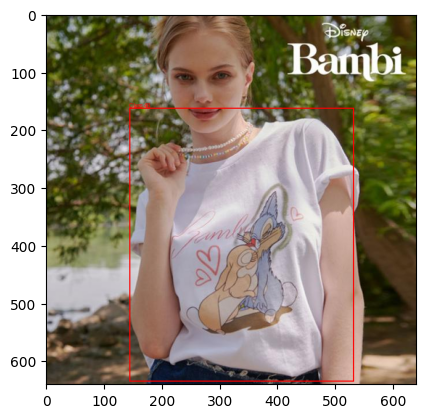

In [3]:
base_path= "/home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering"
train_path = os.path.join(base_path, "test")
print(os.path.exists(base_path))


# Check if the path exists
# print(os.path.exists(train_path))  # This should print True if the path is correct
image_dir = os.path.join(train_path, "images")
# print(os.path.exists(images_path))
label_dir = os.path.join(train_path, "labels")
# print(os.path.exists(labels_path))


class FashionProduct(Dataset):
    
    def __init__(self, image_dir, label_dir, transform = None ):
        self.image_dir = image_dir
        self.label_dir = label_dir
        img_path = glob.glob(os.path.join(self.image_dir, "*.jpg"))
        # print(img_path)
        self.image_filenames = [os.path.basename(img_path) for img_path in glob.glob(os.path.join(self.image_dir, "*.jpg"))]
        # print(self.image_filenames)
        
        
        self.transform = transforms
        
    def __len__(self, ):
        return len(self.image_filenames)
    
    
    def __getitem__(self, idx):
        
        img_name = self.image_filenames[idx]
        img_path = os.path.join(self.image_dir, img_name)
        label_name = img_name.replace('.jpg', '.txt')
        label_path = os.path.join(self.label_dir, label_name)

        with open(label_path, 'r') as f:
            labels = f.readlines()
            print(labels)
            
        class_ids = []
        boxes = []
        for label in labels:
            parts = label.strip().split()
            color_id = int(parts[0])
            x_center = float(parts[1])
            y_center = float(parts[2])
            width = float(parts[3])
            height = float(parts[4])
            class_ids.append(int(color_id))
            boxes.append((x_center, y_center, width, height))

        return img_path, class_ids, boxes
    
    
    
# Function to convert YOLO format to (xmin, ymin, xmax, ymax)
def yolo_to_corners(x_center, y_center, width, height, img_width, img_height):
    x_min = int((x_center - width / 2) * img_width)
    y_min = int((y_center - height / 2) * img_height)
    x_max = int((x_center + width / 2) * img_width)
    y_max = int((y_center + height / 2) * img_height)
    return x_min, y_min, x_max, y_max


 #Function to overlay bounding boxes
def overlay_bounding_boxes(img_path, boxes, class_ids=None):
    image = Image.open(img_path).convert("RGB")
    draw = ImageDraw.Draw(image)

    for box in boxes:
        x_min, y_min, x_max, y_max = box
        draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=2)
        
        if class_ids:
            draw.text((x_min, y_min - 10), f"Class {class_ids[boxes.index(box)]}", fill="red")
    plt.imshow(image)       
    image.show()

# Example usage
dataset = FashionProduct(image_dir=image_dir, label_dir=label_dir)
img_path, class_ids, boxes = dataset[0]

img = Image.open(img_path)
img_width, img_height = img.size
converted_boxes = [
    yolo_to_corners(x_center, y_center, width, height, img_width, img_height)
    for x_center, y_center, width, height in boxes
]

overlay_bounding_boxes(img_path, converted_boxes, class_ids)
        
        
    
    


one additional step for us when testing our model is read the ground truth bounding boxes from .txt files in folder labels, and converts them into (x_min, y_min, x_max, y_max) coordinates and calculates the IOU between coordinated predicted by YOLOV8  and ground truth bounding boxes.
To this end we add a function called yolo_to_bbox_coordinates and function calculate_iou to our pipeline and pass our images through the pipe line to get the dominant cluster color.


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/11_jpg.rf.a5888f244e468126b8c969c163c7b63e.jpg: 640x640 1 dress, 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


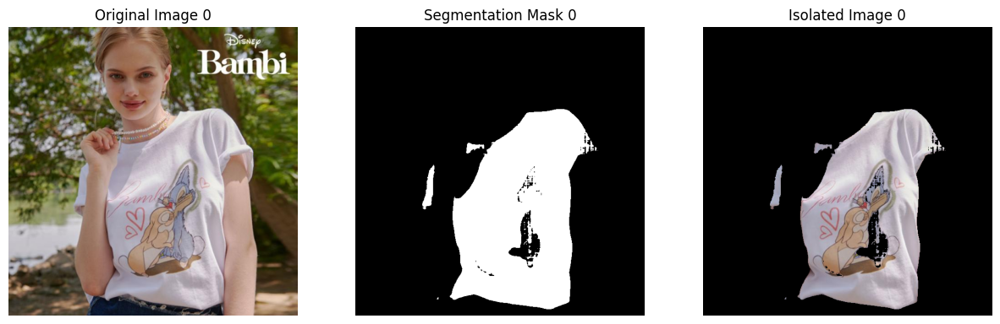


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/37_jpg.rf.c471e5f48320cca9445c5192d723884a.jpg: 640x640 1 hat, 1 dress, 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


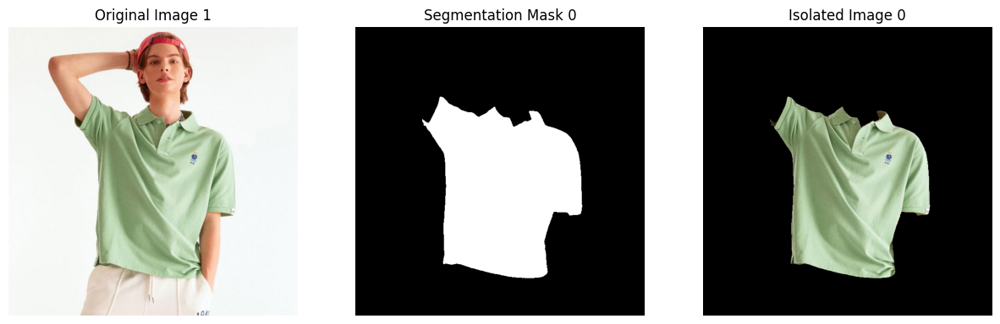

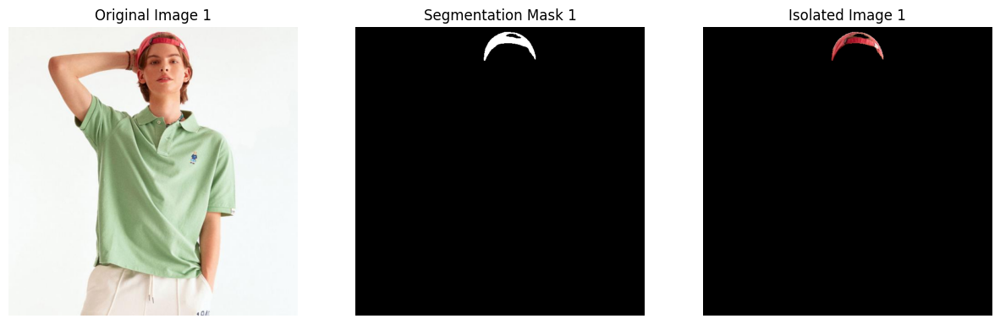


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/78_jpg.rf.247214a20012ccd2682885416f4b43db.jpg: 640x640 1 jacket, 1 shirt, 1 skirt, 2 shoes, 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


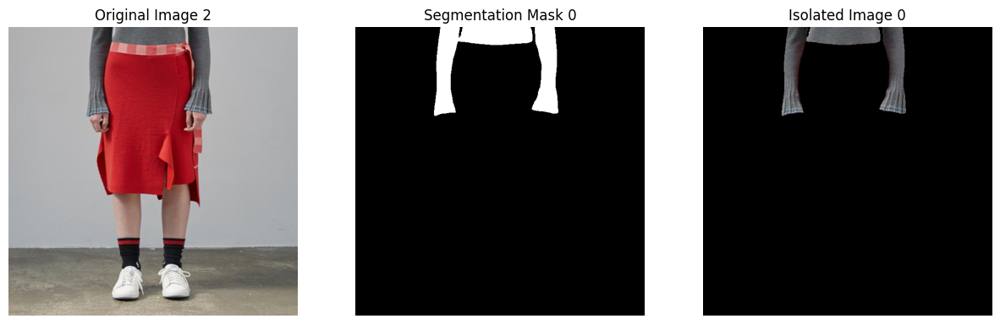

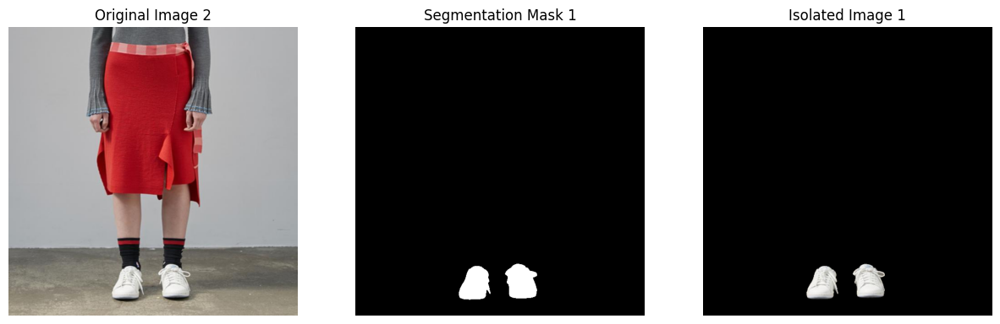

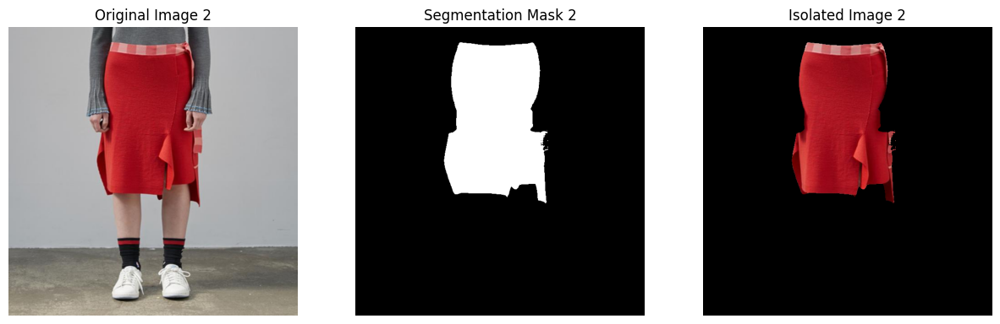

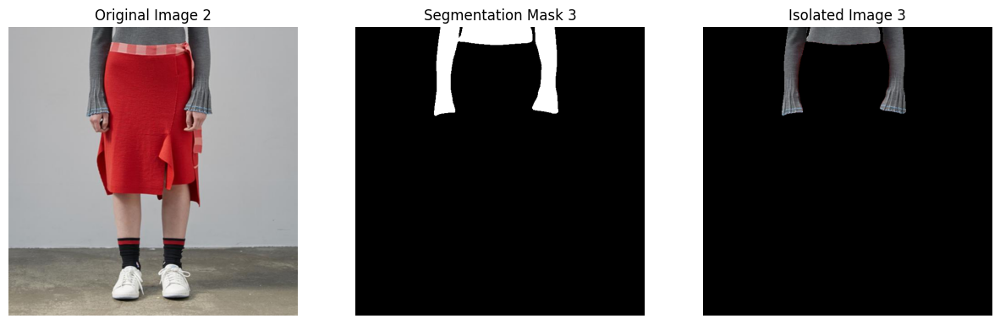


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/20_jpg.rf.37945318b87949b175100744c56f17d5.jpg: 640x640 1 hat, 1 dress, 24.5ms
Speed: 1.2ms preprocess, 24.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


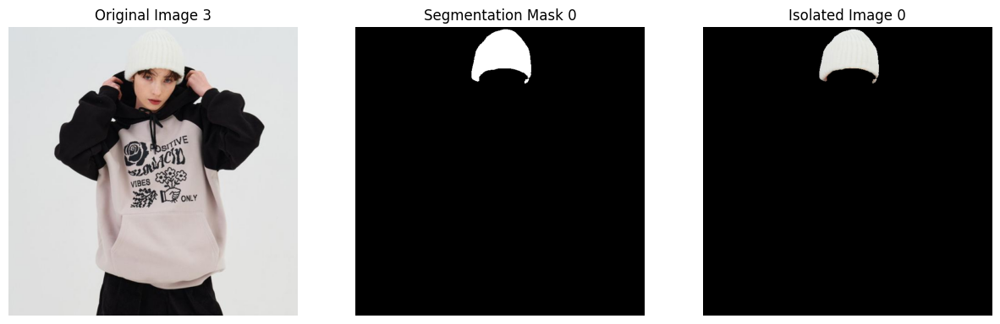

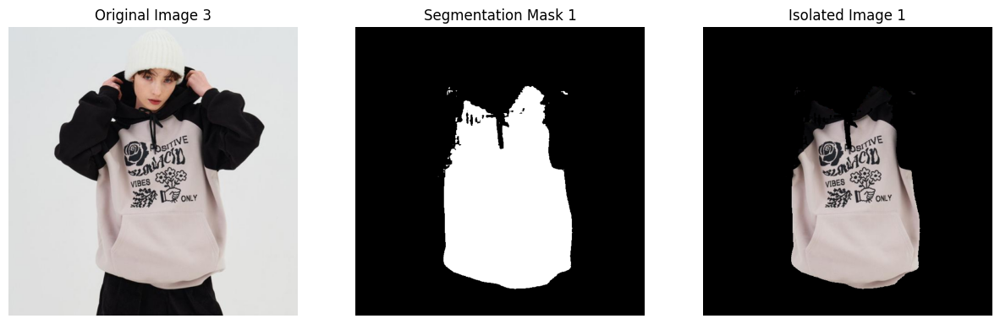


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/37_jpg.rf.f93ef437083a166281a5fa6563afe746.jpg: 640x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


RuntimeError: cannot reshape tensor of 0 elements into shape [0, -1, 256, 256] because the unspecified dimension size -1 can be any value and is ambiguous

In [6]:
import os
import glob
import torch
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamPredictor

# Define the Dataset Class
class FashionProduct(Dataset):
    
    def __init__(self, image_dir, label_dir, transform=None):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.image_filenames = [os.path.basename(img_path) for img_path in glob.glob(os.path.join(self.image_dir, "*.jpg"))]
        self.transform = transform
        
    def __len__(self):
        return len(self.image_filenames)
    
    def __getitem__(self, idx):
        img_name = self.image_filenames[idx]
        img_path = os.path.join(self.image_dir, img_name)
        label_name = img_name.replace('.jpg', '.txt')
        label_path = os.path.join(self.label_dir, label_name)

        with open(label_path, 'r') as f:
            labels = f.readlines()
            
        class_ids = []
        boxes = []
        for label in labels:
            parts = label.strip().split()
            color_id = int(parts[0])
            x_center = float(parts[1])
            y_center = float(parts[2])
            width = float(parts[3])
            height = float(parts[4])
            class_ids.append(int(color_id))
            boxes.append((x_center, y_center, width, height))

        return img_path, class_ids, boxes
    
# Function to convert YOLO format to (xmin, ymin, xmax, ymax)
def yolo_to_corners(x_center, y_center, width, height, img_width, img_height):
    x_min = int((x_center - width / 2) * img_width)
    y_min = int((y_center - height / 2) * img_height)
    x_max = int((x_center + width / 2) * img_width)
    y_max = int((y_center + height / 2) * img_height)
    return x_min, y_min, x_max, y_max

# Function to calculate IoU between two boxes
def calculate_iou(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)

    boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)

    iou = interArea / float(boxAArea + boxBArea - interArea)
    return iou

# Function to remove duplicates (keep the highest confidence for each label)
def remove_duplicates(detected_items):
    unique_items = {}
    for item in detected_items:
        label = item['label']
        if label in unique_items:
            if item['confidence'] > unique_items[label]['confidence']:
                unique_items[label] = item
        else:
            unique_items[label] = item
    return list(unique_items.values())

# Load SAM model
def load_sam_model(sam_model_path):
    sam = sam_model_registry["vit_h"](checkpoint=sam_model_path).to(device=torch.device('cuda:0'))
    mask_predictor = SamPredictor(sam)
    return mask_predictor

# Process and visualize SAM segmentation
def process_with_sam(mask_predictor, img_path, converted_boxes):
    image = Image.open(img_path).convert('RGB')
    image_rgb = np.array(image)
    image_bgr = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2BGR)

    predicted_boxes_tensor = torch.tensor(converted_boxes, dtype=torch.float32).to('cuda')
    transformed_boxes = mask_predictor.transform.apply_boxes_torch(predicted_boxes_tensor, image_bgr.shape[:2])

    mask_predictor.set_image(image_bgr)
    masks, scores, logits = mask_predictor.predict_torch(
        boxes=transformed_boxes.to('cuda'),
        multimask_output=False,
        point_coords=None,
        point_labels=None
    )

    # Return the original image, masks, and isolated images
    isolated_images = []
    for mask in masks:
        mask = mask[0].cpu().numpy().astype(np.uint8)
        isolated_image = image_rgb * mask[:, :, np.newaxis]
        isolated_images.append((mask, isolated_image))
    
    return image_rgb, isolated_images

# Example usage
base_path_new = "/home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering"
train_path = os.path.join(base_path_new, "test")
image_dir = os.path.join(train_path, "images")
label_dir = os.path.join(train_path, "labels")

# Load the trained YOLO model
runs_path = os.path.join(base_path_new, 'colorful_fashion_dataset','runs', 'detect')
weights_save_path = os.path.join(runs_path, 'train', 'weights')
best_weights_path = os.path.join(weights_save_path, "best.pt")


# Load SAM model
sam_model_path = os.path.join(base_path_new, "models/sam_vit_h_4b8939.pth")
mask_predictor = load_sam_model(sam_model_path)

# Load the dataset
dataset = FashionProduct(image_dir=image_dir, label_dir=label_dir)

# Variables to calculate mAP
iou_thresholds = np.arange(0.5, 1.0, 0.05)
correct_predictions = {iou_thr: 0 for iou_thr in iou_thresholds}
total_images = 0

# Loop through the dataset and process each image
for idx in range(len(dataset)):
    img_path, class_ids, boxes = dataset[idx]

    # Convert bounding boxes to (xmin, ymin, xmax, ymax)
    img = Image.open(img_path)
    img_width, img_height = img.size
    converted_boxes = [
        yolo_to_corners(x_center, y_center, width, height, img_width, img_height)
        for x_center, y_center, width, height in boxes
    ]
    model = YOLO(best_weights_path)

    # Perform object detection with YOLO
    results = model(img_path)
    detected_items = []
    for result in results:
        boxes = result.boxes
        for box in boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get bounding box coordinates
            confidence = box.conf[0].item()  # Get confidence score
            class_id = int(box.cls[0])  # Get class id
            label = model.names[class_id]  # Get label for class id

            detected_items.append({
                'label': label,
                'coordinates': (x1, y1, x2, y2),
                'confidence': confidence
            })

    # Remove duplicates
    resolved_items = remove_duplicates(detected_items)

    # Extract the final predicted boxes
    final_predicted_boxes = [item['coordinates'] for item in resolved_items]

    # Process the image with SAM and get masks and isolated images
    original_image, isolated_images = process_with_sam(mask_predictor, img_path, final_predicted_boxes)

    # Visualization (optional)
    for i, (mask, isolated_image) in enumerate(isolated_images):
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(original_image)
        plt.title(f"Original Image {idx}")
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(mask, cmap='gray')
        plt.title(f"Segmentation Mask {i}")
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(isolated_image)
        plt.title(f"Isolated Image {i}")
        plt.axis('off')

        plt.show()

    # Calculate IoU and determine correct prediction for each threshold
    for iou_thr in iou_thresholds:
        is_correct = False
        for pred_box in final_predicted_boxes:
            for gt_box in converted_boxes:
                iou = calculate_iou(pred_box, gt_box)
                if iou >= iou_thr:
                    is_correct = True
                    break
            if is_correct:
                correct_predictions[iou_thr] += 1
                break

    total_images += 1

# Calculate mAP for each IoU threshold
map_results = {iou_thr: correct_predictions[iou_thr] / total_images for iou_thr in iou_thresholds}
mean_ap = np.mean(list(map_results.values()))

# Print results
for iou_thr, ap in map_results.items():
    print(f"mAP@{iou_thr:.2f}: {ap * 100:.2f}%")
print(f"Mean Average Precision (mAP@0.5:0.95): {mean_ap * 100:.2f}%")


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/11_jpg.rf.a5888f244e468126b8c969c163c7b63e.jpg: 640x640 1 dress, 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


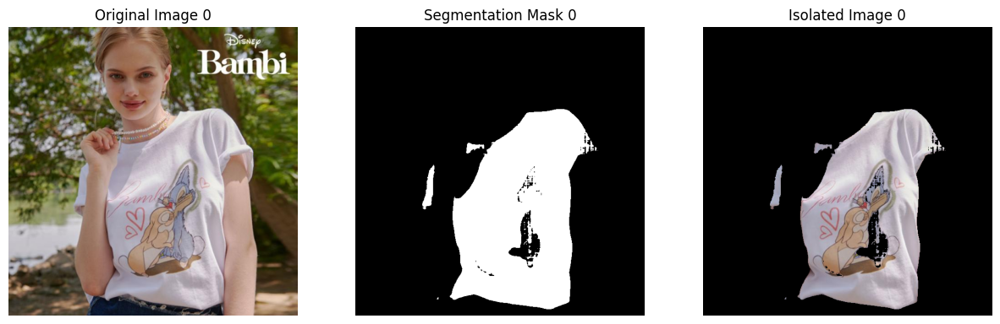


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/37_jpg.rf.c471e5f48320cca9445c5192d723884a.jpg: 640x640 1 hat, 1 dress, 24.7ms
Speed: 1.3ms preprocess, 24.7ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


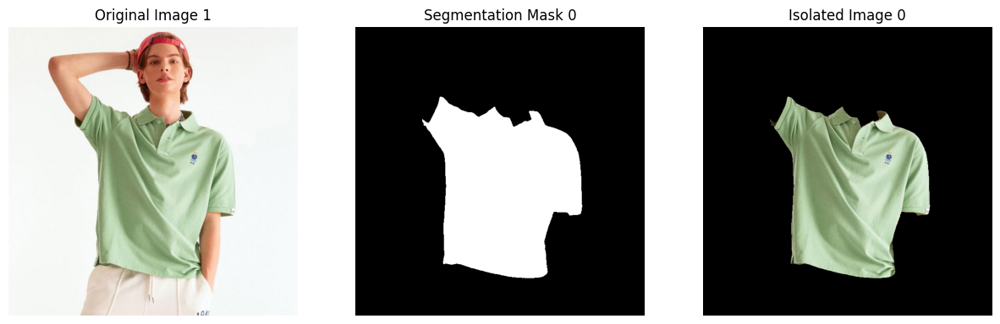

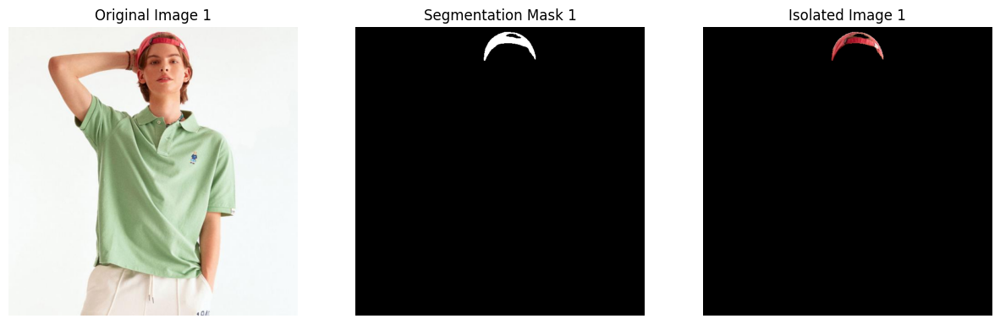


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/78_jpg.rf.247214a20012ccd2682885416f4b43db.jpg: 640x640 1 jacket, 1 shirt, 1 skirt, 2 shoes, 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


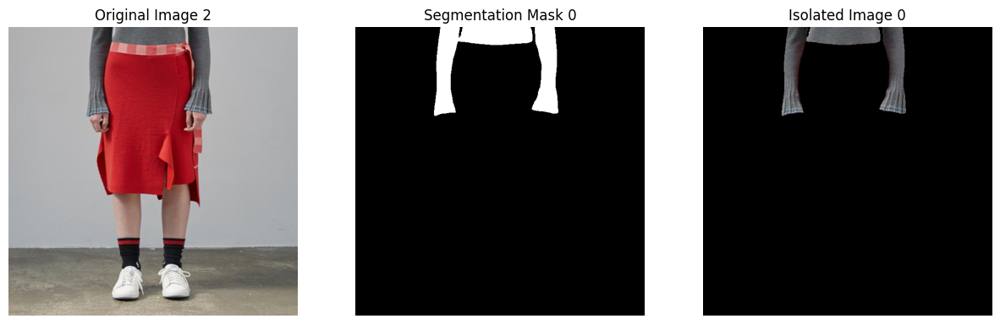

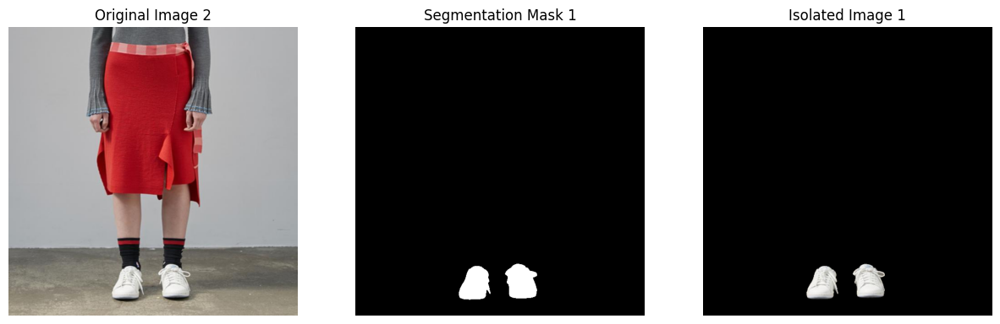

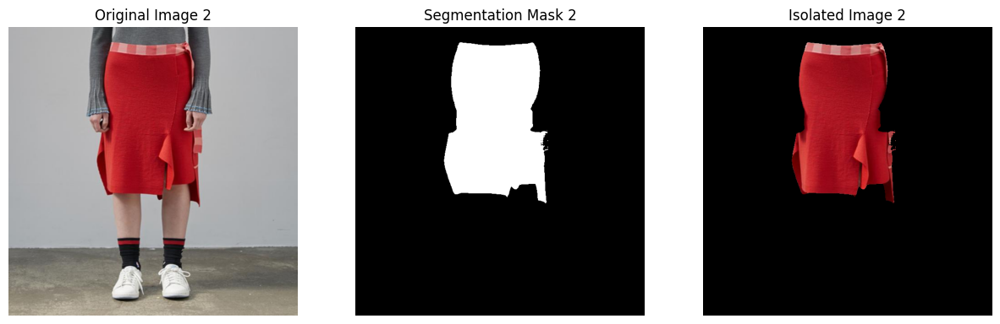

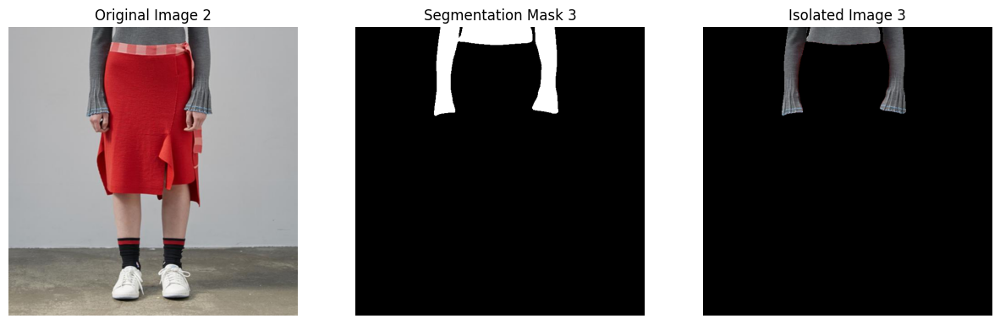


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/20_jpg.rf.37945318b87949b175100744c56f17d5.jpg: 640x640 1 hat, 1 dress, 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


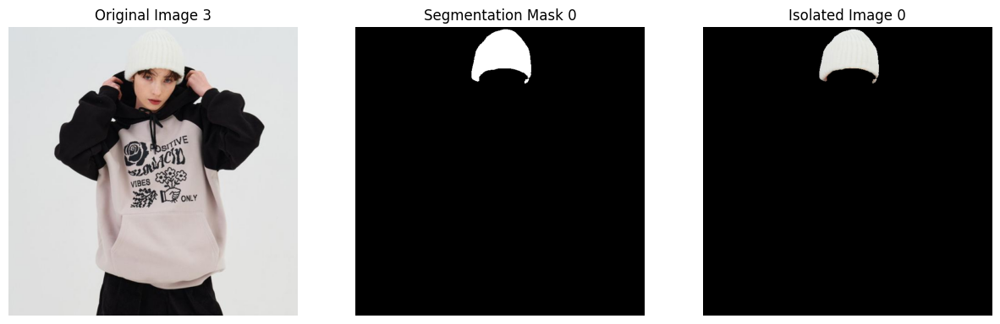

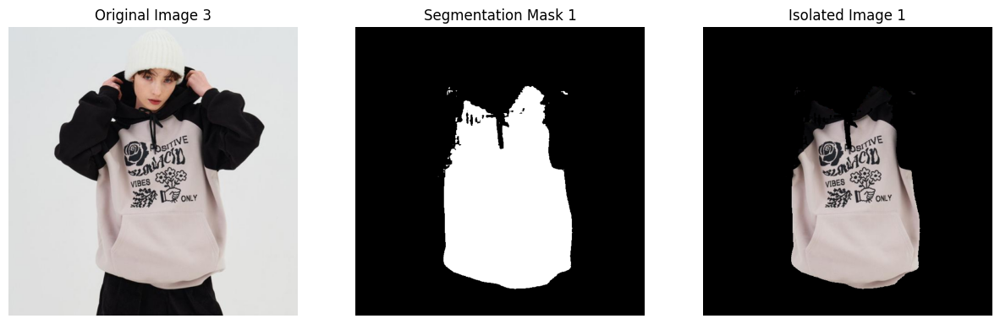


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/37_jpg.rf.f93ef437083a166281a5fa6563afe746.jpg: 640x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)
No valid bounding boxes for /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/37_jpg.rf.f93ef437083a166281a5fa6563afe746.jpg. Skipping SAM processing.

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/8_jpg.rf.db556e7261c11e26a2c9ec83f79a18bb.jpg: 640x640 1 jacket, 1 skirt, 1 dress, 1 shoe, 25.0ms
Speed: 1.3ms preprocess, 25.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


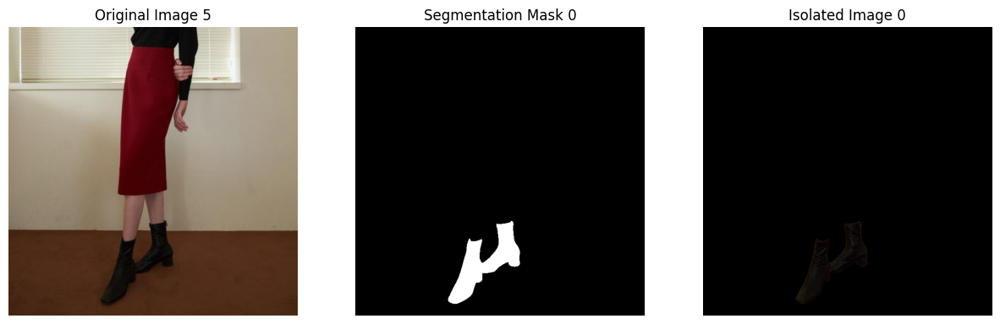

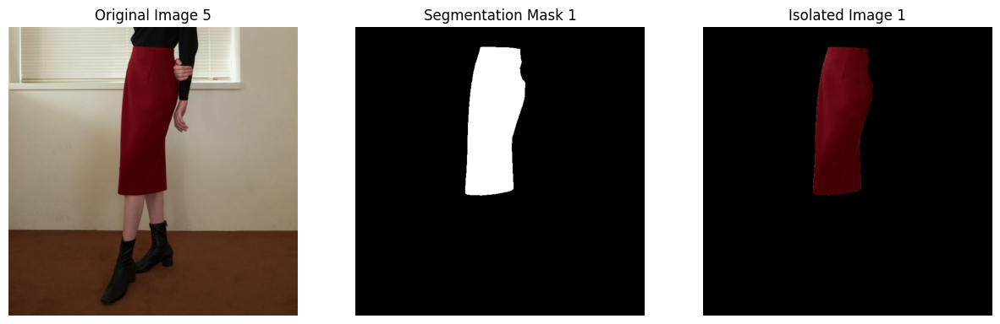

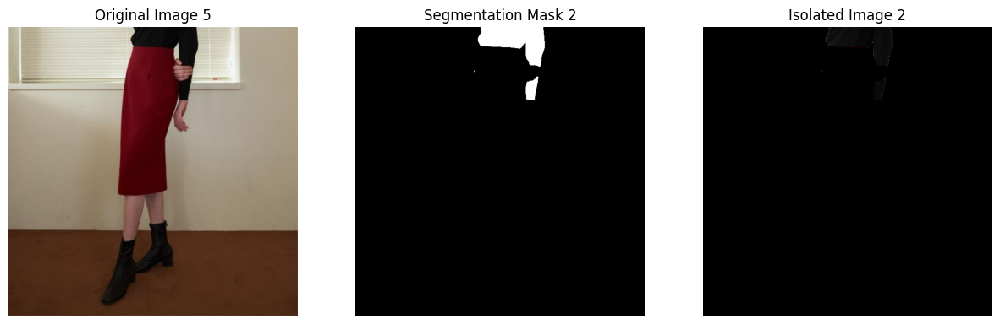

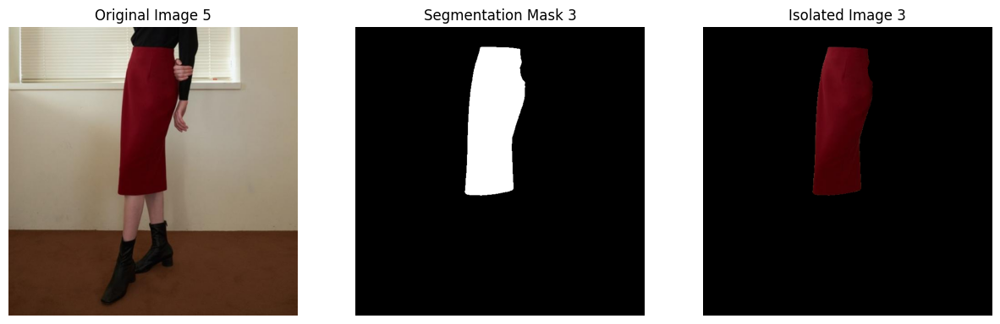


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/1_jpg.rf.df95cb57415d4fbc9f56468e3294cfb7.jpg: 640x640 1 shirt, 1 pants, 1 shoe, 24.5ms
Speed: 1.3ms preprocess, 24.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


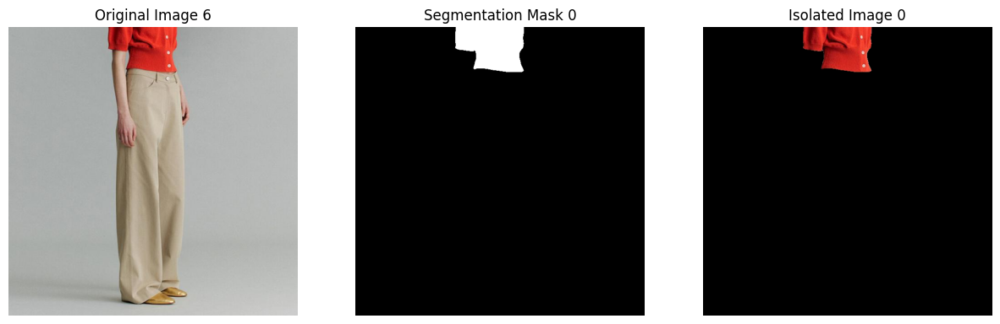

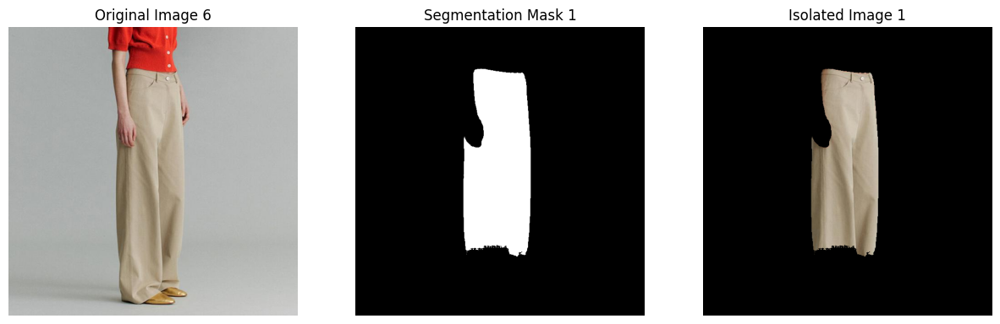

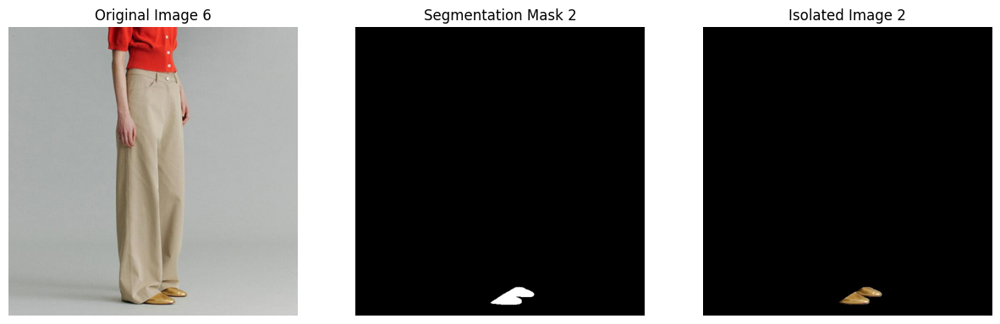


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/15_jpg.rf.571ffb7e97a646d6eceb9696b08b613e.jpg: 640x640 1 sunglass, 1 jacket, 1 dress, 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


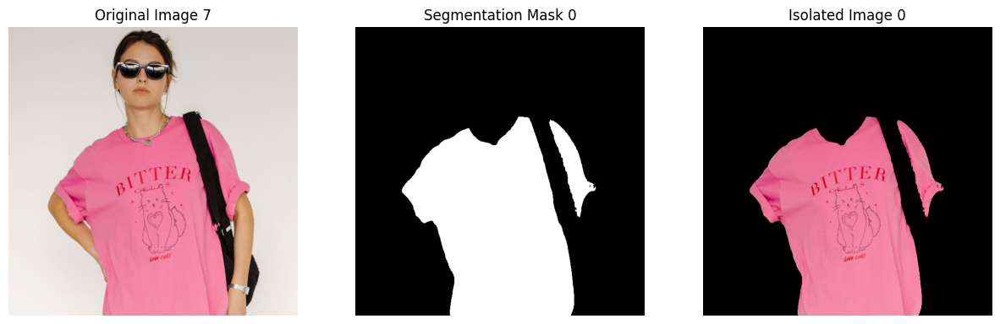

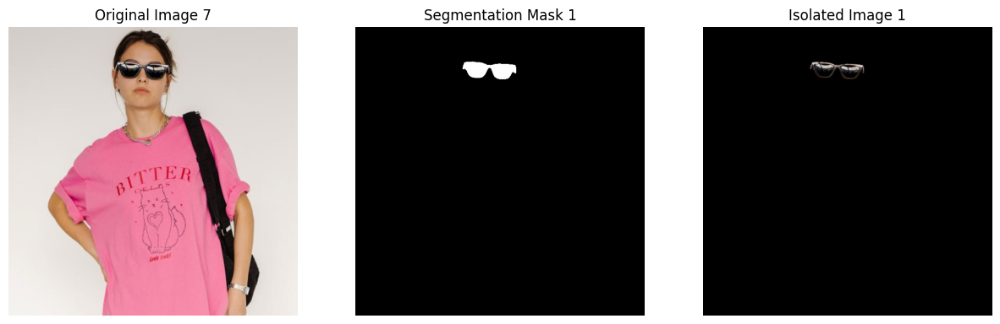

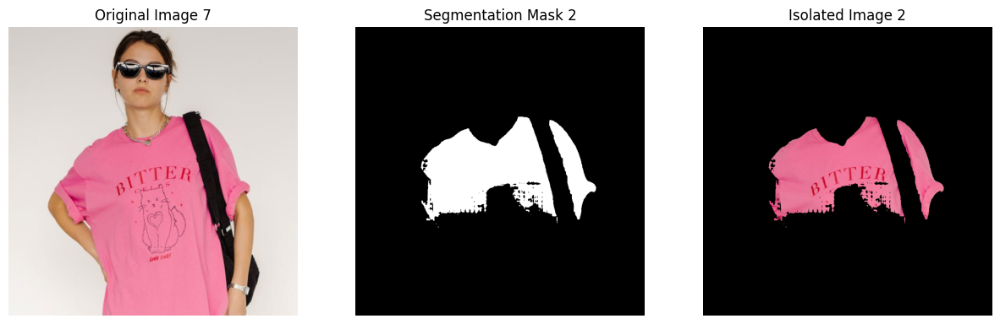


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/14_jpg.rf.57049d62e5cce1ee1b46444a92121cdf.jpg: 640x640 1 pants, 2 shoes, 24.7ms
Speed: 1.3ms preprocess, 24.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


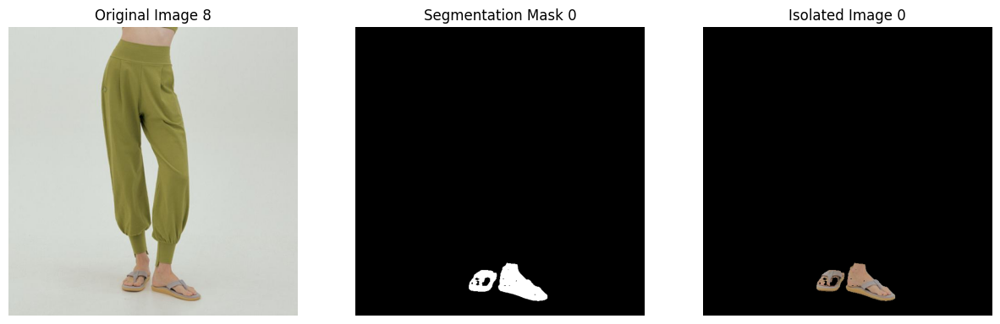

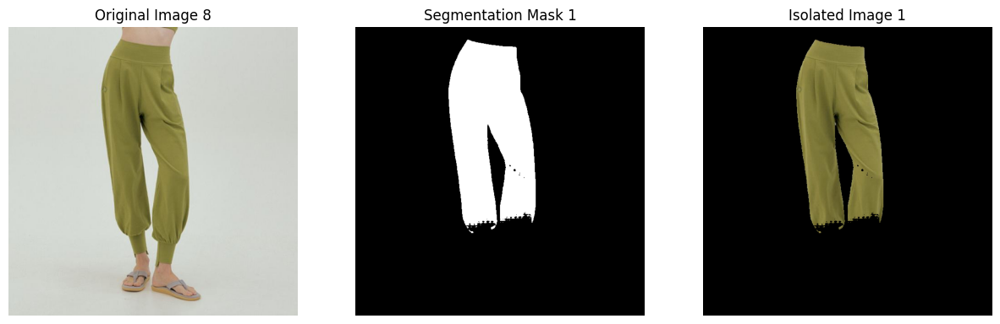


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/67_jpg.rf.909baf623de78b322c3f4eed16054884.jpg: 640x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
No valid bounding boxes for /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/67_jpg.rf.909baf623de78b322c3f4eed16054884.jpg. Skipping SAM processing.

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/69_jpg.rf.945ac63a6ee508eb698472cd8dc4beae.jpg: 640x640 1 dress, 24.5ms
Speed: 1.3ms preprocess, 24.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


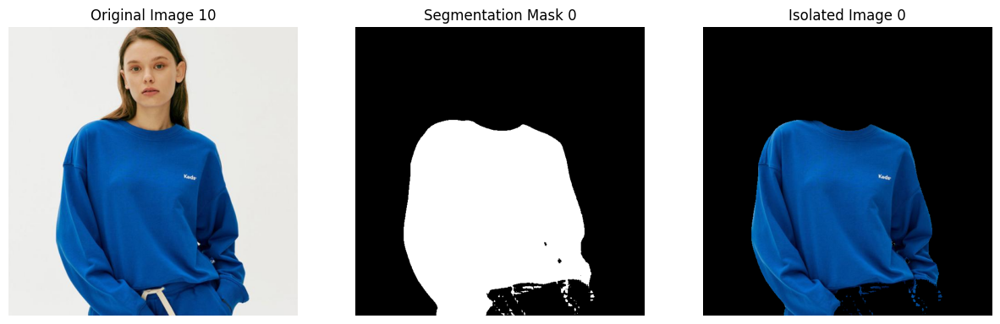


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/12_jpg.rf.a789d0209f1c316164d101ba628fc252.jpg: 640x640 3 dresss, 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


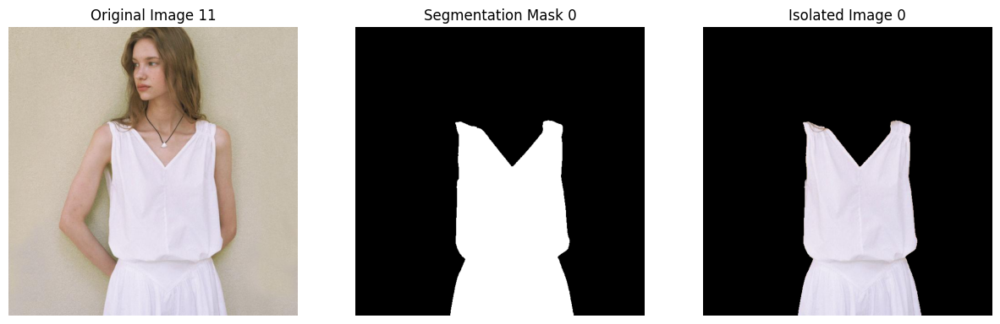


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/63_jpg.rf.0aeb91580ed428edcd57ccba51659b9d.jpg: 640x640 1 dress, 1 shoe, 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


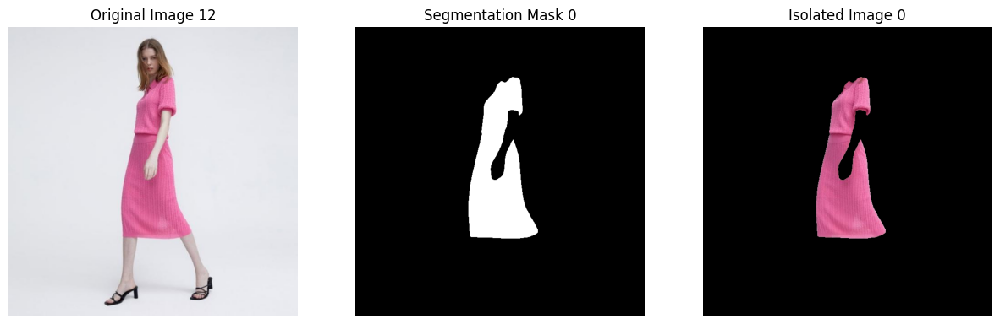

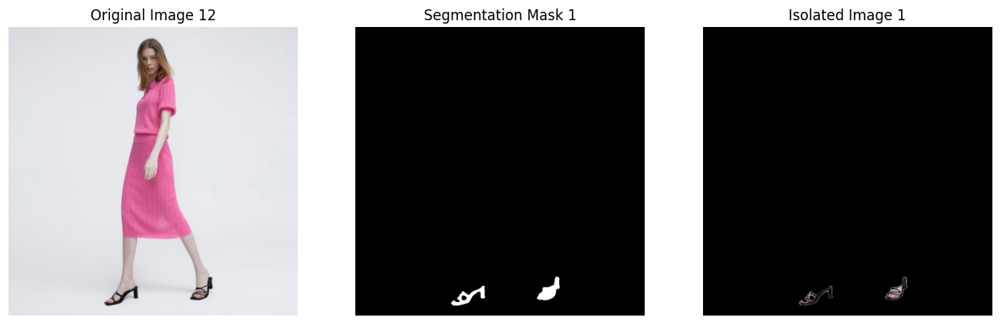


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/8_jpg.rf.e9111f91c2bb8a908268e83f1939c150.jpg: 640x640 1 shirt, 1 pants, 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


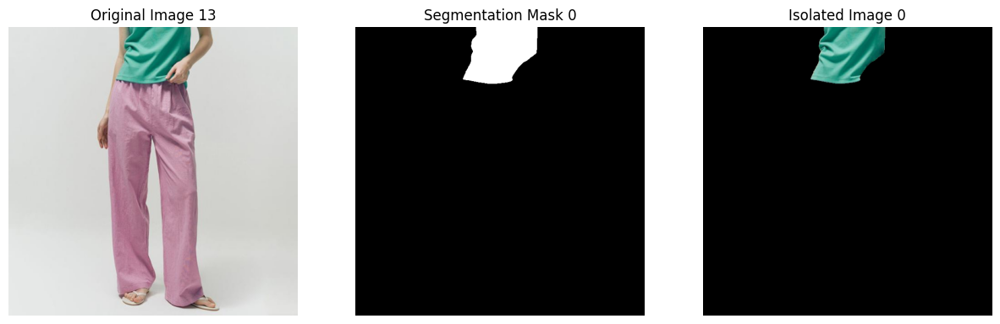

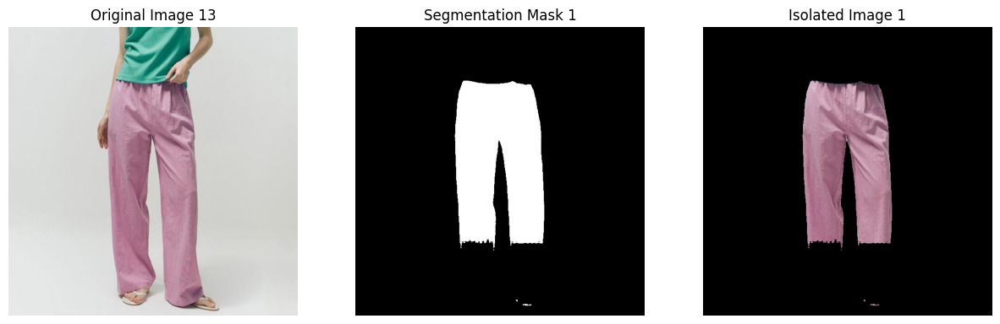


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/5_jpg.rf.431c547c903b4adbaab6bad83900746f.jpg: 640x640 1 hat, 1 jacket, 1 pants, 1 skirt, 24.5ms
Speed: 1.2ms preprocess, 24.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


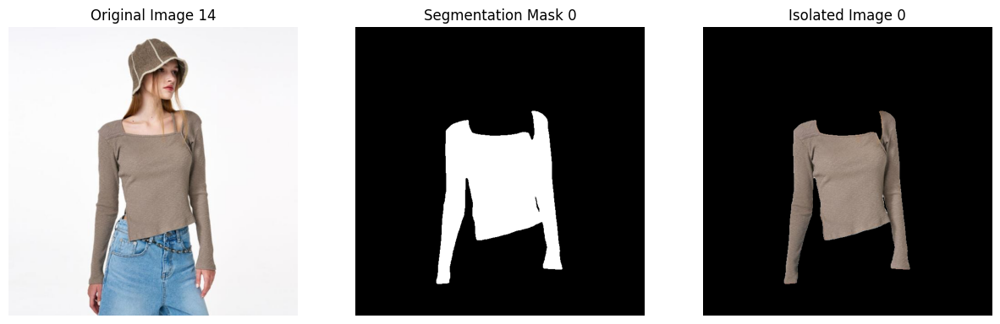

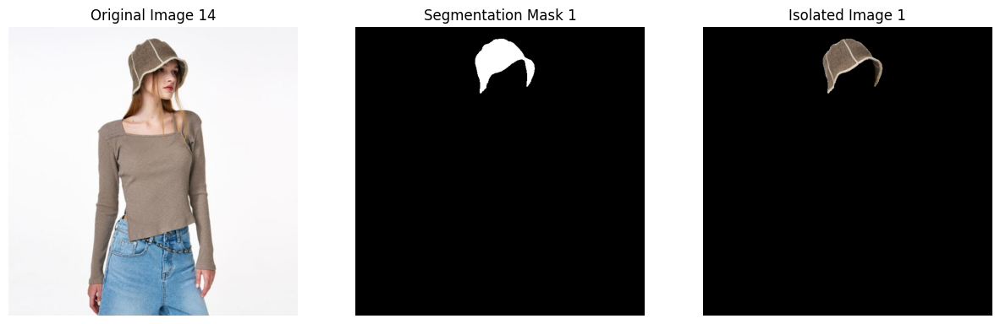

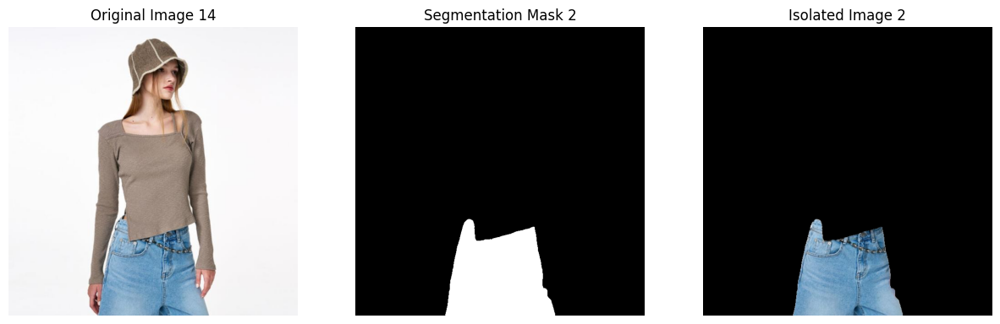

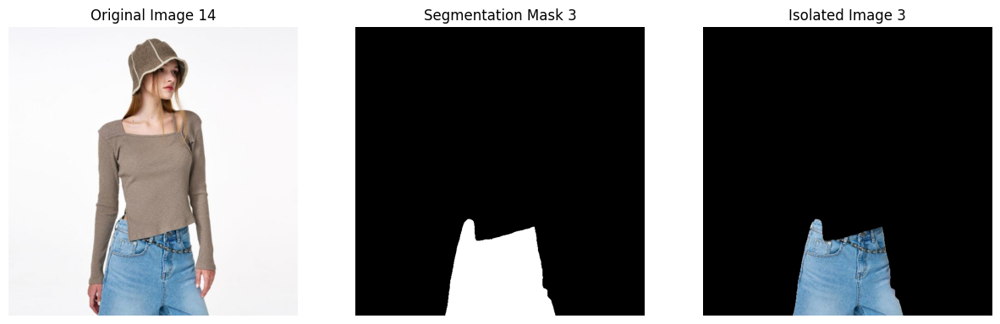


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/100_jpg.rf.059f192a93bc8469abfba64c70c483f6.jpg: 640x640 1 skirt, 1 dress, 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


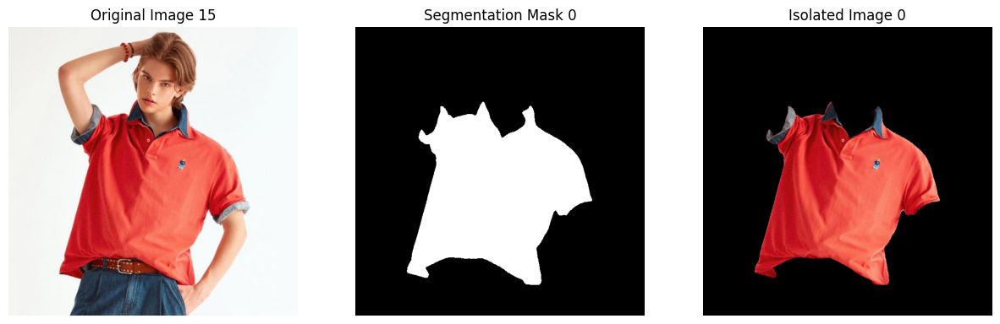

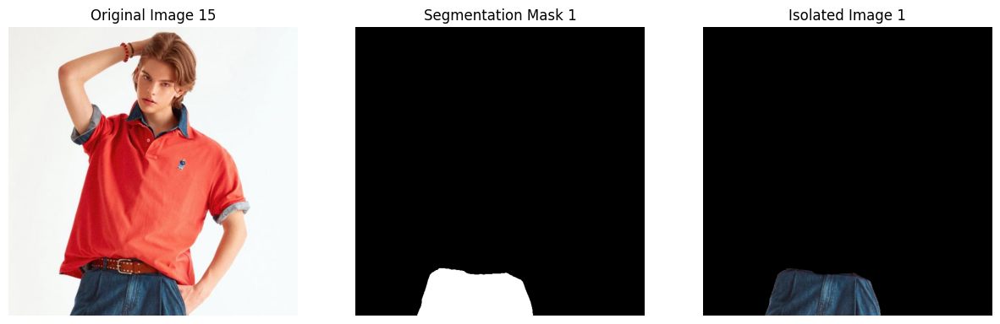


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/73_jpg.rf.df05612a2230d67cf656c143cd732b0a.jpg: 640x640 1 dress, 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


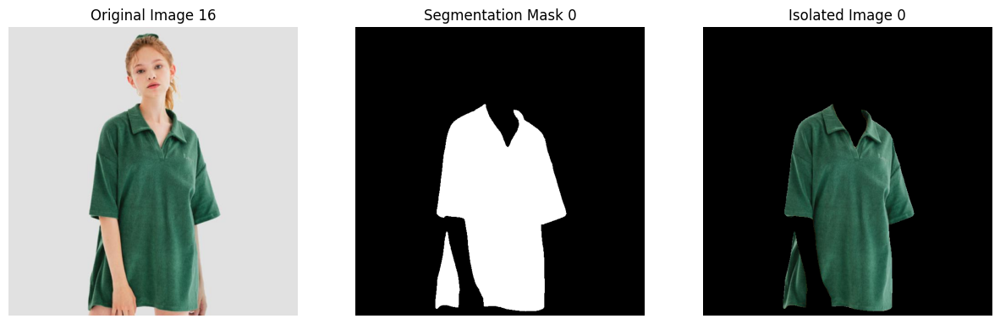

mAP@0.50: 88.24%
Mean Average Precision (mAP@0.5:0.90): 52.94%


In [8]:
import os
import glob
import torch
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamPredictor

# Define the Dataset Class
class FashionProduct(Dataset):
    
    def __init__(self, image_dir, label_dir, transform=None):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.image_filenames = [os.path.basename(img_path) for img_path in glob.glob(os.path.join(self.image_dir, "*.jpg"))]
        self.transform = transform
        
    def __len__(self):
        return len(self.image_filenames)
    
    def __getitem__(self, idx):
        img_name = self.image_filenames[idx]
        img_path = os.path.join(self.image_dir, img_name)
        label_name = img_name.replace('.jpg', '.txt')
        label_path = os.path.join(self.label_dir, label_name)

        with open(label_path, 'r') as f:
            labels = f.readlines()
            
        class_ids = []
        boxes = []
        for label in labels:
            parts = label.strip().split()
            color_id = int(parts[0])
            x_center = float(parts[1])
            y_center = float(parts[2])
            width = float(parts[3])
            height = float(parts[4])
            class_ids.append(int(color_id))
            boxes.append((x_center, y_center, width, height))

        return img_path, class_ids, boxes
    
# Function to convert YOLO format to (xmin, ymin, xmax, ymax)
def yolo_to_corners(x_center, y_center, width, height, img_width, img_height):
    x_min = int((x_center - width / 2) * img_width)
    y_min = int((y_center - height / 2) * img_height)
    x_max = int((x_center + width / 2) * img_width)
    y_max = int((y_center + height / 2) * img_height)
    return x_min, y_min, x_max, y_max

# Function to calculate IoU between two boxes
def calculate_iou(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)

    boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)

    iou = interArea / float(boxAArea + boxBArea - interArea)
    return iou

# Function to remove duplicates (keep the highest confidence for each label)
def remove_duplicates(detected_items):
    unique_items = {}
    for item in detected_items:
        label = item['label']
        if label in unique_items:
            if item['confidence'] > unique_items[label]['confidence']:
                unique_items[label] = item
        else:
            unique_items[label] = item
    return list(unique_items.values())

# Load SAM model
def load_sam_model(sam_model_path):
    sam = sam_model_registry["vit_h"](checkpoint=sam_model_path).to(device=torch.device('cuda:0'))
    mask_predictor = SamPredictor(sam)
    return mask_predictor

# Process and visualize SAM segmentation
def process_with_sam(mask_predictor, img_path, converted_boxes):
    image = Image.open(img_path).convert('RGB')
    image_rgb = np.array(image)
    image_bgr = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2BGR)

    if len(converted_boxes) == 0:
        print(f"No valid bounding boxes for {img_path}. Skipping SAM processing.")
        return image_rgb, []

    predicted_boxes_tensor = torch.tensor(converted_boxes, dtype=torch.float32).to('cuda')
    transformed_boxes = mask_predictor.transform.apply_boxes_torch(predicted_boxes_tensor, image_bgr.shape[:2])

    mask_predictor.set_image(image_bgr)

    try:
        masks, scores, logits = mask_predictor.predict_torch(
            boxes=transformed_boxes.to('cuda'),
            multimask_output=False,
            point_coords=None,
            point_labels=None
        )
    except RuntimeError as e:
        print(f"Error during SAM processing for {img_path}: {e}")
        return image_rgb, []

    # Return the original image, masks, and isolated images
    isolated_images = []
    for mask in masks:
        mask = mask[0].cpu().numpy().astype(np.uint8)
        isolated_image = image_rgb * mask[:, :, np.newaxis]
        isolated_images.append((mask, isolated_image))
    
    return image_rgb, isolated_images

# Example usage
base_path_new = "/home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering"
train_path = os.path.join(base_path_new, "test")
image_dir = os.path.join(train_path, "images")
label_dir = os.path.join(train_path, "labels")

# Load the trained YOLO model
runs_path = os.path.join(base_path_new, 'colorful_fashion_dataset','runs', 'detect')
weights_save_path = os.path.join(runs_path, 'train', 'weights')
best_weights_path = os.path.join(weights_save_path, "best.pt")

# Load SAM model
sam_model_path = os.path.join(base_path_new, "models/sam_vit_h_4b8939.pth")
mask_predictor = load_sam_model(sam_model_path)

# Load the dataset
dataset = FashionProduct(image_dir=image_dir, label_dir=label_dir)

# Variables to calculate mAP
iou_thresholds = np.arange(0.5, 1.0, 0.05)
correct_predictions = {iou_thr: 0 for iou_thr in iou_thresholds}
total_images = 0

# Loop through the dataset and process each image
for idx in range(len(dataset)):
    img_path, class_ids, boxes = dataset[idx]

    # Convert bounding boxes to (xmin, ymin, xmax, ymax)
    img = Image.open(img_path)
    img_width, img_height = img.size
    converted_boxes = [
        yolo_to_corners(x_center, y_center, width, height, img_width, img_height)
        for x_center, y_center, width, height in boxes
    ]
    model = YOLO(best_weights_path)

    # Perform object detection with YOLO
    results = model(img_path)
    detected_items = []
    for result in results:
        boxes = result.boxes
        for box in boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get bounding box coordinates
            confidence = box.conf[0].item()  # Get confidence score
            class_id = int(box.cls[0])  # Get class id
            label = model.names[class_id]  # Get label for class id

            detected_items.append({
                'label': label,
                'coordinates': (x1, y1, x2, y2),
                'confidence': confidence
            })

    # Remove duplicates
    resolved_items = remove_duplicates(detected_items)

    # Extract the final predicted boxes
    final_predicted_boxes = [item['coordinates'] for item in resolved_items]

    # Process the image with SAM and get masks and isolated images
    original_image, isolated_images = process_with_sam(mask_predictor, img_path, final_predicted_boxes)

    # Visualization (optional)
    if len(isolated_images) > 0:  # Only visualize if there are valid masks
        for i, (mask, isolated_image) in enumerate(isolated_images):
            plt.figure(figsize=(15, 5))
            plt.subplot(1, 3, 1)
            plt.imshow(original_image)
            plt.title(f"Original Image {idx}")
            plt.axis('off')

            plt.subplot(1, 3, 2)
            plt.imshow(mask, cmap='gray')
            plt.title(f"Segmentation Mask {i}")
            plt.axis('off')

            plt.subplot(1, 3, 3)
            plt.imshow(isolated_image)
            plt.title(f"Isolated Image {i}")
            plt.axis('off')

            plt.show()

    # Calculate IoU and determine correct prediction for each threshold
    for iou_thr in iou_thresholds:
        is_correct = False
        for pred_box in final_predicted_boxes:
            for gt_box in converted_boxes:
                iou = calculate_iou(pred_box, gt_box)
                if iou >= iou_thr:
                    is_correct = True
                    break
            if is_correct:
                correct_predictions[iou_thr] += 1
                break

    total_images += 1

# Calculate mAP for each IoU threshold
# Calculate mAP for each IoU threshold
map_results = {iou_thr: correct_predictions[iou_thr] / total_images for iou_thr in iou_thresholds}

# Calculate mAP@0.50
map_50 = map_results[0.5]

# Calculate mean AP for the range 0.50:0.90
iou_thresholds_50_to_90 = np.arange(0.5, 0.95, 0.05)
mean_ap_50_to_90 = np.mean([map_results[iou_thr] for iou_thr in iou_thresholds_50_to_90])

# Print mAP@0.50
print(f"mAP@0.50: {map_50 * 100:.2f}%")

# Print Mean Average Precision (mAP) for the range 0.50 to 0.90
print(f"Mean Average Precision (mAP@0.5:0.90): {mean_ap_50_to_90 * 100:.2f}%")

### Use Pipeline for Object Detection with YOLOV8 and Segmentation with SAM and Dominant Color Detection with KMeans


image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/11_jpg.rf.a5888f244e468126b8c969c163c7b63e.jpg: 640x640 1 dress, 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 105.5ms postprocess per image at shape (1, 3, 640, 640)
Cropping complete.
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/11_jpg.rf.a5888f244e468126b8c969c163c7b63e/dress-0.35-0/segmented_cropped.png


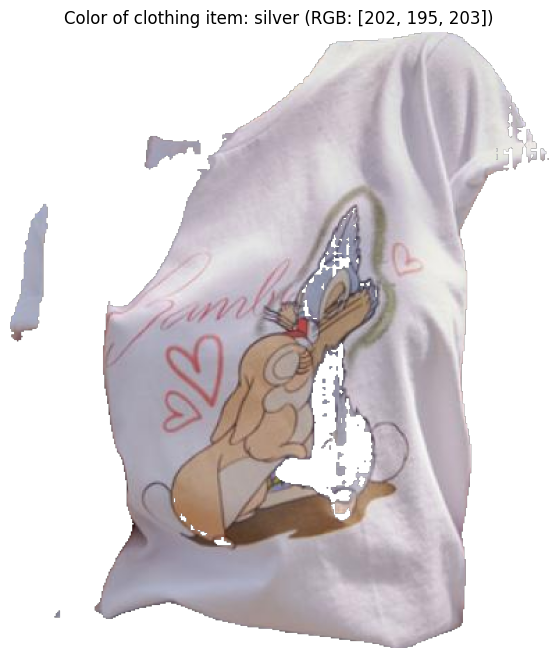

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/11_jpg.rf.a5888f244e468126b8c969c163c7b63e/dress-0.35-0/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/11_jpg.rf.a5888f244e468126b8c969c163c7b63e/dress-0.35-0/color.txt

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/37_jpg.rf.c471e5f48320cca9445c5192d723884a.jpg: 640x640 1 hat, 1 dress, 32.6ms
Speed: 3.1ms preprocess, 32.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Cropping complete.
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/37_jpg.rf.c471e5f48320cca9445c5192d723884a/dress-0.70-0/segmented_cropped.png


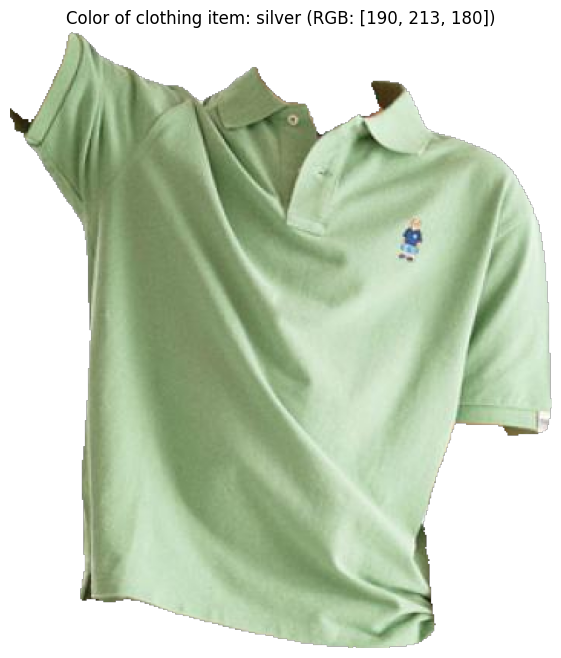

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/37_jpg.rf.c471e5f48320cca9445c5192d723884a/dress-0.70-0/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/37_jpg.rf.c471e5f48320cca9445c5192d723884a/dress-0.70-0/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/37_jpg.rf.c471e5f48320cca9445c5192d723884a/hat-0.32-1/segmented_cropped.png


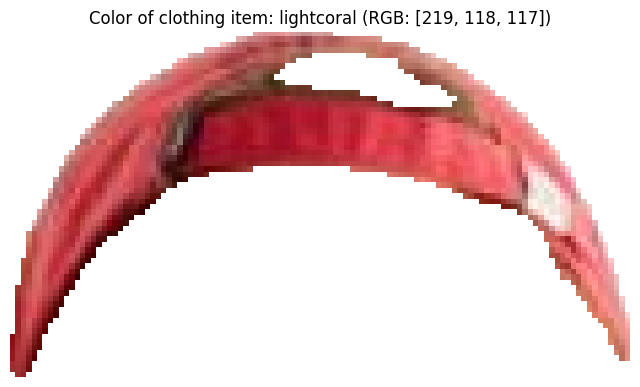

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/37_jpg.rf.c471e5f48320cca9445c5192d723884a/hat-0.32-1/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/37_jpg.rf.c471e5f48320cca9445c5192d723884a/hat-0.32-1/color.txt

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/78_jpg.rf.247214a20012ccd2682885416f4b43db.jpg: 640x640 1 jacket, 1 shirt, 1 skirt, 2 shoes, 28.9ms
Speed: 3.7ms preprocess, 28.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Cropping complete.
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/78_jpg.rf.247214a20012ccd2682885416f4b43db/jacket-0.89-0/segmented_cropped.png


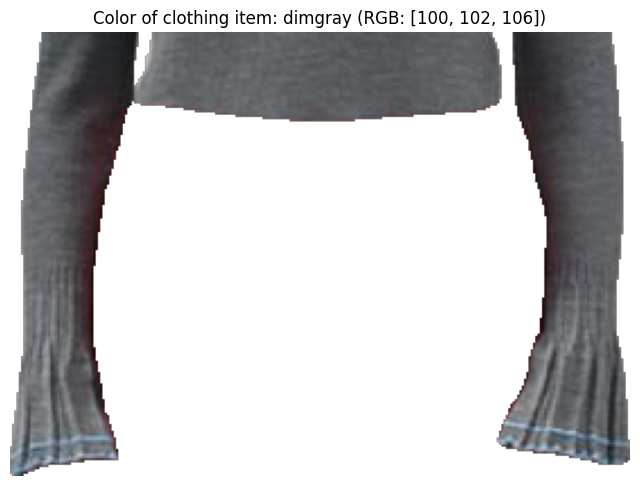

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/78_jpg.rf.247214a20012ccd2682885416f4b43db/jacket-0.89-0/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/78_jpg.rf.247214a20012ccd2682885416f4b43db/jacket-0.89-0/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/78_jpg.rf.247214a20012ccd2682885416f4b43db/shoe-0.79-1/segmented_cropped.png


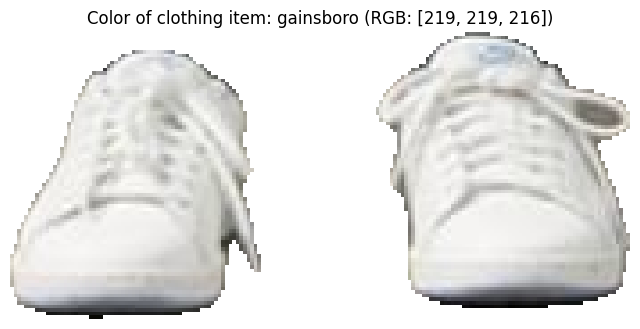

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/78_jpg.rf.247214a20012ccd2682885416f4b43db/shoe-0.79-1/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/78_jpg.rf.247214a20012ccd2682885416f4b43db/shoe-0.79-1/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/78_jpg.rf.247214a20012ccd2682885416f4b43db/skirt-0.75-2/segmented_cropped.png


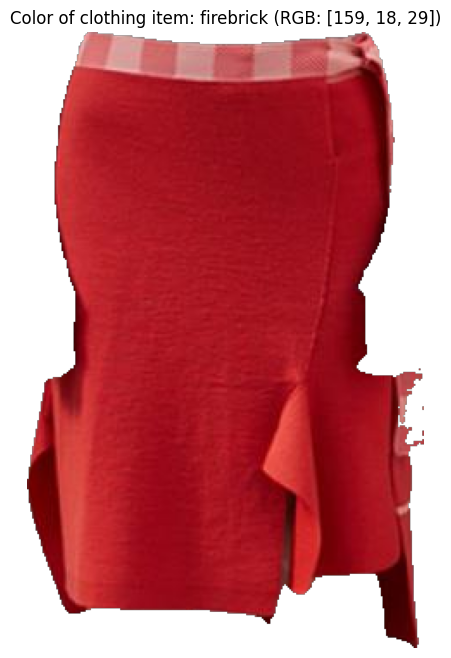

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/78_jpg.rf.247214a20012ccd2682885416f4b43db/skirt-0.75-2/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/78_jpg.rf.247214a20012ccd2682885416f4b43db/skirt-0.75-2/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/78_jpg.rf.247214a20012ccd2682885416f4b43db/shirt-0.40-3/segmented_cropped.png


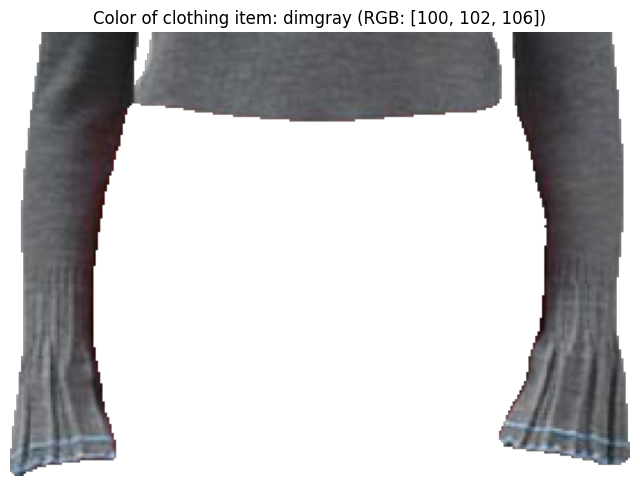

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/78_jpg.rf.247214a20012ccd2682885416f4b43db/shirt-0.40-3/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/78_jpg.rf.247214a20012ccd2682885416f4b43db/shirt-0.40-3/color.txt

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/20_jpg.rf.37945318b87949b175100744c56f17d5.jpg: 640x640 1 hat, 1 dress, 29.6ms
Speed: 3.7ms preprocess, 29.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Cropping complete.
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/20_jpg.rf.37945318b87949b175100744c56f17d5/hat-0.73-0/segmented_cropped.png


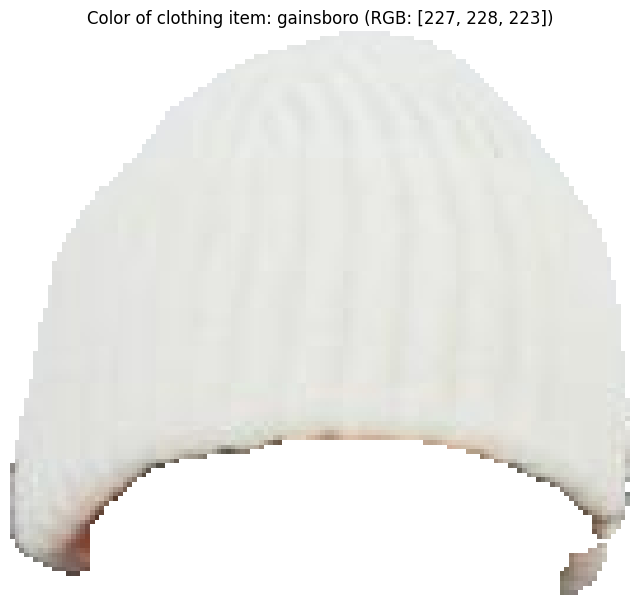

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/20_jpg.rf.37945318b87949b175100744c56f17d5/hat-0.73-0/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/20_jpg.rf.37945318b87949b175100744c56f17d5/hat-0.73-0/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/20_jpg.rf.37945318b87949b175100744c56f17d5/dress-0.48-1/segmented_cropped.png


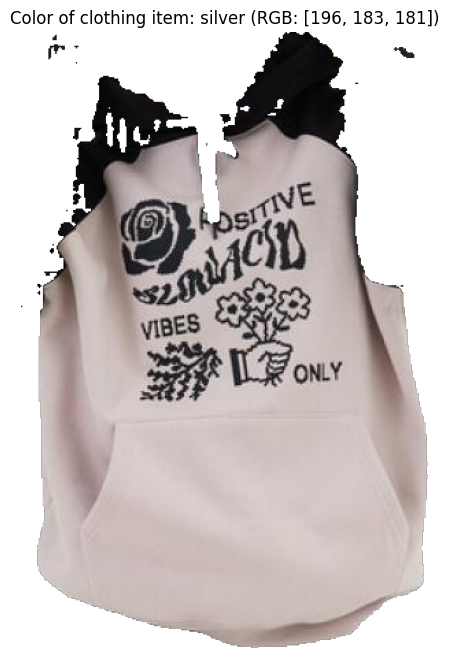

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/20_jpg.rf.37945318b87949b175100744c56f17d5/dress-0.48-1/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/20_jpg.rf.37945318b87949b175100744c56f17d5/dress-0.48-1/color.txt

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/37_jpg.rf.f93ef437083a166281a5fa6563afe746.jpg: 640x640 (no detections), 31.7ms
Speed: 3.3ms preprocess, 31.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
No valid boxes detected for /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/37_jpg.rf.f93ef437083a166281a5fa6563afe746.jpg

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/8_jpg.rf.db556e7261c11e26a2c9ec83f79a18bb.jpg: 640x640 1 jacket, 1 skirt, 1 dress, 1 shoe, 29.5ms
Speed: 1.3ms preprocess, 29.5ms inference, 1.3ms postp

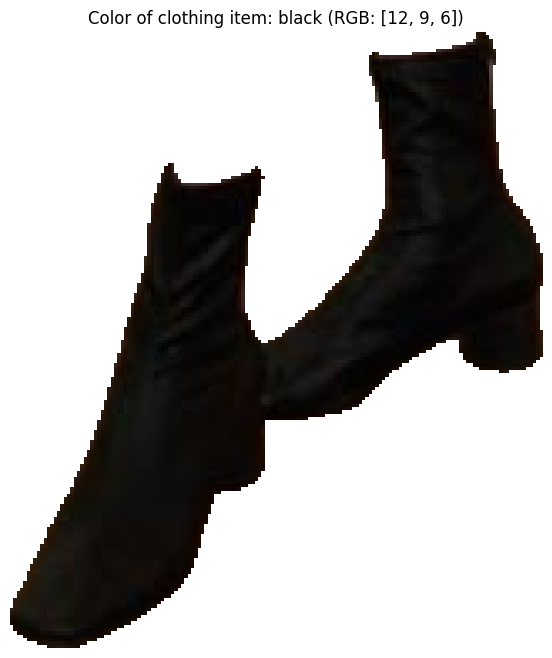

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.db556e7261c11e26a2c9ec83f79a18bb/shoe-0.91-0/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.db556e7261c11e26a2c9ec83f79a18bb/shoe-0.91-0/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.db556e7261c11e26a2c9ec83f79a18bb/skirt-0.54-1/segmented_cropped.png


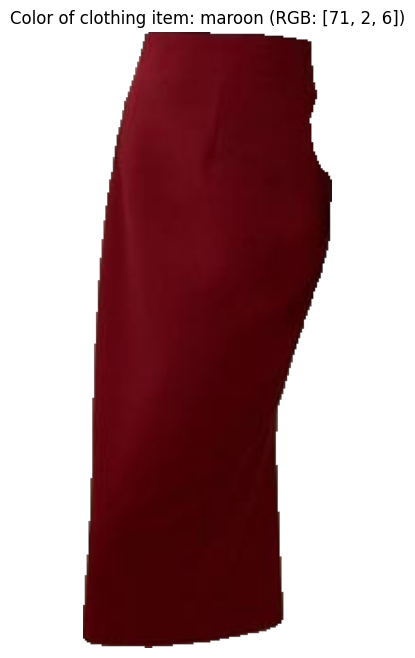

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.db556e7261c11e26a2c9ec83f79a18bb/skirt-0.54-1/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.db556e7261c11e26a2c9ec83f79a18bb/skirt-0.54-1/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.db556e7261c11e26a2c9ec83f79a18bb/jacket-0.54-2/segmented_cropped.png


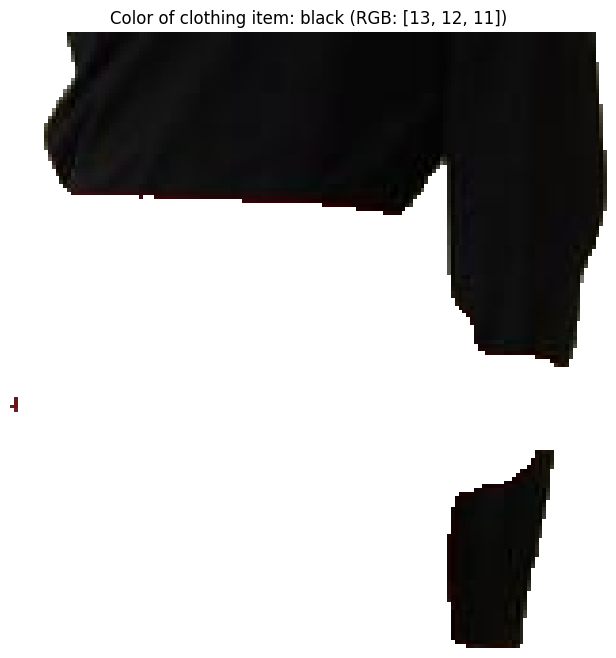

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.db556e7261c11e26a2c9ec83f79a18bb/jacket-0.54-2/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.db556e7261c11e26a2c9ec83f79a18bb/jacket-0.54-2/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.db556e7261c11e26a2c9ec83f79a18bb/dress-0.37-3/segmented_cropped.png


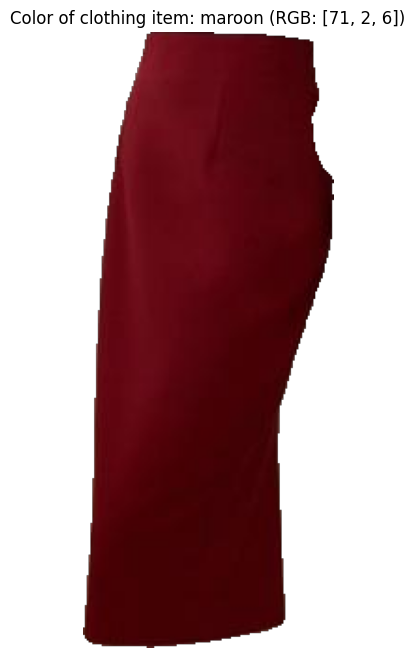

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.db556e7261c11e26a2c9ec83f79a18bb/dress-0.37-3/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.db556e7261c11e26a2c9ec83f79a18bb/dress-0.37-3/color.txt

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/1_jpg.rf.df95cb57415d4fbc9f56468e3294cfb7.jpg: 640x640 1 shirt, 1 pants, 1 shoe, 30.9ms
Speed: 3.6ms preprocess, 30.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Cropping complete.
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/1_jpg.rf.df95cb57415d4fbc9f56468e3294cfb7/shirt-0.83-0/segmented_cropped.png


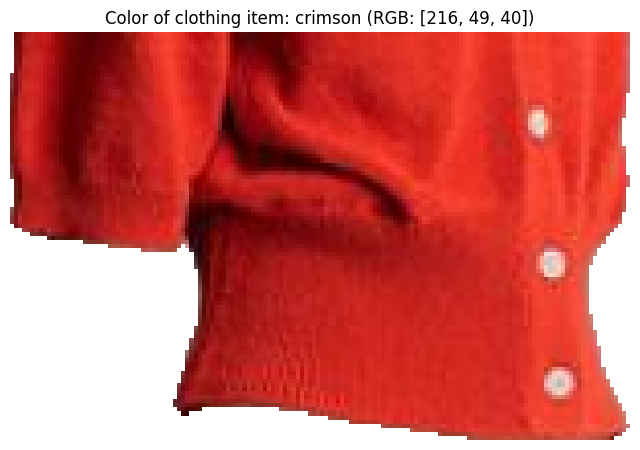

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/1_jpg.rf.df95cb57415d4fbc9f56468e3294cfb7/shirt-0.83-0/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/1_jpg.rf.df95cb57415d4fbc9f56468e3294cfb7/shirt-0.83-0/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/1_jpg.rf.df95cb57415d4fbc9f56468e3294cfb7/pants-0.62-1/segmented_cropped.png


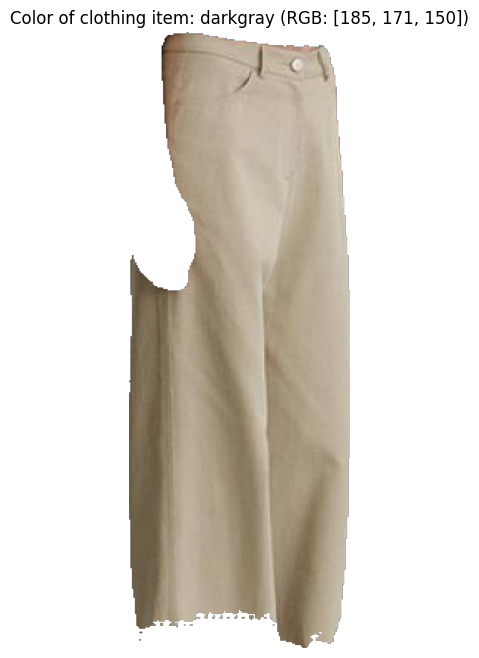

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/1_jpg.rf.df95cb57415d4fbc9f56468e3294cfb7/pants-0.62-1/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/1_jpg.rf.df95cb57415d4fbc9f56468e3294cfb7/pants-0.62-1/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/1_jpg.rf.df95cb57415d4fbc9f56468e3294cfb7/shoe-0.26-2/segmented_cropped.png


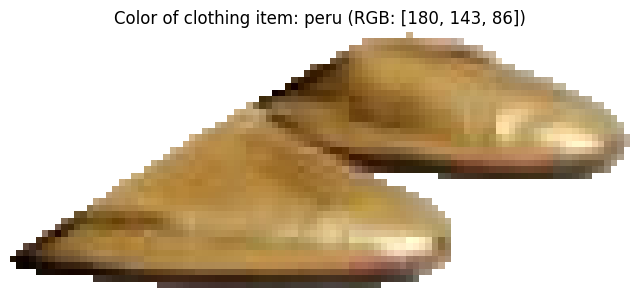

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/1_jpg.rf.df95cb57415d4fbc9f56468e3294cfb7/shoe-0.26-2/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/1_jpg.rf.df95cb57415d4fbc9f56468e3294cfb7/shoe-0.26-2/color.txt

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/15_jpg.rf.571ffb7e97a646d6eceb9696b08b613e.jpg: 640x640 1 sunglass, 1 jacket, 1 dress, 29.1ms
Speed: 2.9ms preprocess, 29.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Cropping complete.
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/15_jpg.rf.571ffb7e97a646d6eceb9696b08b613e/dress-0.69-0/segmented_cropped.png


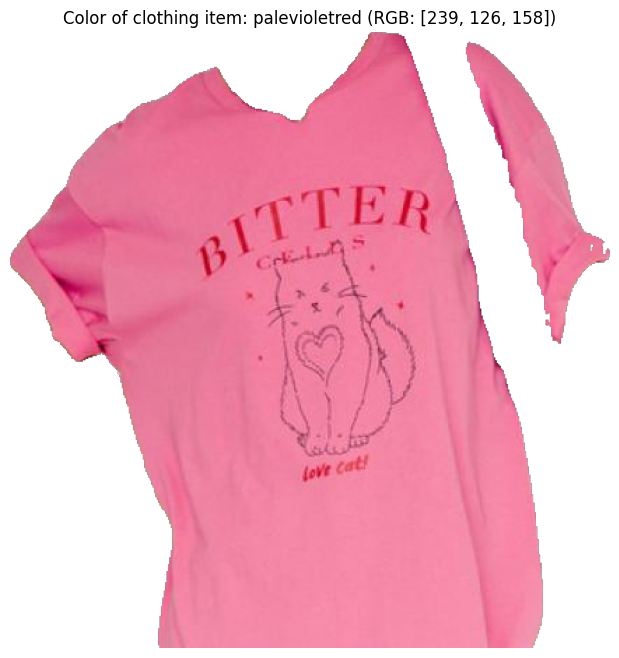

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/15_jpg.rf.571ffb7e97a646d6eceb9696b08b613e/dress-0.69-0/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/15_jpg.rf.571ffb7e97a646d6eceb9696b08b613e/dress-0.69-0/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/15_jpg.rf.571ffb7e97a646d6eceb9696b08b613e/sunglass-0.44-1/segmented_cropped.png


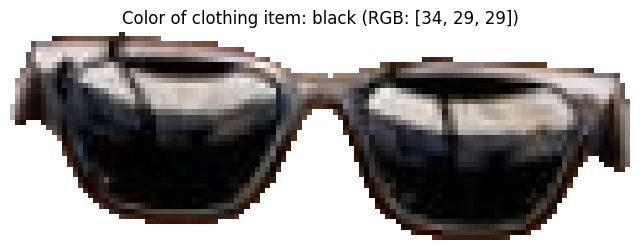

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/15_jpg.rf.571ffb7e97a646d6eceb9696b08b613e/sunglass-0.44-1/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/15_jpg.rf.571ffb7e97a646d6eceb9696b08b613e/sunglass-0.44-1/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/15_jpg.rf.571ffb7e97a646d6eceb9696b08b613e/jacket-0.30-2/segmented_cropped.png


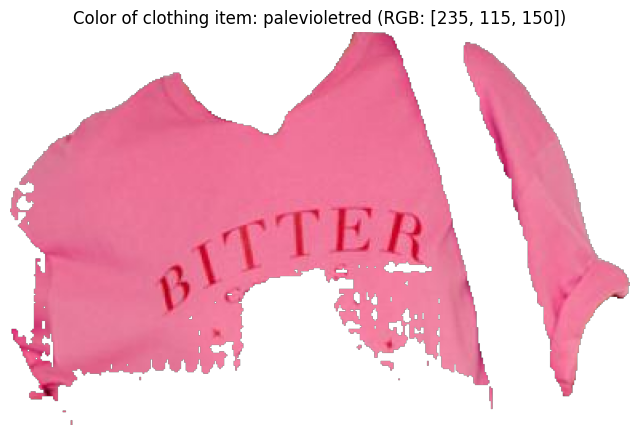

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/15_jpg.rf.571ffb7e97a646d6eceb9696b08b613e/jacket-0.30-2/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/15_jpg.rf.571ffb7e97a646d6eceb9696b08b613e/jacket-0.30-2/color.txt

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/14_jpg.rf.57049d62e5cce1ee1b46444a92121cdf.jpg: 640x640 1 pants, 2 shoes, 29.3ms
Speed: 2.9ms preprocess, 29.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Cropping complete.
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/14_jpg.rf.57049d62e5cce1ee1b46444a92121cdf/shoe-0.78-0/segmented_cropped.png


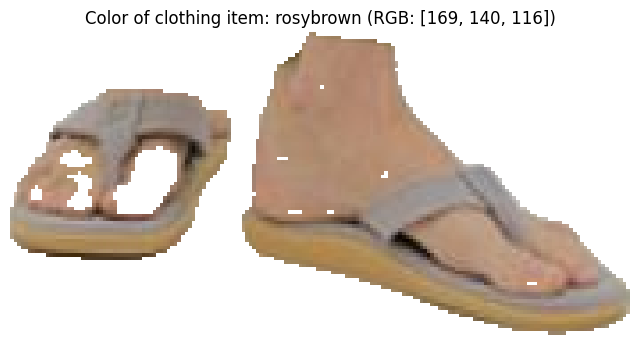

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/14_jpg.rf.57049d62e5cce1ee1b46444a92121cdf/shoe-0.78-0/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/14_jpg.rf.57049d62e5cce1ee1b46444a92121cdf/shoe-0.78-0/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/14_jpg.rf.57049d62e5cce1ee1b46444a92121cdf/pants-0.61-1/segmented_cropped.png


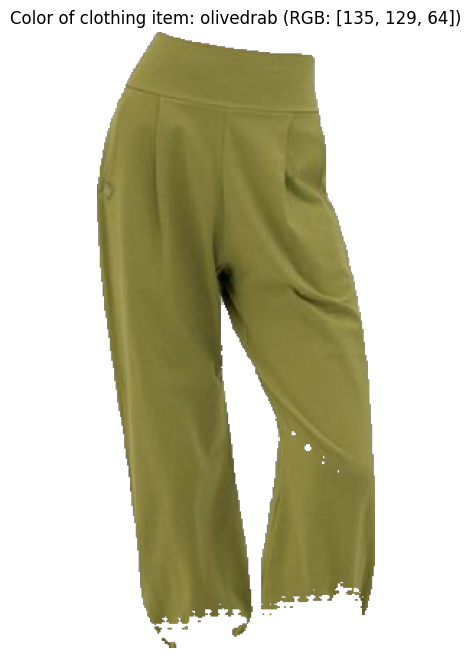

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/14_jpg.rf.57049d62e5cce1ee1b46444a92121cdf/pants-0.61-1/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/14_jpg.rf.57049d62e5cce1ee1b46444a92121cdf/pants-0.61-1/color.txt

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/67_jpg.rf.909baf623de78b322c3f4eed16054884.jpg: 640x640 (no detections), 52.9ms
Speed: 3.2ms preprocess, 52.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
No valid boxes detected for /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/67_jpg.rf.909baf623de78b322c3f4eed16054884.jpg

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/69_jpg.rf.945ac63a6ee508eb698472cd8dc4beae.jpg: 640x640 1 dress, 51.3ms
Speed: 3.0ms preprocess, 51.3ms inference, 1.2ms postprocess per image at shape 

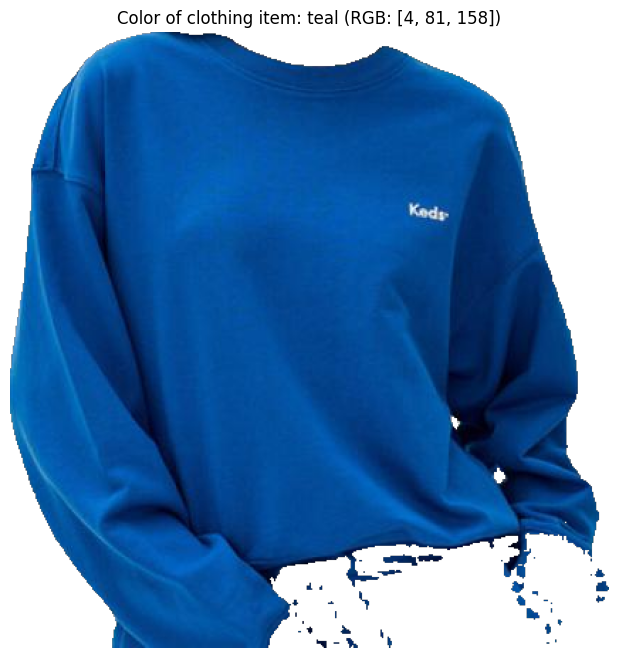

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/69_jpg.rf.945ac63a6ee508eb698472cd8dc4beae/dress-0.73-0/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/69_jpg.rf.945ac63a6ee508eb698472cd8dc4beae/dress-0.73-0/color.txt

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/12_jpg.rf.a789d0209f1c316164d101ba628fc252.jpg: 640x640 3 dresss, 27.7ms
Speed: 3.5ms preprocess, 27.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Cropping complete.
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/12_jpg.rf.a789d0209f1c316164d101ba628fc252/dress-0.78-0/segmented_cropped.png


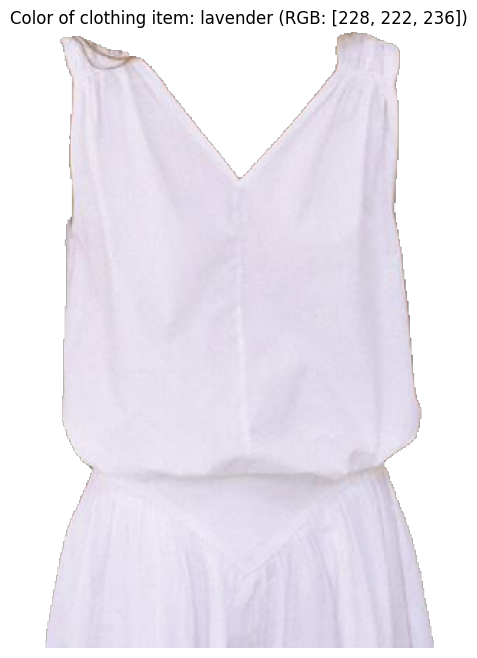

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/12_jpg.rf.a789d0209f1c316164d101ba628fc252/dress-0.78-0/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/12_jpg.rf.a789d0209f1c316164d101ba628fc252/dress-0.78-0/color.txt

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/63_jpg.rf.0aeb91580ed428edcd57ccba51659b9d.jpg: 640x640 1 dress, 1 shoe, 27.5ms
Speed: 3.1ms preprocess, 27.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Cropping complete.
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/63_jpg.rf.0aeb91580ed428edcd57ccba51659b9d/dress-0.90-0/segmented_cropped.png


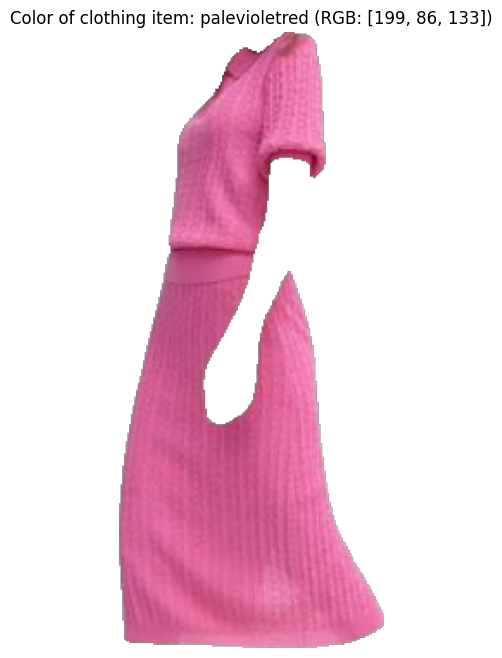

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/63_jpg.rf.0aeb91580ed428edcd57ccba51659b9d/dress-0.90-0/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/63_jpg.rf.0aeb91580ed428edcd57ccba51659b9d/dress-0.90-0/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/63_jpg.rf.0aeb91580ed428edcd57ccba51659b9d/shoe-0.62-1/segmented_cropped.png


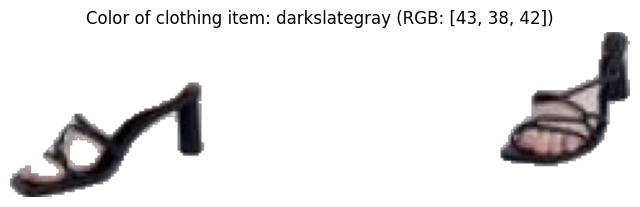

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/63_jpg.rf.0aeb91580ed428edcd57ccba51659b9d/shoe-0.62-1/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/63_jpg.rf.0aeb91580ed428edcd57ccba51659b9d/shoe-0.62-1/color.txt

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/8_jpg.rf.e9111f91c2bb8a908268e83f1939c150.jpg: 640x640 1 shirt, 1 pants, 33.5ms
Speed: 3.5ms preprocess, 33.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Cropping complete.
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.e9111f91c2bb8a908268e83f1939c150/shirt-0.86-0/segmented_cropped.png


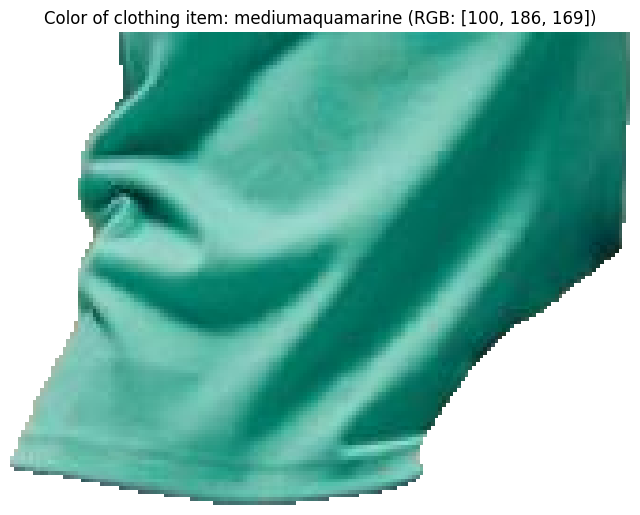

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.e9111f91c2bb8a908268e83f1939c150/shirt-0.86-0/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.e9111f91c2bb8a908268e83f1939c150/shirt-0.86-0/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.e9111f91c2bb8a908268e83f1939c150/pants-0.52-1/segmented_cropped.png


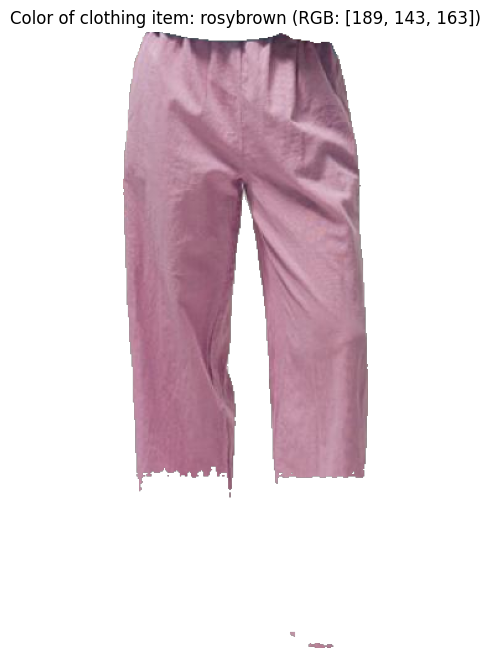

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.e9111f91c2bb8a908268e83f1939c150/pants-0.52-1/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/8_jpg.rf.e9111f91c2bb8a908268e83f1939c150/pants-0.52-1/color.txt

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/5_jpg.rf.431c547c903b4adbaab6bad83900746f.jpg: 640x640 1 hat, 1 jacket, 1 pants, 1 skirt, 34.0ms
Speed: 2.8ms preprocess, 34.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)
Cropping complete.
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/5_jpg.rf.431c547c903b4adbaab6bad83900746f/jacket-0.94-0/segmented_cropped.png


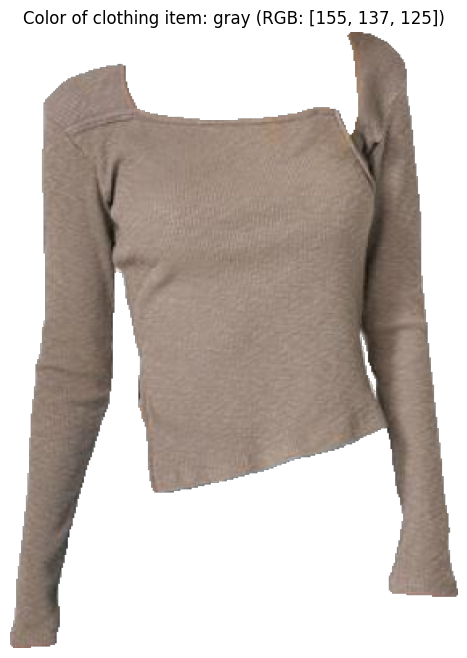

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/5_jpg.rf.431c547c903b4adbaab6bad83900746f/jacket-0.94-0/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/5_jpg.rf.431c547c903b4adbaab6bad83900746f/jacket-0.94-0/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/5_jpg.rf.431c547c903b4adbaab6bad83900746f/hat-0.75-1/segmented_cropped.png


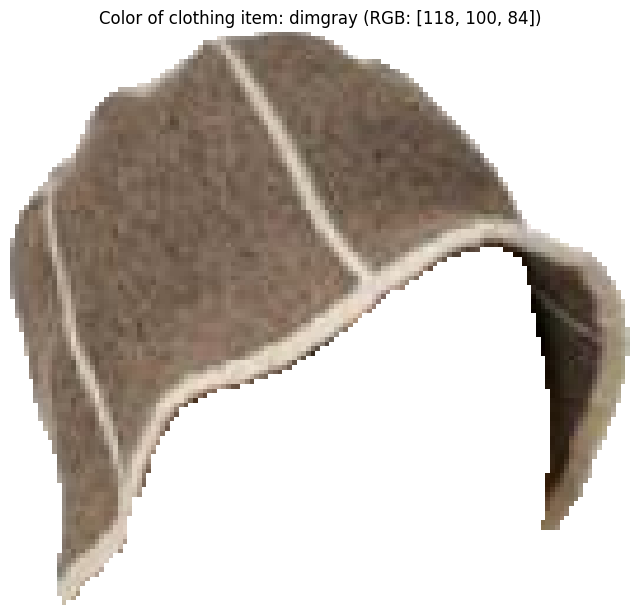

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/5_jpg.rf.431c547c903b4adbaab6bad83900746f/hat-0.75-1/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/5_jpg.rf.431c547c903b4adbaab6bad83900746f/hat-0.75-1/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/5_jpg.rf.431c547c903b4adbaab6bad83900746f/pants-0.59-2/segmented_cropped.png


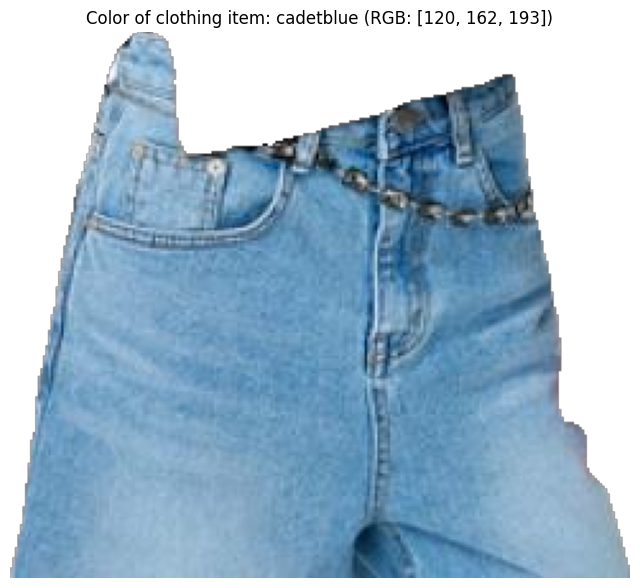

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/5_jpg.rf.431c547c903b4adbaab6bad83900746f/pants-0.59-2/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/5_jpg.rf.431c547c903b4adbaab6bad83900746f/pants-0.59-2/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/5_jpg.rf.431c547c903b4adbaab6bad83900746f/skirt-0.35-3/segmented_cropped.png


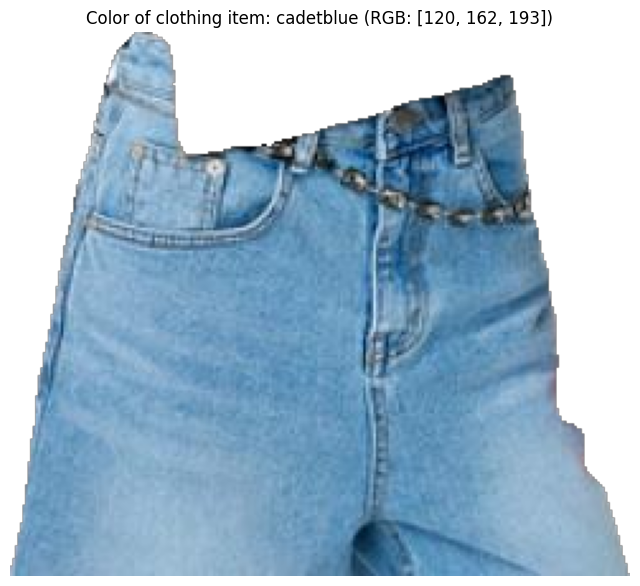

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/5_jpg.rf.431c547c903b4adbaab6bad83900746f/skirt-0.35-3/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/5_jpg.rf.431c547c903b4adbaab6bad83900746f/skirt-0.35-3/color.txt

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/100_jpg.rf.059f192a93bc8469abfba64c70c483f6.jpg: 640x640 1 skirt, 1 dress, 29.7ms
Speed: 2.7ms preprocess, 29.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Cropping complete.
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/100_jpg.rf.059f192a93bc8469abfba64c70c483f6/dress-0.46-0/segmented_cropped.png


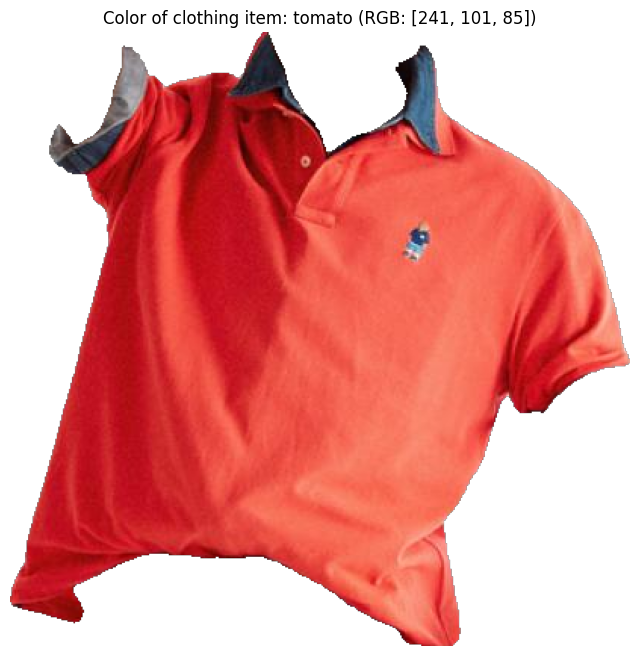

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/100_jpg.rf.059f192a93bc8469abfba64c70c483f6/dress-0.46-0/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/100_jpg.rf.059f192a93bc8469abfba64c70c483f6/dress-0.46-0/color.txt
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/100_jpg.rf.059f192a93bc8469abfba64c70c483f6/skirt-0.26-1/segmented_cropped.png


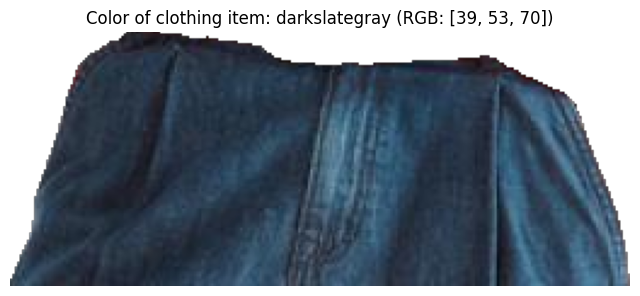

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/100_jpg.rf.059f192a93bc8469abfba64c70c483f6/skirt-0.26-1/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/100_jpg.rf.059f192a93bc8469abfba64c70c483f6/skirt-0.26-1/color.txt

image 1/1 /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/test/images/73_jpg.rf.df05612a2230d67cf656c143cd732b0a.jpg: 640x640 1 dress, 33.0ms
Speed: 2.8ms preprocess, 33.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Cropping complete.
Processing color for segmented cropped image: /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/73_jpg.rf.df05612a2230d67cf656c143cd732b0a/dress-0.84-0/segmented_cropped.png


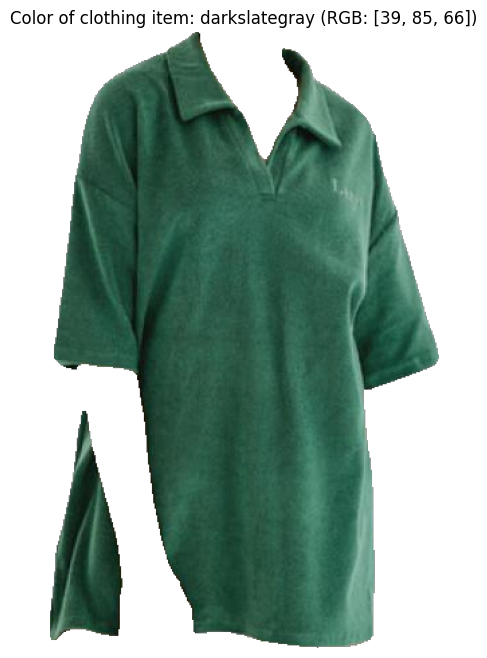

Processed /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/73_jpg.rf.df05612a2230d67cf656c143cd732b0a/dress-0.84-0/segmented_cropped.png -> /home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering/color_detection_kmeans_test/73_jpg.rf.df05612a2230d67cf656c143cd732b0a/dress-0.84-0/color.txt
Segmentation and color detection complete.


In [1]:
import os
import torch
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
from torchvision import transforms
from torch.utils.data import DataLoader, Dataset
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamPredictor
from sklearn.cluster import KMeans
torch.cuda.empty_cache()





# CSS3 colors dictionary
css3_colors = {
    'aliceblue': (240, 248, 255), 'antiquewhite': (250, 235, 215), 'aqua': (0, 255, 255),
    'aquamarine': (127, 255, 212), 'azure': (240, 255, 255), 'beige': (245, 245, 220),
    'bisque': (255, 228, 196), 'black': (0, 0, 0), 'blanchedalmond': (255, 235, 205),
    'blue': (0, 0, 255), 'blueviolet': (138, 43, 226), 'brown': (165, 42, 42),
    'burlywood': (222, 184, 135), 'cadetblue': (95, 158, 160), 'chartreuse': (127, 255, 0),
    'chocolate': (210, 105, 30), 'coral': (255, 127, 80), 'cornflowerblue': (100, 149, 237),
    'cornsilk': (255, 248, 220), 'crimson': (220, 20, 60), 'cyan': (0, 255, 255),
    'darkblue': (0, 0, 139), 'darkcyan': (0, 139, 139), 'darkgoldenrod': (184, 134, 11),
    'darkgray': (169, 169, 169), 'darkgreen': (0, 100, 0), 'darkkhaki': (189, 183, 107),
    'darkmagenta': (139, 0, 139), 'darkolivegreen': (85, 107, 47), 'darkorange': (255, 140, 0),
    'darkorchid': (153, 50, 204), 'darkred': (139, 0, 0), 'darksalmon': (233, 150, 122),
    'darkseagreen': (143, 188, 143), 'darkslateblue': (72, 61, 139), 'darkslategray': (47, 79, 79),
    'darkturquoise': (0, 206, 209), 'darkviolet': (148, 0, 211), 'deeppink': (255, 20, 147),
    'deepskyblue': (0, 191, 255), 'dimgray': (105, 105, 105), 'dodgerblue': (30, 144, 255),
    'firebrick': (178, 34, 34), 'floralwhite': (255, 250, 240), 'forestgreen': (34, 139, 34),
    'fuchsia': (255, 0, 255), 'gainsboro': (220, 220, 220), 'ghostwhite': (248, 248, 255),
    'gold': (255, 215, 0), 'goldenrod': (218, 165, 32), 'gray': (128, 128, 128),
    'green': (0, 128, 0), 'greenyellow': (173, 255, 47), 'honeydew': (240, 255, 240),
    'hotpink': (255, 105, 180), 'indianred': (205, 92, 92), 'indigo': (75, 0, 130),
    'ivory': (255, 255, 240), 'khaki': (240, 230, 140), 'lavender': (230, 230, 250),
    'lavenderblush': (255, 240, 245), 'lawngreen': (124, 252, 0), 'lemonchiffon': (255, 250, 205),
    'lightblue': (173, 216, 230), 'lightcoral': (240, 128, 128), 'lightcyan': (224, 255, 255),
    'lightgoldenrodyellow': (250, 250, 210), 'lightgreen': (144, 238, 144), 'lightgrey': (211, 211, 211),
    'lightpink': (255, 182, 193), 'lightsalmon': (255, 160, 122), 'lightseagreen': (32, 178, 170),
    'lightskyblue': (135, 206, 250), 'lightslategray': (119, 136, 153), 'lightsteelblue': (176, 196, 222),
    'lightyellow': (255, 255, 224), 'lime': (0, 255, 0), 'limegreen': (50, 205, 50),
    'linen': (250, 240, 230), 'magenta': (255, 0, 255), 'maroon': (128, 0, 0),
    'mediumaquamarine': (102, 205, 170), 'mediumblue': (0, 0, 205), 'mediumorchid': (186, 85, 211),
    'mediumpurple': (147, 112, 219), 'mediumseagreen': (60, 179, 113), 'mediumslateblue': (123, 104, 238),
    'mediumspringgreen': (0, 250, 154), 'mediumturquoise': (72, 209, 204), 'mediumvioletred': (199, 21, 133),
    'midnightblue': (25, 25, 112), 'mintcream': (245, 255, 250), 'mistyrose': (255, 228, 225),
    'moccasin': (255, 228, 181), 'navajowhite': (255, 222, 173), 'navy': (0, 0, 128),
    'oldlace': (253, 245, 230), 'olive': (128, 128, 0), 'olivedrab': (107, 142, 35),
    'orange': (255, 165, 0), 'orangered': (255, 69, 0), 'orchid': (218, 112, 214),
    'palegoldenrod': (238, 232, 170), 'palegreen': (152, 251, 152), 'paleturquoise': (175, 238, 238),
    'palevioletred': (219, 112, 147), 'papayawhip': (255, 239, 213), 'peachpuff': (255, 218, 185),
    'peru': (205, 133, 63), 'pink': (255, 192, 203), 'plum': (221, 160, 221),
    'powderblue': (176, 224, 230), 'purple': (128, 0, 128), 'rebeccapurple': (102, 51, 153),
    'red': (255, 0, 0), 'rosybrown': (188, 143, 143), 'royalblue': (65, 105, 225),
    'saddlebrown': (139, 69, 19), 'salmon': (250, 128, 114), 'sandybrown': (244, 164, 96),
    'seagreen': (46, 139, 87), 'seashell': (255, 245, 238), 'sienna': (160, 82, 45),
    'silver': (192, 192, 192), 'skyblue': (135, 206, 235), 'slateblue': (106, 90, 205),
    'slategray': (112, 128, 144), 'snow': (255, 250, 250), 'springgreen': (0, 255, 127),
    'steelblue': (70, 130, 180), 'tan': (210, 180, 140), 'teal': (0, 128, 128),
    'thistle': (216, 191, 216), 'tomato': (255, 99, 71), 'turquoise': (64, 224, 208),
    'violet': (238, 130, 238), 'wheat': (245, 222, 179), 'white': (255, 255, 255),
    'whitesmoke': (245, 245, 245), 'yellow': (255, 255, 0), 'yellowgreen': (154, 205, 50)
}


def closest_color(requested_color):
    min_diff = float('inf')
    closest_color_name = None
    for color_name, rgb in css3_colors.items():
        diff = np.sqrt(np.sum((np.array(rgb) - np.array(requested_color)) ** 2))
        if diff < min_diff:
            min_diff = diff
            closest_color_name = color_name
    return closest_color_name

def kmeans_clustering(image, n_clusters=2):
    pixels = image.reshape(-1, 4)
    pixels = pixels[pixels[:, 3] > 0]
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(pixels[:, :3])
    cluster_centers = kmeans.cluster_centers_
    cluster_centers = (cluster_centers * 255).astype(int)
    labels = kmeans.labels_
    return cluster_centers, labels

def process_segmented_patch(image):
    cluster_centers, labels = kmeans_clustering(image)
    labels = labels.flatten()
    counts = np.bincount(labels.astype(int))

    total_pixels = len(labels)
    percentages = (counts / total_pixels) * 100

    max_count_idx = np.argmax(percentages)
    dominant_color = cluster_centers[max_count_idx]
    dominant_color_name = closest_color(dominant_color[:3])

    return dominant_color_name, percentages, cluster_centers, counts, dominant_color

class FashionDataset(Dataset):
    def __init__(self, image_paths, transform=None):
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        image = Image.open(image_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image_path, image

def remove_duplicates(detected_items):
    unique_items = {}
    for item in detected_items:
        label = item['label']
        if label in unique_items:
            if item['confidence'] > unique_items[label]['confidence']:
                unique_items[label] = item
        else:
            unique_items[label] = item
    return list(unique_items.values())

def detect_and_segment_batch(base_path, image_paths, yolo_weights_path, sam_model_path, batch_size=4):
    sam = sam_model_registry["vit_h"](checkpoint=sam_model_path).to(device=torch.device('cuda:0'))
    mask_predictor = SamPredictor(sam)
    model = YOLO(yolo_weights_path)
    transform = transforms.Compose([transforms.ToTensor()])

    dataset = FashionDataset(image_paths, transform=transform)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

    for batch in dataloader:
        image_paths_batch, images_batch = batch
        images_batch = images_batch.to('cuda')

        for i, image in enumerate(images_batch):
            sample_image_path = image_paths_batch[i]
            image_name = os.path.splitext(os.path.basename(sample_image_path))[0]
            image_dir = os.path.join(base_path, f"color_detection_kmeans_test/{image_name}")
            os.makedirs(image_dir, exist_ok=True)

            # Perform object detection with YOLO
            results = model(sample_image_path)
            image_pil = transforms.ToPILImage()(image.cpu())
            image_rgb = np.array(image_pil)
            image_bgr = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2BGR)

            # Collect detected items
            detected_items = []
            for result in results:
                boxes = result.boxes
                for box in boxes:
                    x1, y1, x2, y2 = map(int, box.xyxy[0])
                    confidence = box.conf[0].item()
                    class_id = int(box.cls[0])
                    label = model.names[class_id]

                    detected_items.append({
                        'label': label,
                        'coordinates': (x1, y1, x2, y2),
                        'confidence': confidence
                    })

            # Remove duplicates (keep the highest confidence for each label)
            resolved_items = remove_duplicates(detected_items)

            crop_counter = 0
            predicted_boxes = []
            crop_dirs = []
            for item in resolved_items:
                x1, y1, x2, y2 = item['coordinates']
                confidence = item['confidence']
                label = item['label']

                cropped_dir = os.path.join(image_dir, f"{label}-{confidence:.2f}-{crop_counter}")
                os.makedirs(cropped_dir, exist_ok=True)
                crop_dirs.append(cropped_dir)

                original_filename = os.path.join(cropped_dir, "original.jpg")
                image_pil.save(original_filename)

                draw = ImageDraw.Draw(image_pil)
                draw.rectangle([x1, y1, x2, y2], outline="green", width=2)
                draw.text((x1, y1 - 10), f"{label} {confidence:.2f}", fill="green", font=ImageFont.load_default())

                cropped_filename = os.path.join(cropped_dir, "cropped.jpg")
                cropped_image = image_pil.crop((x1, y1, x2, y2))
                cropped_image.save(cropped_filename)
                predicted_boxes.append([x1, y1, x2, y2])
                crop_counter += 1

            if not predicted_boxes:  # Skip processing if no boxes are predicted
                print(f"No valid boxes detected for {sample_image_path}")
                continue

            print("Cropping complete.")
            predicted_boxes_tensor = torch.tensor(predicted_boxes, dtype=torch.float32).to('cuda')
            transformed_boxes = mask_predictor.transform.apply_boxes_torch(predicted_boxes_tensor, image_bgr.shape[:2])

            mask_predictor.set_image(image_bgr)

            try:
                masks, scores, logits = mask_predictor.predict_torch(
                    boxes=transformed_boxes.to('cuda'),
                    multimask_output=False,
                    point_coords=None,
                    point_labels=None
                )
            except RuntimeError as e:
                print(f"Error during SAM processing for {sample_image_path}: {e}")
                continue

            for j, mask in enumerate(masks):
                mask = mask[0].cpu().numpy().astype(np.uint8)
                mask_image = Image.fromarray(mask * 255)
                mask_filename = os.path.join(crop_dirs[j], "mask.png")
                mask_image.save(mask_filename)

                isolated_image = image_rgb * mask[:, :, np.newaxis]
                isolated_image_pil = Image.fromarray(isolated_image)
                isolated_filename = os.path.join(crop_dirs[j], "isolated.png")
                isolated_image_pil.save(isolated_filename)

                coords = np.column_stack(np.where(mask > 0))
                if coords.size == 0:
                    print(f"No object found for mask {j}")
                    continue
                y1, x1 = coords.min(axis=0)
                y2, x2 = coords.max(axis=0)

                isolated_cropped_image = isolated_image[y1:y2+1, x1:x2+1]
                isolated_cropped_image_rgba = np.zeros((y2 - y1 + 1, x2 - x1 + 1, 4), dtype=np.uint8)
                isolated_cropped_image_rgba[..., :3] = isolated_cropped_image
                isolated_cropped_image_rgba[..., 3] = mask[y1:y2+1, x1:x2+1] * 255

                segmented_cropped_filename = os.path.join(crop_dirs[j], "segmented_cropped.png")
                isolated_cropped_image_rgba_pil = Image.fromarray(isolated_cropped_image_rgba, 'RGBA')
                isolated_cropped_image_rgba_pil.save(segmented_cropped_filename)

                segmented_cropped_image = plt.imread(segmented_cropped_filename)
                print(f"Processing color for segmented cropped image: {segmented_cropped_filename}")
                dominant_color_name, percentages, cluster_centers, counts, dominant_color = process_segmented_patch(segmented_cropped_image)

                # Visualization of the segmented image with the dominant color
                plt.figure(figsize=(8, 8))
                plt.imshow(segmented_cropped_image)
                plt.title(f"Color of clothing item: {dominant_color_name} (RGB: {dominant_color.tolist()})")
                plt.axis('off')
                plt.show()

                item_name = os.path.basename(crop_dirs[j]).split('-')[0]
                text_filename = os.path.join(crop_dirs[j], "color.txt")
                with open(text_filename, 'w') as f:
                    f.write(f"A photo of a {dominant_color_name} (RGB: {dominant_color.tolist()}) {item_name}.\n")
                    f.write(f"Final Colors: {cluster_centers.tolist()}\n")
                    for idx, color_center in enumerate(cluster_centers):
                        color_name = closest_color(color_center[:3])
                        f.write(f"Color Name: {color_name}, RGB: {color_center.tolist()}\n")
                    f.write(f"Counts of cluster pixels: {counts.tolist()}\n")
                    f.write(f"Percentages: {percentages.tolist()}\n")
                    f.write(f"Dominant Cluster: {np.argmax(counts)}\n")
                print(f"Processed {segmented_cropped_filename} -> {text_filename}")

        torch.cuda.empty_cache()

    print("Segmentation and color detection complete.")


# Update the paths based on your directory structure
base_path_new = "/home/zohreh/Documents/color_detection_YOLO_SAM_KMeansClustering"
train_path = os.path.join(base_path_new, "test")
image_dir = os.path.join(train_path, "images")
label_dir = os.path.join(train_path, "labels")

# Load the trained YOLO model
runs_path = os.path.join(base_path_new, 'colorful_fashion_dataset','runs', 'detect')
weights_save_path = os.path.join(runs_path, 'train', 'weights')
best_weights_path = os.path.join(weights_save_path, "best.pt")

sam_model_path = os.path.join(base_path_new, "models","sam_vit_h_4b8939.pth")

# Load all images from the dataset
train_images = [os.path.join(image_dir, img) for img in os.listdir(image_dir) if img.endswith(('.jpg', '.jpeg', '.png'))]

# Process the batch of images
detect_and_segment_batch(base_path_new, train_images, best_weights_path, sam_model_path, batch_size=1)